# Business Objective:

Myocardial Infarction(Commonly known as “Heart attack”)  is one of the most challenging problems of modern medicine. Acute myocardial infarction is associated with high mortality in the first year after it. The incidence of MI remains high in all countries. This is especially true for the urban population of highly developed countries, which are exposed to chronic stress factors, irregular and not always balanced nutrition.

The Given dataset consists of 124 variables with 1700 records of patients. Classify the Lethal outcome (cause) 
(LET_IS)(Y variable) by using the given dataset


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df=pd.read_csv('Myocardial infarction complications.csv')
df.head()

,ID,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,IBS_NASL,GB,SIM_GIPERT,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,1,77.0,1,2.0,1.0,1.0,2.0,NaN,3.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,2,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2,3,52.0,1,0.0,0.0,0.0,2.0,NaN,2.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,4,68.0,0,0.0,0.0,0.0,2.0,NaN,2.0,0.0,...,0,0,0,0,0,0,1,0,0,0
4,5,60.0,1,0.0,0.0,0.0,2.0,NaN,3.0,0.0,...,0,0,0,0,0,0,0,0,0,0


In [4]:
#setting id as index
df=df.set_index('ID')
df.head()

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,IBS_NASL,GB,SIM_GIPERT,DLIT_AG,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
ID,,,,,,,,,,,,,,,,,,,,,
1,77.0,1,2.0,1.0,1.0,2.0,NaN,3.0,0.0,7.0,...,0,0,0,0,0,0,0,0,0,0
2,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,52.0,1,0.0,0.0,0.0,2.0,NaN,2.0,0.0,2.0,...,0,0,0,0,0,0,0,0,0,0
4,68.0,0,0.0,0.0,0.0,2.0,NaN,2.0,0.0,3.0,...,0,0,0,0,0,0,1,0,0,0
5,60.0,1,0.0,0.0,0.0,2.0,NaN,3.0,0.0,7.0,...,0,0,0,0,0,0,0,0,0,0


In [5]:
df.shape

(1700, 123)

1. Record ID (ID): Unique identifier. Cannot be related to participant. It can be used for reference only.
2. Age (AGE): Real. Age of patient.
3. Gender (SEX): Nominal:
4. Quantity of myocardial infarctions in the anamnesis (INF_ANAM): Ordinal
5. Exertional angina pectoris in the anamnesis (STENOK_AN): Ordinal
6. Functional class (FC) of angina pectoris in the last year (FK_STENOK): Ordinal
7. Coronary heart disease (CHD) in recent weeks, days before admission to hospital (IBS_POST): Ordinal
8. Heredity on CHD (IBS_NASL): Nominal
9. Presence of an essential hypertension (GB): Ordinal
10. Symptomatic hypertension (SIM_GIPERT): Nominal
11. Duration of arterial hypertension (DLIT_AG): Ordinal
12. Presence of chronic Heart failure (HF) in the anamnesis (ZSN_A): Partially ordered attribute: there are two lines of severities:
13. Observing of arrhythmia in the anamnesis (nr11): Nominal
14. Premature atrial contractions in the anamnesis (nr01): Nominal
15. Premature ventricular contractions in the anamnesis (nr02): Nominal
16. Paroxysms of atrial fibrillation in the anamnesis (nr03): Nominal
17. A persistent form of atrial fibrillation in the anamnesis (nr04): Nominal
18. Ventricular fibrillation in the anamnesis (nr07): Nominal
19. Ventricular paroxysmal tachycardia in the anamnesis (nr08): Nominal
20. First-degree AV block in the anamnesis (np01): Nominal
21. Third-degree AV block in the anamnesis (np04): Nominal
22. LBBB (anterior branch) in the anamnesis (np05): Nominal
23. Incomplete LBBB in the anamnesis (np07): Nominal
24. Complete LBBB in the anamnesis (np08): Nominal
25. Incomplete RBBB in the anamnesis (np09): Nominal
26. Complete RBBB in the anamnesis (np10): Nominal
27. Diabetes mellitus in the anamnesis (endocr_01): Nominal
28. Obesity in the anamnesis (endocr_02): Nominal
29. Thyrotoxicosis in the anamnesis (endocr_03): Nominal
30. Chronic bronchitis in the anamnesis (zab_leg_01): Nominal
31.Obstructive chronic bronchitis in the anamnesis (zab_leg_02): Nominal
32. Bronchial asthma in the anamnesis (zab_leg_03): Nominal
33. Chronic pneumonia in the anamnesis (zab_leg_04): Nominal
34. Pulmonary tuberculosis in the anamnesis (zab_leg_06): Nominal
35. Systolic blood pressure according to Emergency Cardiology Team (S_AD_KBRIG) (mmHg): Real.
36. Diastolic blood pressure according to Emergency Cardiology Team (D_AD_KBRIG) (mmHg): Real.
37. Systolic blood pressure according to intensive care unit (S_AD_ORIT) (mmHg): Real.
38. Diastolic blood pressure according to intensive care unit (D_AD_ORIT) (mmHg): Real.
39. Pulmonary edema at the time of admission to intensive care unit (O_L_POST): Nominal
40. Cardiogenic shock at the time of admission to intensive care unit (K_SH_POST): Nominal
41. Paroxysms of atrial fibrillation at the time of admission to intensive care unit, (or at a pre-hospital stage) (MP_TP_POST): Nominal
42. Paroxysms of supraventricular tachycardia at the time of admission to intensive care unit, (or at a pre-hospital stage) (SVT_POST): Nominal
43. Paroxysms of ventricular tachycardia at the time of admission to intensive care unit, (or at a pre-hospital stage) (GT_POST): Nominal
44. Ventricular fibrillation at the time of admission to intensive care unit, (or at a pre-hospital stage) (FIB_G_POST): Nominal
45. Presence of an anterior myocardial infarction (left ventricular) (ECG changes in leads V1: V4 ) (ant_im): Ordinal
46. Presence of a lateral myocardial infarction (left ventricular) (ECG changes in leads V5: V6 , I, AVL) (lat_im): Ordinal
47. Presence of an inferior myocardial infarction (left ventricular) (ECG changes in leads III, AVF, II). (inf_im): Ordinal
48. Presence of a posterior myocardial infarction (left ventricular) (ECG changes in V7: V9, reciprocity changes in leads V1 â€“ V3) (post_im): Ordinal
49. Presence of a right ventricular myocardial infarction (IM_PG_P): Nominal
50. ECG rhythm at the time of admission to hospital: sinus (with a heart rate 60-90) (ritm_ecg_p_01): Nominal
51. ECG rhythm at the time of admission to hospital: atrial fibrillation (ritm_ecg_p_02): Nominal
52. ECG rhythm at the time of admission to hospital: atrial (ritm_ecg_p_04): Nominal
53. ECG rhythm at the time of admission to hospital: idioventricular (ritm_ecg_p_06): Nominal
54. ECG rhythm at the time of admission to hospital: sinus with a heart rate above 90 (tachycardia) (ritm_ecg_p_07): Nominal
55. ECG rhythm at the time of admission to hospital: sinus with a heart rate below 60 (bradycardia) (ritm_ecg_p_08): Nominal
56. Premature atrial contractions on ECG at the time of admission to hospital (n_r_ecg_p_01): Nominal
57. Frequent premature atrial contractions on ECG at the time of admission to hospital (n_r_ecg_p_02): Nominal
58.Premature ventricular contractions on ECG at the time of admission to hospital (n_r_ecg_p_03): Nominal
59. Frequent premature ventricular contractions on ECG at the time of admission to hospital (n_r_ecg_p_04): Nominal
60. Paroxysms of atrial fibrillation on ECG at the time of admission to hospital (n_r_ecg_p_05): Nominal
61. Persistent form of atrial fibrillation on ECG at the time of admission to hospital (n_r_ecg_p_06): Nominal
62. Paroxysms of supraventricular tachycardia on ECG at the time of admission to hospital (n_r_ecg_p_08): Nominal
63. Paroxysms of ventricular tachycardia on ECG at the time of admission to hospital (n_r_ecg_p_09):
64. Ventricular fibrillation on ECG at the time of admission to hospital (n_r_ecg_p_10):
65. Sinoatrial block on ECG at the time of admission to hospital (n_p_ecg_p_01): 
66. First-degree AV block on ECG at the time of admission to hospital (n_p_ecg_p_03): 
67. Type 1 Second-degree AV block (Mobitz I/Wenckebach) on ECG at the time of admission to hospital (n_p_ecg_p_04):
68. Type 2 Second-degree AV block (Mobitz II/Hay) on ECG at the time of admission to hospital (n_p_ecg_p_05): 
69. Third-degree AV block on ECG at the time of admission to hospital (n_p_ecg_p_06): 
70. LBBB (anterior branch) on ECG at the time of admission to hospital (n_p_ecg_p_07): 
71. LBBB (posterior branch) on ECG at the time of admission to hospital (n_p_ecg_p_08):
72. Incomplete LBBB on ECG at the time of admission to hospital (n_p_ecg_p_09):
73. Complete LBBB on ECG at the time of admission to hospital (n_p_ecg_p_10):
74. Incomplete RBBB on ECG at the time of admission to hospital (n_p_ecg_p_11):
75. Complete RBBB on ECG at the time of admission to hospital (n_p_ecg_p_12)
76. Fibrinolytic therapy by Ð¡Ðµliasum 750k IU (fibr_ter_01)
77. Fibrinolytic therapy by Ð¡Ðµliasum 1m IU (fibr_ter_02):
78. Fibrinolytic therapy by Ð¡Ðµliasum 3m IU (fibr_ter_03): 
79. Fibrinolytic therapy by Streptase (fibr_ter_05)
80. Fibrinolytic therapy by Ð¡Ðµliasum 500k IU (fibr_ter_06):
81. Fibrinolytic therapy by Ð¡Ðµliasum 250k IU (fibr_ter_07): 
82. Fibrinolytic therapy by Streptodecase 1.5m IU (fibr_ter_08):
83. Hypokalemia ( < 4 mmol/L) (GIPO_K)
84. Serum potassium content (K_BLOOD) (mmol/L): Real.
85 Increase of sodium in serum (more than 150 mmol/L) (GIPER_Na)
86. Serum sodium content (Na_BLOOD) (mmol/L): Real.
87. Serum AlAT content (ALT_BLOOD) (IU/L): Real.
88. Serum AsAT content (AST_BLOOD) (IU/L): Real.
89. Serum CPK content (KFK_BLOOD) (IU/L): Real.
90. White blood cell count (billions per liter) (L_BLOOD): Real.
91. ESR (Erythrocyte sedimentation rate) (ROE) (Ð¼Ð¼): Real.
92. Time elapsed from the beginning of the attack of CHD to the hospital (TIME_B_S)
93. Relapse of the pain in the first hours of the hospital period (R_AB_1_n)
94. Relapse of the pain in the second day of the hospital period (R_AB_2_n)
95. Relapse of the pain in the third day of the hospital period (R_AB_3_n)
96. Use of opioid drugs by the Emergency Cardiology Team (NA_KB)
97. Use of NSAIDs by the Emergency Cardiology Team (NOT_NA_KB)
98.Use of lidocaine by the Emergency Cardiology Team (LID_KB)
99. Use of liquid nitrates in the ICU (NITR_S)
100. Use of opioid drugs in the ICU in the first hours of the hospital period (NA_R_1_n): 
101. Use of opioid drugs in the ICU in the second day of the hospital period (NA_R_2_n): 
102. Use of opioid drugs in the ICU in the third day of the hospital period (NA_R_3_n): 
103. Use of NSAIDs in the ICU in the first hours of the hospital period (NOT_NA_1_n): 
104. Use of NSAIDs in the ICU in the second day of the hospital period (NOT_NA_2_n):
105. Use of NSAIDs in the ICU in the third day of the hospital period (NOT_NA_3_n):
106. Use of lidocaine in the ICU (LID_S_n):
107. Use of beta-blockers in the ICU (B_BLOK_S_n): 
108. Use of calcium channel blockers in the ICU (ANT_CA_S_n): 
109. Use of Ð° anticoagulants (heparin) in the ICU (GEPAR_S_n):
110. Use of acetylsalicylic acid in the ICU (ASP_S_n):
111. Use of Ticlid in the ICU (TIKL_S_n): 
112. Use of Trental in the ICU (TRENT_S_n)

Complications and outcomes of myocardial infarction:

113. Atrial fibrillation (FIBR_PREDS):
114. Supraventricular tachycardia (PREDS_TAH): 
115. Ventricular tachycardia (JELUD_TAH): 
116. Ventricular fibrillation (FIBR_JELUD):
117. Third-degree AV block (A_V_BLOK):
118. Pulmonary edema (OTEK_LANC): 
119. Myocardial rupture (RAZRIV):
120. Dressler syndrome (DRESSLER):
121. Chronic heart failure (ZSN):
122. Relapse of the myocardial infarction (REC_IM):
123. Post-infarction angina (P_IM_STEN)
124. Lethal outcome (cause) (LET_IS): Structure
Cases Fraction
0: unknown (alive) 
1: cardiogenic shock 
2: pulmonary edema 
3: myocardial rupture 
4: progress of congestive heart failure
5: thromboembolism 
6: asystole
7: ventricular fibrillation

In [6]:
a=pd.DataFrame(df.isnull().sum()).rename({0:'number of null values'}, axis = 1).style.background_gradient('magma_r')
a

,number of null values
AGE,8
SEX,0
INF_ANAM,4
STENOK_AN,106
FK_STENOK,73
IBS_POST,51
IBS_NASL,1628
GB,9
SIM_GIPERT,8
DLIT_AG,248


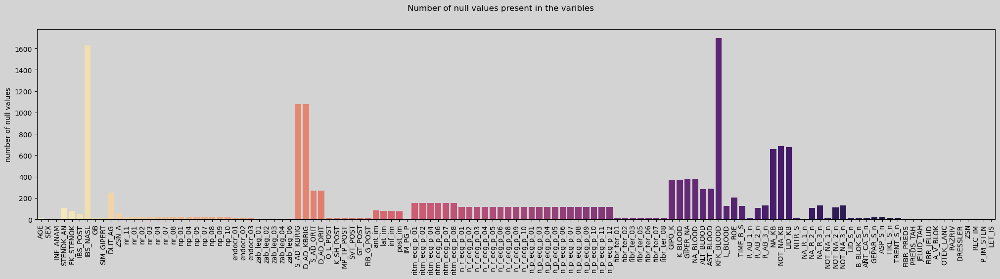

In [7]:
#ploting  how many null values present in the varibles
x=pd.DataFrame(df.isnull().sum()).rename({0:'number of null values'}, axis = 1)
plt.figure(figsize=(25,5),facecolor='lightgrey')
plt.suptitle('Number of null values present in the varibles')
axes=plt.axes()
axes.set_facecolor('lightgrey')
sns.barplot(x=df.columns,y='number of null values',data=x,palette='magma_r',ax=axes)
plt.xticks(rotation=90);

<AxesSubplot:>

<Figure size 2000x1000 with 0 Axes>

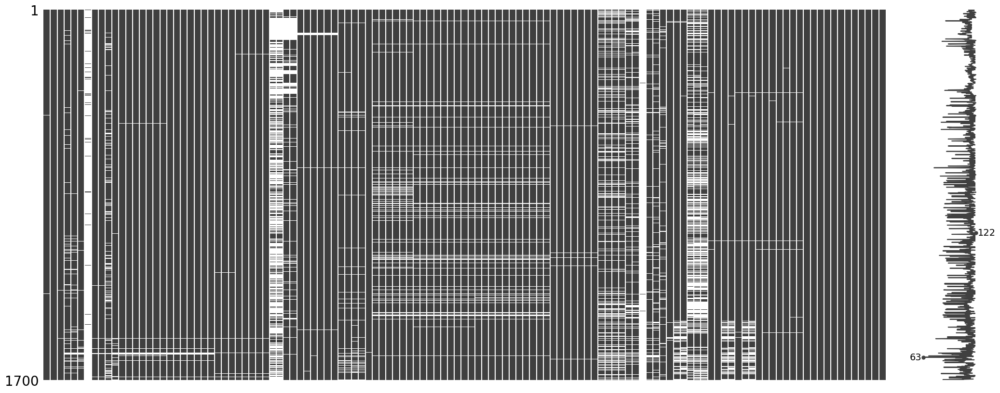

In [8]:
import missingno as msno
plt.figure(figsize=(20,10))
msno.matrix(df)

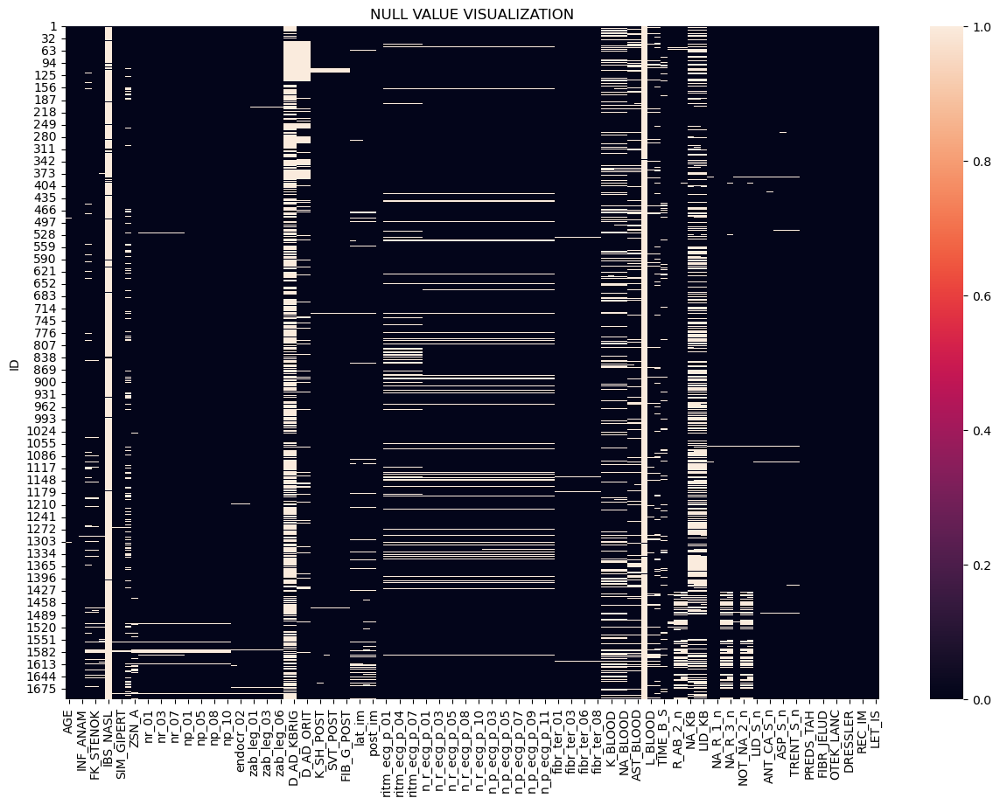

In [9]:
plt.figure(figsize=(15,10))
plt.title('NULL VALUE VISUALIZATION')
sns.heatmap(df.isnull())
plt.show()

In [10]:
pd.DataFrame(df.dtypes).rename({0:'Data type'},axis=1)

,Data type
AGE,float64
SEX,int64
INF_ANAM,float64
STENOK_AN,float64
FK_STENOK,float64
...,...
DRESSLER,int64
ZSN,int64
REC_IM,int64
P_IM_STEN,int64


In [11]:
pd.DataFrame((df.isnull().sum())/len(df)*100).rename({0:'percentage of null values'},axis=1).style.background_gradient('plasma')

,percentage of null values
AGE,0.470588
SEX,0.000000
INF_ANAM,0.235294
STENOK_AN,6.235294
FK_STENOK,4.294118
IBS_POST,3.000000
IBS_NASL,95.764706
GB,0.529412
SIM_GIPERT,0.470588
DLIT_AG,14.588235


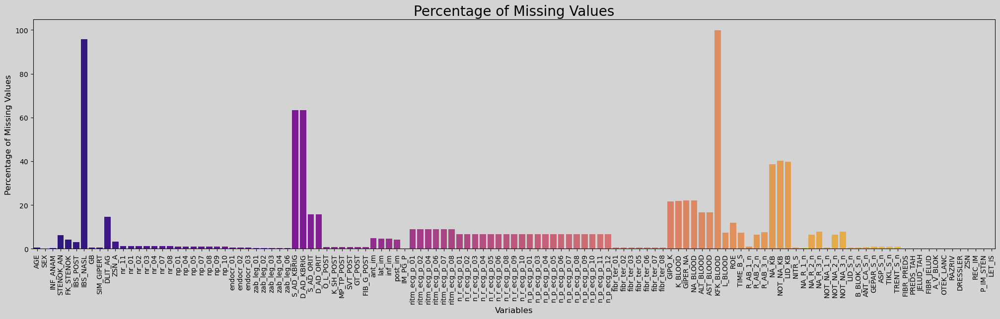

In [12]:
## Set figure size
missing=pd.DataFrame((df.isnull().sum())/len(df)*100).rename({0:'percentage of null values'},axis=1)
plt.figure(figsize=(25, 6),facecolor='lightgrey')
axes=plt.axes()
axes.set_facecolor('lightgrey')
# Create bar plot
ax = sns.barplot(x=df.columns, y='percentage of null values', data=missing, palette='plasma',ax=axes)

# Set title and axis labels
ax.set_title("Percentage of Missing Values", fontsize=20)
ax.set_xlabel("Variables", fontsize=12)
ax.set_ylabel("Percentage of Missing Values", fontsize=12)

# Rotate x-axis labels
plt.xticks(rotation=90)

# Display plot
plt.show()


In [13]:
x=df.isnull().sum()/len(df)
display(x[x>=30].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))


,percentage of null values


In [14]:
#here i am droping some of the variables which are shown above where null values are more then 30%

df=df.drop(['IBS_NASL','S_AD_KBRIG','D_AD_KBRIG','KFK_BLOOD','NA_KB','NOT_NA_KB','LID_KB'],axis=1)

In [15]:
#out of 124 columns 7 columns are droped
df.shape

(1700, 116)

In [16]:
df.describe()

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
count,1692.000000,1700.000000,1696.000000,1594.000000,1627.000000,1649.000000,1691.000000,1692.000000,1452.000000,1646.000000,...,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000,1700.000000
mean,61.856974,0.626471,0.554835,2.316186,1.205286,1.160703,1.393258,0.033688,3.340220,0.194411,...,0.024706,0.041765,0.033529,0.093529,0.031765,0.044118,0.231765,0.093529,0.087059,0.477059
std,11.259936,0.483883,0.836801,2.440586,1.040814,0.801400,1.088803,0.180478,3.098646,0.658722,...,0.155273,0.200110,0.180067,0.291259,0.175425,0.205417,0.422084,0.291259,0.282004,1.381818
min,26.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,54.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,63.000000,1.000000,0.000000,1.000000,2.000000,1.000000,2.000000,0.000000,3.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,70.000000,1.000000,1.000000,5.000000,2.000000,2.000000,2.000000,0.000000,7.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,92.000000,1.000000,3.000000,6.000000,4.000000,2.000000,3.000000,1.000000,7.000000,4.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


In [17]:
display(x[x==0].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))


,percentage of null values
SEX,0.000000
FIBR_PREDS,0.000000
PREDS_TAH,0.000000
JELUD_TAH,0.000000
FIBR_JELUD,0.000000
A_V_BLOK,0.000000
OTEK_LANC,0.000000
RAZRIV,0.000000
DRESSLER,0.000000
ZSN,0.000000


In [18]:
#these are some of the variables which as less then 2%
display(x[x<=2].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))

,percentage of null values
KFK_BLOOD,0.997647
IBS_NASL,0.957647
S_AD_KBRIG,0.632941
D_AD_KBRIG,0.632941
NOT_NA_KB,0.403529
LID_KB,0.398235
NA_KB,0.386471
GIPER_NA,0.220588
NA_BLOOD,0.220588
K_BLOOD,0.218235


In [19]:
#imputing mean value to all the different variables which is mentioned above

df['AGE']=df.AGE.fillna(round(df.AGE.mean()))
df['INF_ANAM']=df.INF_ANAM.fillna(round(df.INF_ANAM.mean()))
df['GB']=df.GB.fillna(round(df.GB.mean()))
df['SIM_GIPERT']=df.SIM_GIPERT.fillna(round(df.SIM_GIPERT.mean()))
df['nr_11']=df.nr_11.fillna(round(df.nr_11.mean()))
df['nr_01']=df.nr_01.fillna(round(df.nr_01.mean()))
df['nr_02']=df.nr_02.fillna(round(df.nr_02.mean()))
df['nr_03']=df.nr_03.fillna(round(df.nr_03.mean()))
df['nr_04']=df.nr_04.fillna(round(df.nr_04.mean()))
df['nr_07']=df.nr_07.fillna(round(df.nr_07.mean()))
df['nr_08']=df.nr_08.fillna(round(df.nr_08.mean()))
df['np_01']=df.np_01.fillna(round(df.np_01.mean()))
df['np_04']=df.np_04.fillna(round(df.np_04.mean()))
df['np_05']=df.np_05.fillna(round(df.np_05.mean()))
df['np_07']=df.np_07.fillna(round(df.np_07.mean()))
df['np_08']=df.np_08.fillna(round(df.np_08.mean()))
df['np_09']=df.np_09.fillna(round(df.np_09.mean()))
df['np_10']=df.np_10.fillna(round(df.np_10.mean()))
df['endocr_01']=df.endocr_01.fillna(round(df.endocr_01.mean()))
df['endocr_02']=df.endocr_02.fillna(round(df.endocr_02.mean()))
df['endocr_03']=df.endocr_03.fillna(round(df.endocr_03.mean()))
df['zab_leg_01']=df.zab_leg_01.fillna(round(df.zab_leg_01.mean()))
df['zab_leg_02']=df.zab_leg_02.fillna(round(df.zab_leg_02.mean()))
df['zab_leg_03']=df.zab_leg_03.fillna(round(df.zab_leg_03.mean()))
df['zab_leg_04']=df.zab_leg_04.fillna(round(df.zab_leg_04.mean()))
df['zab_leg_06']=df.zab_leg_06.fillna(round(df.zab_leg_06.mean()))
df['O_L_POST']=df.O_L_POST.fillna(round(df.O_L_POST.mean()))
df['K_SH_POST']=df.K_SH_POST.fillna(round(df.K_SH_POST.mean()))
df['MP_TP_POST']=df.MP_TP_POST.fillna(round(df.MP_TP_POST.mean()))
df['SVT_POST']=df.SVT_POST.fillna(round(df.SVT_POST.mean()))
df['GT_POST']=df.GT_POST.fillna(round(df.GT_POST.mean()))
df['FIB_G_POST']=df.FIB_G_POST.fillna(round(df.FIB_G_POST.mean()))
df['IM_PG_P']=df.IM_PG_P.fillna(round(df.IM_PG_P.mean()))
df['fibr_ter_01']=df.fibr_ter_01.fillna(round(df.fibr_ter_01.mean()))
df['fibr_ter_02']=df.fibr_ter_02.fillna(round(df.fibr_ter_02.mean()))
df['fibr_ter_03']=df.fibr_ter_03.fillna(round(df.fibr_ter_03.mean()))
df['fibr_ter_05']=df.fibr_ter_05.fillna(round(df.fibr_ter_05.mean()))
df['fibr_ter_06']=df.fibr_ter_06.fillna(round(df.fibr_ter_06.mean()))
df['fibr_ter_07']=df.fibr_ter_07.fillna(round(df.fibr_ter_07.mean()))
df['fibr_ter_08']=df.fibr_ter_08.fillna(round(df.fibr_ter_08.mean()))
df['R_AB_1_n']=df.R_AB_1_n.fillna(round(df.R_AB_1_n.mean()))
df['NITR_S']=df.NITR_S.fillna(round(df.NITR_S.mean()))
df['NA_R_1_n']=df.NA_R_1_n.fillna(round(df.NA_R_1_n.mean()))
df['NOT_NA_1_n']=df.NOT_NA_1_n.fillna(round(df.NOT_NA_1_n.mean()))
df['LID_S_n']=df.LID_S_n.fillna(round(df.LID_S_n.mean()))
df['B_BLOK_S_n']=df.B_BLOK_S_n.fillna(round(df.B_BLOK_S_n.mean()))
df['ANT_CA_S_n']=df.ANT_CA_S_n.fillna(round(df.ANT_CA_S_n.mean()))
df['GEPAR_S_n']=df.GEPAR_S_n.fillna(round(df.GEPAR_S_n.mean()))
df['ASP_S_n']=df.ASP_S_n.fillna(round(df.ASP_S_n.mean()))
df['TIKL_S_n']=df.TIKL_S_n.fillna(round(df.TIKL_S_n.mean()))
df['TRENT_S_n']=df.TRENT_S_n.fillna(round(df.TRENT_S_n.mean()))


In [20]:
#now let me check the variables having null values
y=df.isnull().sum()/len(df)
display(y[y==0].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))


,percentage of null values
AGE,0.000000
SEX,0.000000
fibr_ter_01,0.000000
fibr_ter_02,0.000000
fibr_ter_03,0.000000
fibr_ter_05,0.000000
fibr_ter_06,0.000000
fibr_ter_07,0.000000
fibr_ter_08,0.000000
R_AB_1_n,0.000000


In [21]:
print(f'Number of Variables which as NO Null value {len(y[y==0])}')

Number of Variables which as NO Null value 64


In [22]:
#this are some of the variables  which as null values
display(y[y>0].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))

,percentage of null values
GIPER_NA,0.220588
NA_BLOOD,0.220588
K_BLOOD,0.218235
GIPO_K,0.217059
AST_BLOOD,0.167647
ALT_BLOOD,0.167059
S_AD_ORIT,0.157059
D_AD_ORIT,0.157059
DLIT_AG,0.145882
ROE,0.119412


In [23]:
print(f'Number of Variables which as more the 2% Null value {len(y[y>0])}')

Number of Variables which as more the 2% Null value 52


In [24]:
import plotly.express as px

fig=px.line(df['GIPER_NA'],title="GIPER_NA")
fig.update_xaxes(rangeslider_visible=True)
fig.update_traces(line_color='yellowgreen')
fig.show()

In [25]:
df['GIPER_NA'].unique()


array([ 0., nan,  1.])

In [26]:
pd.value_counts(df['GIPER_NA'])

0.0    1295
1.0      30
Name: GIPER_NA, dtype: int64

In [27]:
def plots(p,t,c):
    plt.figure(figsize=(15,15),facecolor='lightgrey')
    axes=plt.axes()
    axes.set_facecolor('Lightgrey')
    plt.subplot(3,1,1)
    p.plot(title=t, marker="o",c=c)
    plt.subplot(3,1,2)
    p.plot(kind='hist')
    plt.subplot(3,1,3)
    sns.scatterplot(x=df.index,y=p)

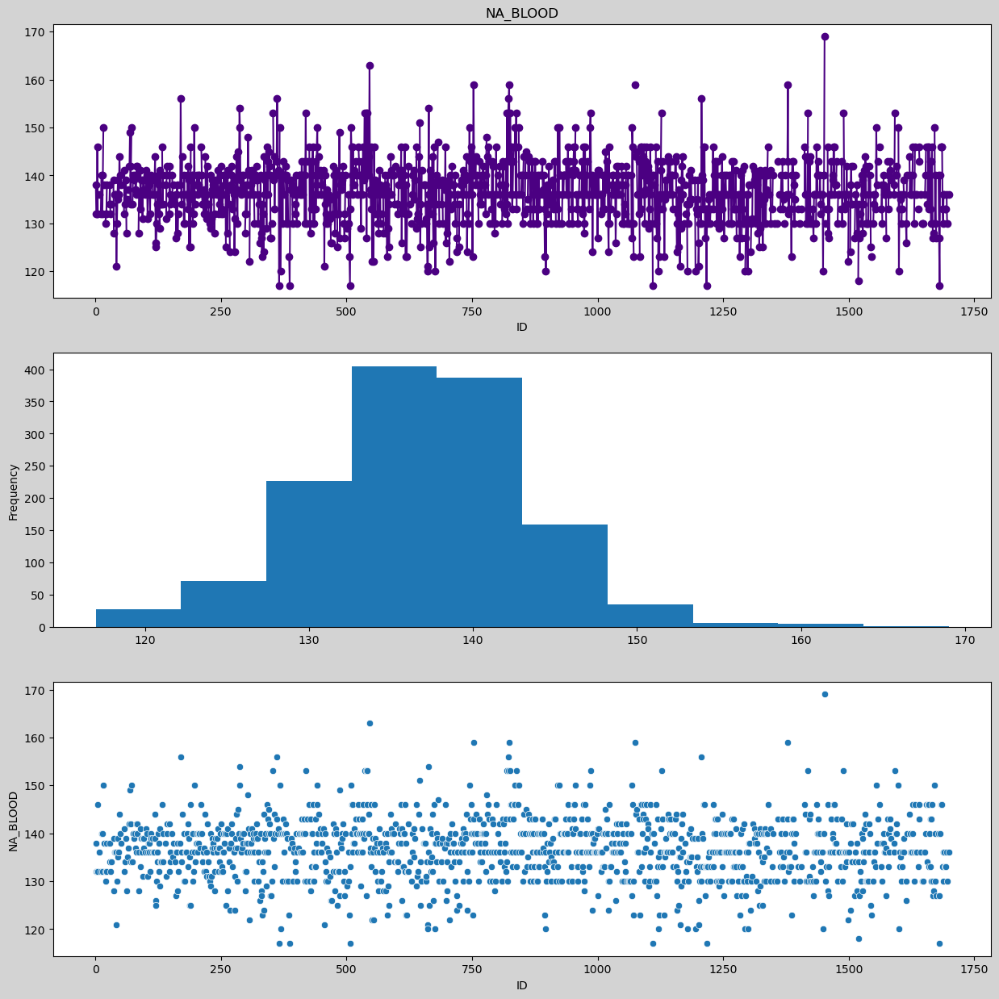

In [28]:
plots(df['NA_BLOOD'],'NA_BLOOD','indigo')

looking through the above plot i didn't find the constant values so for this feature i am going to imput the values by using other techniques

In [29]:
#let me check the data indept 
fig=px.line(df['NA_BLOOD'],title="NA_BLOOD")
fig.update_xaxes(rangeslider_visible=True)
fig.update_traces(line_color='yellowgreen')
fig.show()

In [30]:
def plots(p,t,c):
    plt.figure(figsize=(15,10),facecolor='lightgrey')
    axes=plt.axes()
    axes.set_facecolor('Lightgrey')
    plt.subplot(3,1,1)
    p.plot(title=t, marker="o",c=c)
    plt.subplot(3,1,2)
    p.plot(kind='hist')
    plt.subplot(3,1,3)
    sns.scatterplot(x=df.index,y=p)
    print(p.describe())
    print(pd.value_counts(p))
    

count    1329.000000
mean        4.191422
std         0.754076
min         2.300000
25%         3.700000
50%         4.100000
75%         4.600000
max         8.200000
Name: K_BLOOD, dtype: float64
4.0    101
3.8     91
4.2     87
3.9     79
3.5     71
4.5     62
4.1     62
4.3     60
3.6     58
4.7     57
3.7     57
4.4     55
4.6     52
4.8     43
4.9     39
3.4     38
5.0     36
3.3     34
3.2     30
3.1     30
5.1     23
3.0     23
5.5     16
5.3     15
5.7     14
5.2     14
5.4     10
6.0      9
5.6      8
2.9      7
6.1      6
5.9      4
2.7      4
6.2      4
2.3      4
2.8      4
2.4      3
6.8      2
5.8      2
6.7      2
6.9      2
6.4      2
8.2      1
7.8      1
7.2      1
2.5      1
8.0      1
7.7      1
7.3      1
6.3      1
7.6      1
Name: K_BLOOD, dtype: int64


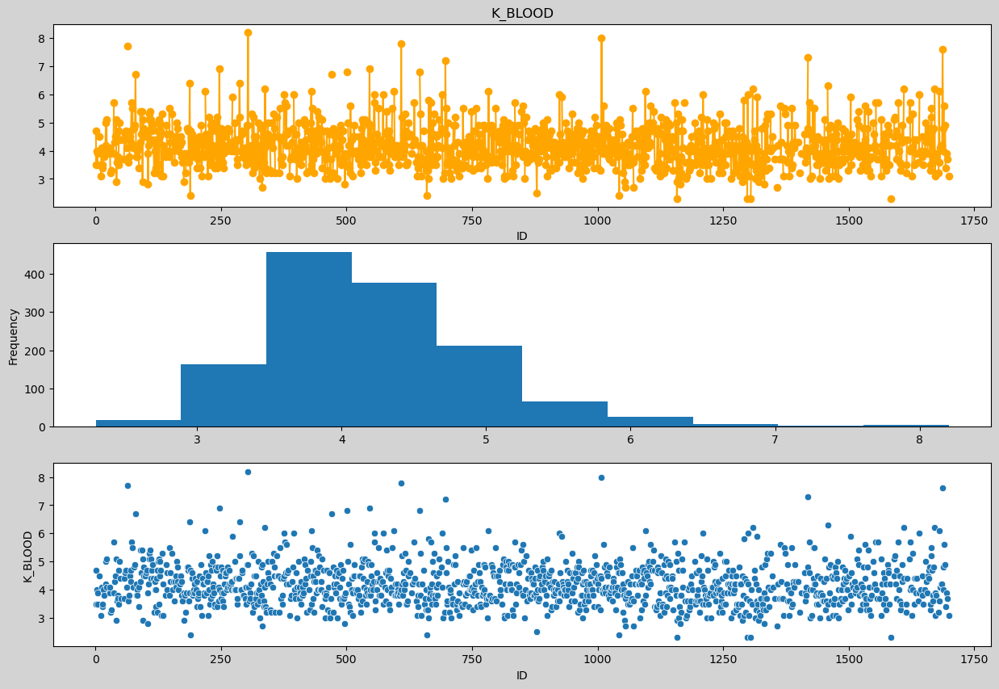

In [31]:
plots(df.K_BLOOD,'K_BLOOD','orange')

In [32]:
df.K_BLOOD.describe()

count    1329.000000
mean        4.191422
std         0.754076
min         2.300000
25%         3.700000
50%         4.100000
75%         4.600000
max         8.200000
Name: K_BLOOD, dtype: float64

In [33]:
pd.value_counts(df.K_BLOOD)

4.0    101
3.8     91
4.2     87
3.9     79
3.5     71
4.5     62
4.1     62
4.3     60
3.6     58
4.7     57
3.7     57
4.4     55
4.6     52
4.8     43
4.9     39
3.4     38
5.0     36
3.3     34
3.2     30
3.1     30
5.1     23
3.0     23
5.5     16
5.3     15
5.7     14
5.2     14
5.4     10
6.0      9
5.6      8
2.9      7
6.1      6
5.9      4
2.7      4
6.2      4
2.3      4
2.8      4
2.4      3
6.8      2
5.8      2
6.7      2
6.9      2
6.4      2
8.2      1
7.8      1
7.2      1
2.5      1
8.0      1
7.7      1
7.3      1
6.3      1
7.6      1
Name: K_BLOOD, dtype: int64

count    1331.000000
mean        0.401202
std         0.490326
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         1.000000
Name: GIPO_K, dtype: float64
0.0    797
1.0    534
Name: GIPO_K, dtype: int64


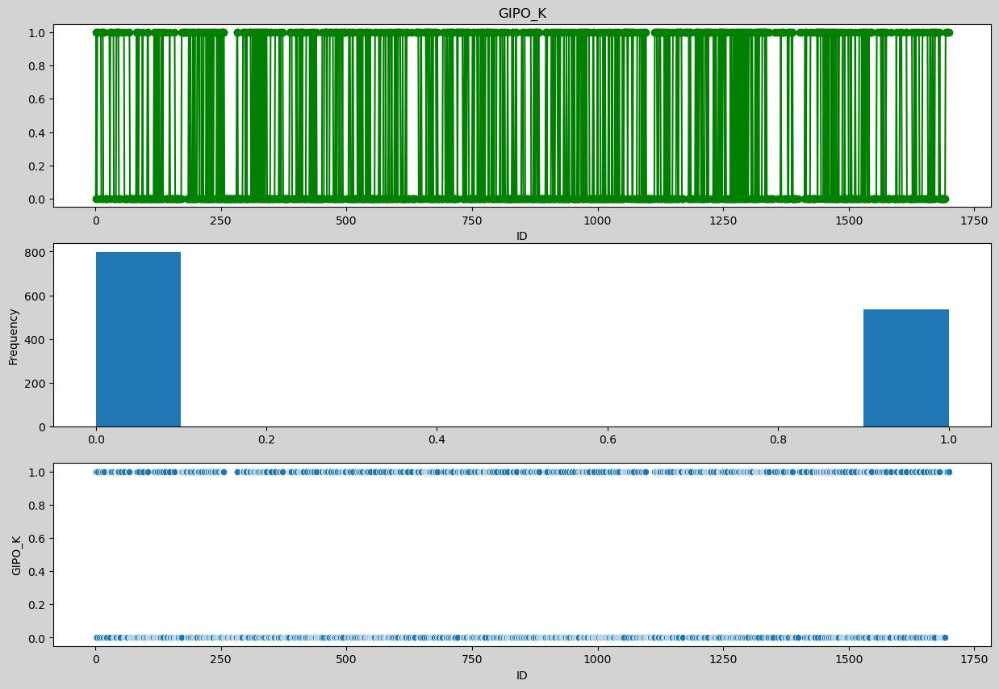

In [34]:
plots(df.GIPO_K,'GIPO_K','green')

count    1415.000000
mean        0.263717
std         0.201802
min         0.040000
25%         0.150000
50%         0.220000
75%         0.330000
max         2.150000
Name: AST_BLOOD, dtype: float64
0.15    271
0.22    169
0.07    149
0.30    145
0.11    113
0.18    108
0.37     81
0.45     62
0.26     55
0.52     33
0.33     32
0.75     26
0.60     20
0.04     17
0.41     17
0.23     10
0.67     10
0.56      8
0.48      8
0.90      7
0.14      5
0.40      5
0.44      5
0.36      4
0.08      4
0.38      3
0.96      3
1.04      3
0.86      3
1.34      3
0.20      3
1.05      2
0.70      2
0.82      2
1.12      2
0.63      2
0.10      2
0.97      1
1.75      1
0.71      1
1.36      1
0.98      1
0.68      1
0.28      1
1.08      1
0.13      1
0.74      1
0.46      1
0.80      1
0.27      1
2.15      1
1.13      1
0.66      1
0.57      1
0.12      1
1.20      1
0.50      1
0.49      1
Name: AST_BLOOD, dtype: int64


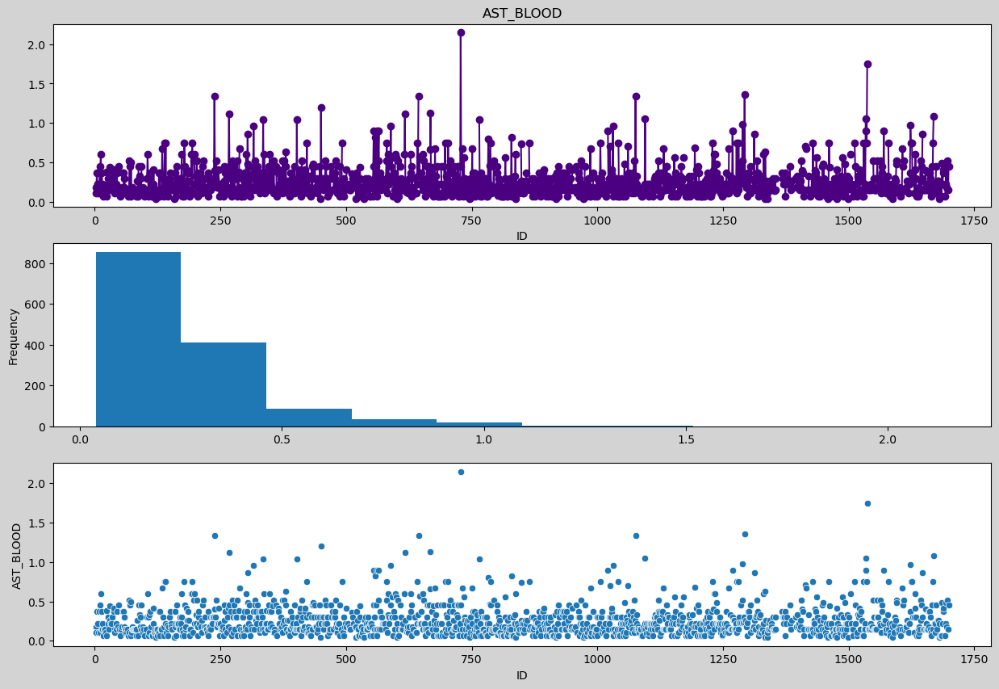

In [35]:
plots(df.AST_BLOOD,'AST_BLOOD','indigo')

count    1416.000000
mean        0.481455
std         0.387261
min         0.030000
25%         0.230000
50%         0.380000
75%         0.610000
max         3.000000
Name: ALT_BLOOD, dtype: float64
0.15    230
0.30    210
0.45    178
0.23    144
0.38    126
       ... 
1.04      1
0.72      1
1.57      1
2.86      1
0.95      1
Name: ALT_BLOOD, Length: 69, dtype: int64


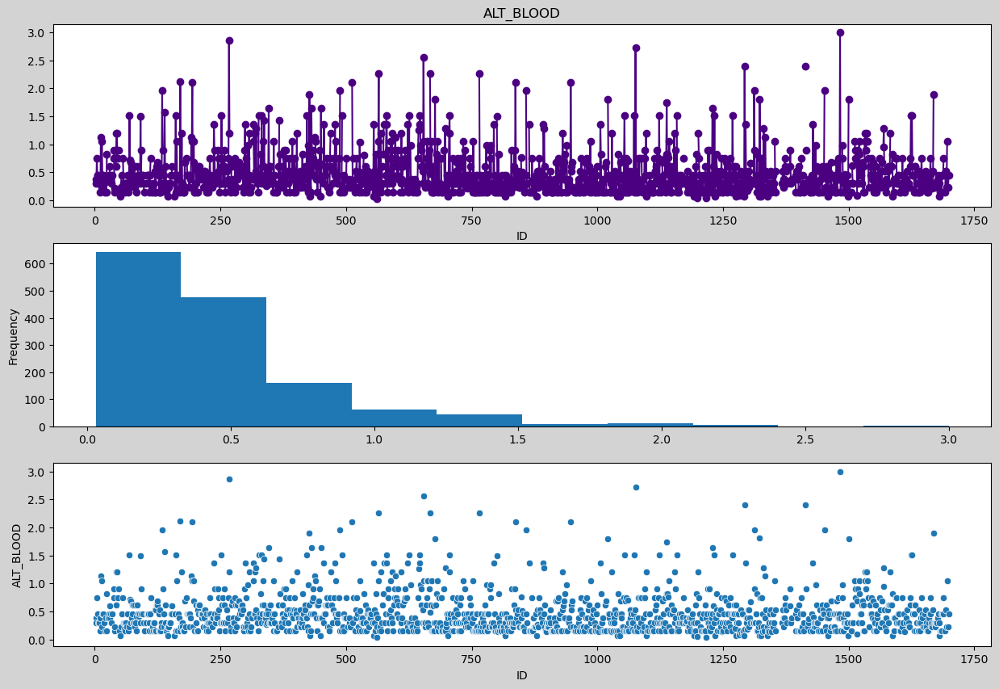

In [36]:
plots(df.ALT_BLOOD,'ALT_BLOOD','indigo')

count    1433.000000
mean      134.588276
std        31.348388
min         0.000000
25%       120.000000
50%       130.000000
75%       150.000000
max       260.000000
Name: S_AD_ORIT, dtype: float64
130.0    242
120.0    220
140.0    218
160.0    154
110.0    123
150.0     96
180.0     68
100.0     55
170.0     54
90.0      33
200.0     28
190.0     25
80.0      24
60.0      21
70.0      12
220.0      8
0.0        8
115.0      7
210.0      6
105.0      4
40.0       4
125.0      4
145.0      3
135.0      3
50.0       3
230.0      2
95.0       2
240.0      2
260.0      1
155.0      1
195.0      1
20.0       1
Name: S_AD_ORIT, dtype: int64


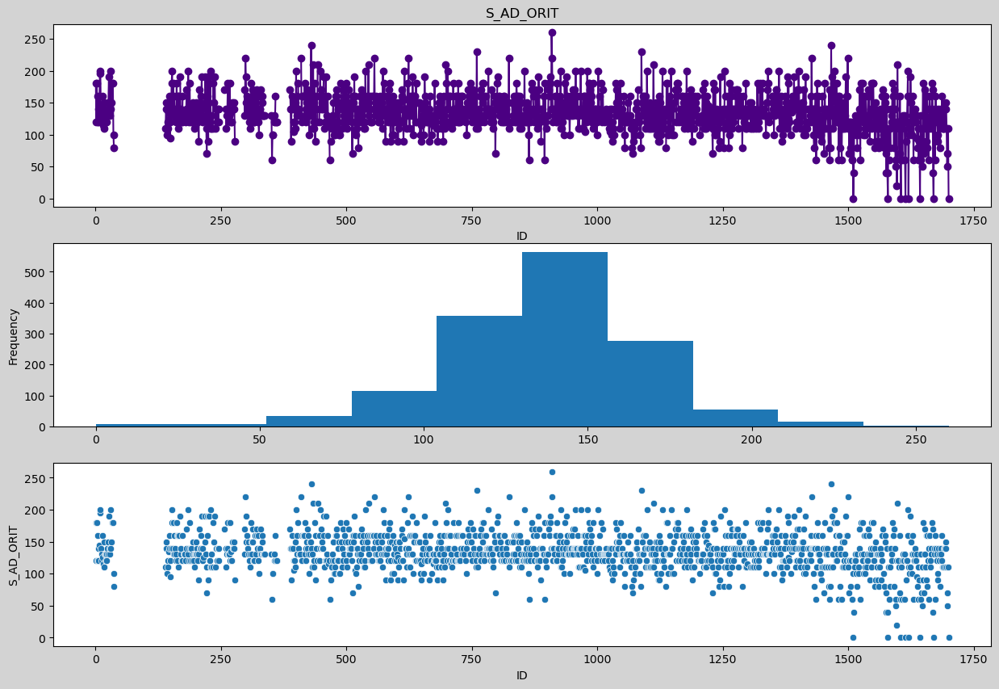

In [37]:
plots(df.S_AD_ORIT,'S_AD_ORIT','indigo')

count    1433.000000
mean       82.749477
std        18.321063
min         0.000000
25%        80.000000
50%        80.000000
75%        90.000000
max       190.000000
Name: D_AD_ORIT, dtype: float64
80.0     502
90.0     302
100.0    201
70.0     166
60.0      84
110.0     59
40.0      28
120.0     23
0.0       18
50.0      16
130.0      8
95.0       6
85.0       4
140.0      4
20.0       4
75.0       3
105.0      2
190.0      1
65.0       1
30.0       1
Name: D_AD_ORIT, dtype: int64


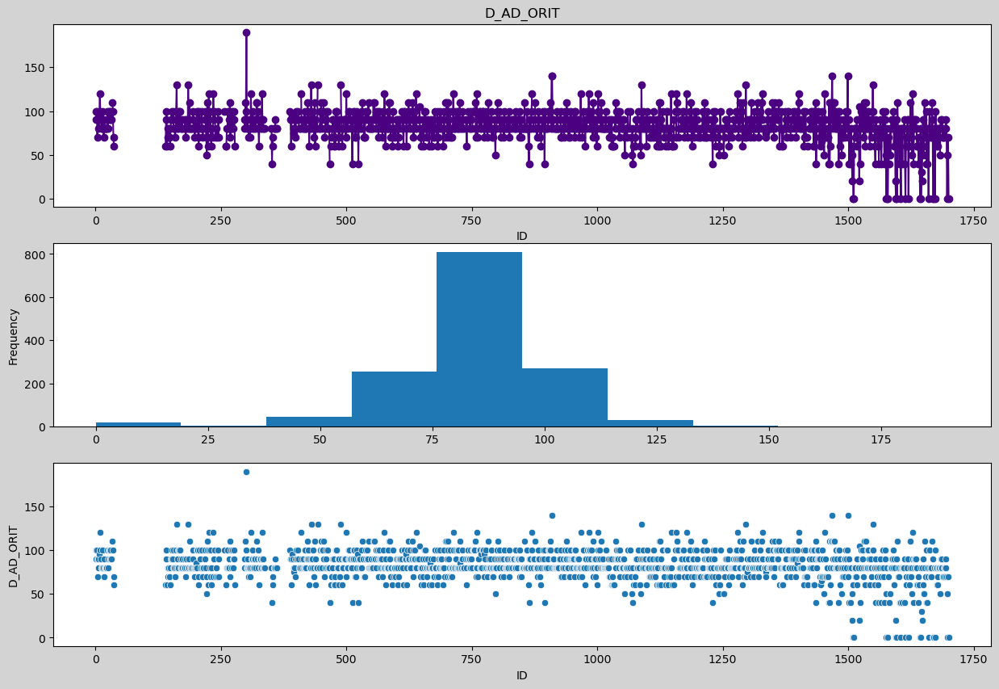

In [38]:
plots(df.D_AD_ORIT,'D_AD_ORIT','indigo')

count    1452.000000
mean        3.340220
std         3.098646
min         0.000000
25%         0.000000
50%         3.000000
75%         7.000000
max         7.000000
Name: DLIT_AG, dtype: float64
0.0    551
7.0    432
6.0    165
1.0     93
5.0     73
2.0     58
3.0     58
4.0     22
Name: DLIT_AG, dtype: int64


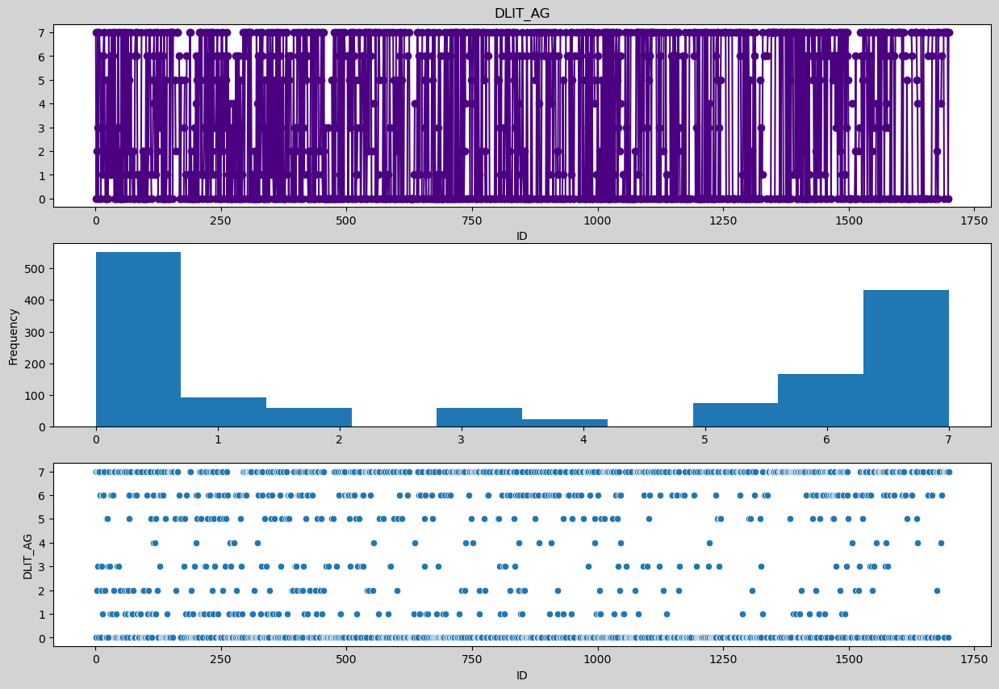

In [39]:
plots(df.DLIT_AG,'DLIT_AG','indigo')

count    1497.000000
mean       13.444890
std        11.296316
min         1.000000
25%         5.000000
50%        10.000000
75%        18.000000
max       140.000000
Name: ROE, dtype: float64
5.0      134
3.0      126
10.0     104
4.0       98
7.0       91
8.0       83
6.0       79
12.0      64
15.0      63
9.0       52
20.0      52
2.0       42
11.0      42
14.0      37
25.0      36
13.0      30
17.0      29
16.0      25
22.0      24
18.0      24
30.0      21
23.0      21
21.0      20
19.0      19
27.0      15
35.0      14
28.0      14
32.0      14
24.0      13
26.0      12
40.0      10
34.0      10
42.0       9
45.0       7
38.0       7
33.0       6
31.0       5
50.0       5
37.0       5
41.0       4
36.0       3
48.0       3
39.0       3
53.0       2
44.0       2
57.0       2
46.0       2
51.0       2
55.0       2
29.0       2
140.0      1
65.0       1
68.0       1
59.0       1
61.0       1
1.0        1
47.0       1
60.0       1
Name: ROE, dtype: int64


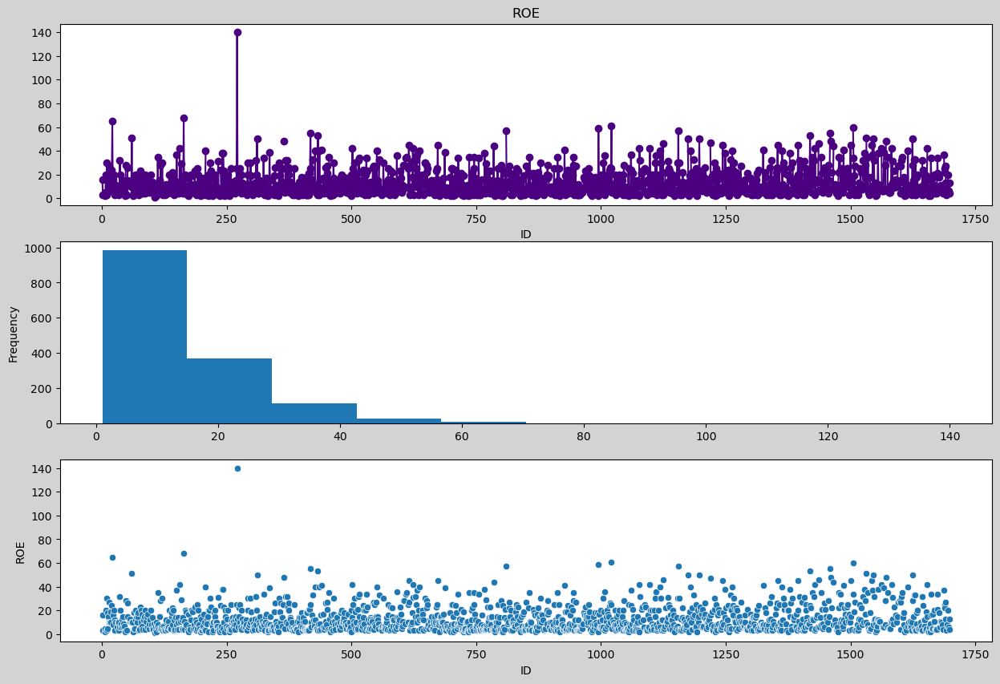

In [40]:
plots(df.ROE,'ROE','indigo')

count    1548.000000
mean        0.000646
std         0.025416
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ritm_ecg_p_06, dtype: float64
0.0    1547
1.0       1
Name: ritm_ecg_p_06, dtype: int64


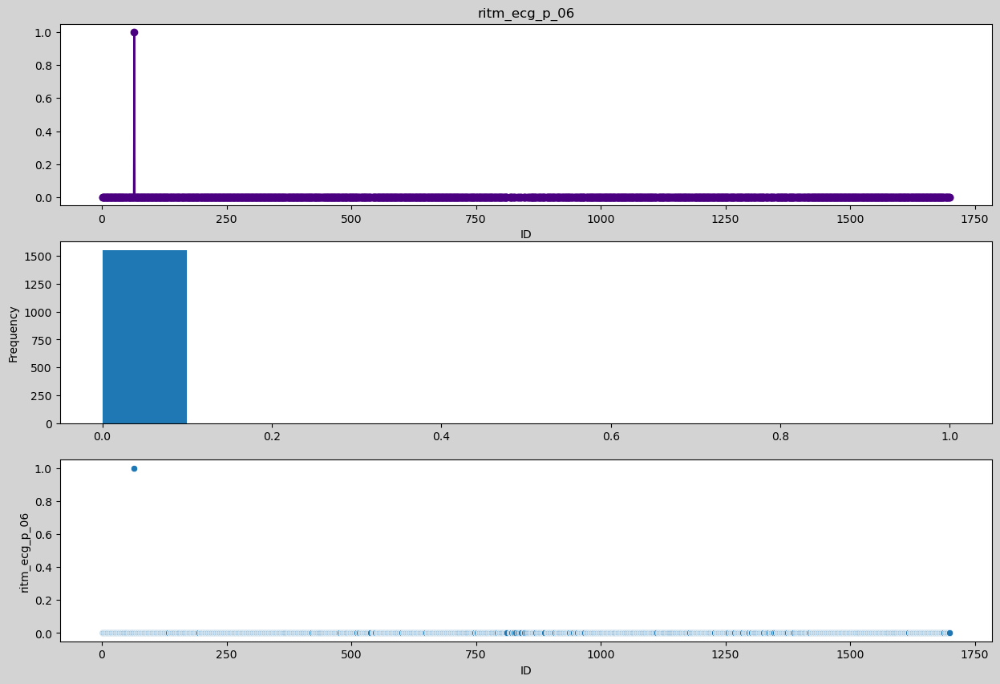

In [41]:
plots(df.ritm_ecg_p_06,'ritm_ecg_p_06','indigo')

In [42]:
#here i am imputing the mean value or i will apply maximum occurance value
df['ritm_ecg_p_06']=df['ritm_ecg_p_06'].fillna(round(df.ritm_ecg_p_06.mean()))

count    1548.000000
mean        0.029716
std         0.169857
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ritm_ecg_p_08, dtype: float64
0.0    1502
1.0      46
Name: ritm_ecg_p_08, dtype: int64


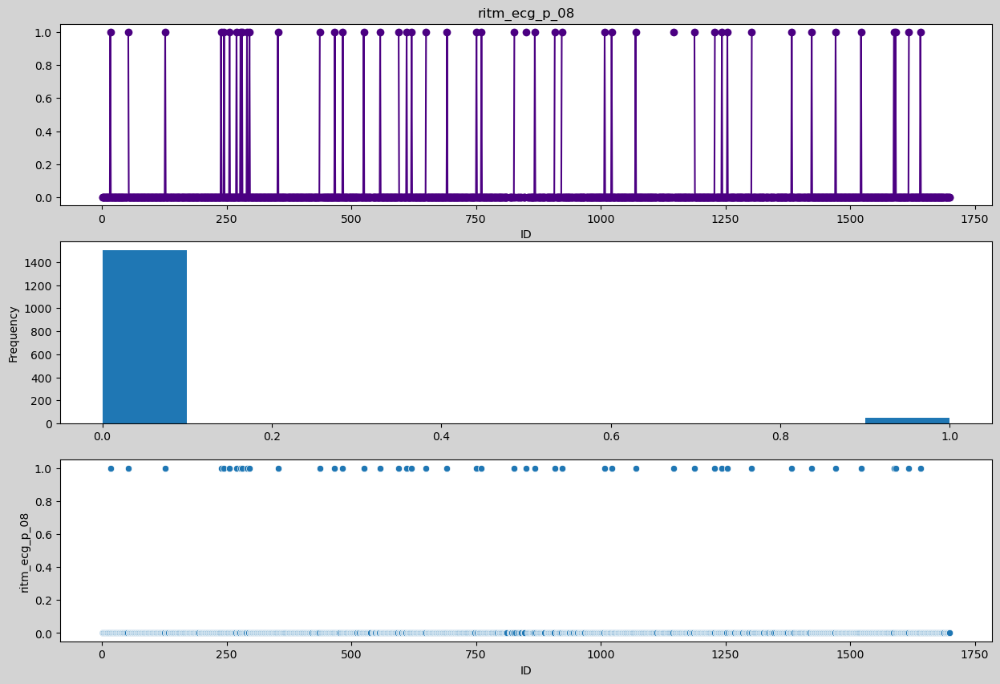

In [43]:
plots(df.ritm_ecg_p_08,'ritm_ecg_p_08','indigo')

In [44]:
df['ritm_ecg_p_08']=df['ritm_ecg_p_08'].fillna(round(df.ritm_ecg_p_08.mean()))

count    1548.000000
mean        0.664729
std         0.472238
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         1.000000
Name: ritm_ecg_p_01, dtype: float64
1.0    1029
0.0     519
Name: ritm_ecg_p_01, dtype: int64


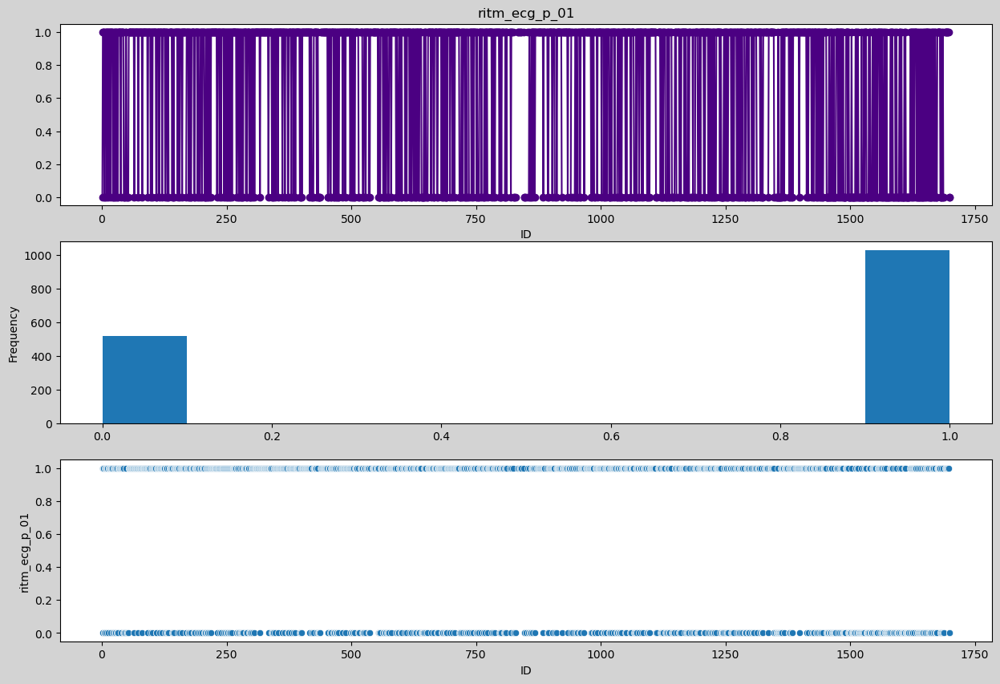

In [45]:
plots(df.ritm_ecg_p_01,'ritm_ecg_p_01','indigo')

In [46]:
df['ritm_ecg_p_01']=df['ritm_ecg_p_01'].fillna(round(df.ritm_ecg_p_01.mean()))

count    1548.000000
mean        0.061370
std         0.240084
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ritm_ecg_p_02, dtype: float64
0.0    1453
1.0      95
Name: ritm_ecg_p_02, dtype: int64


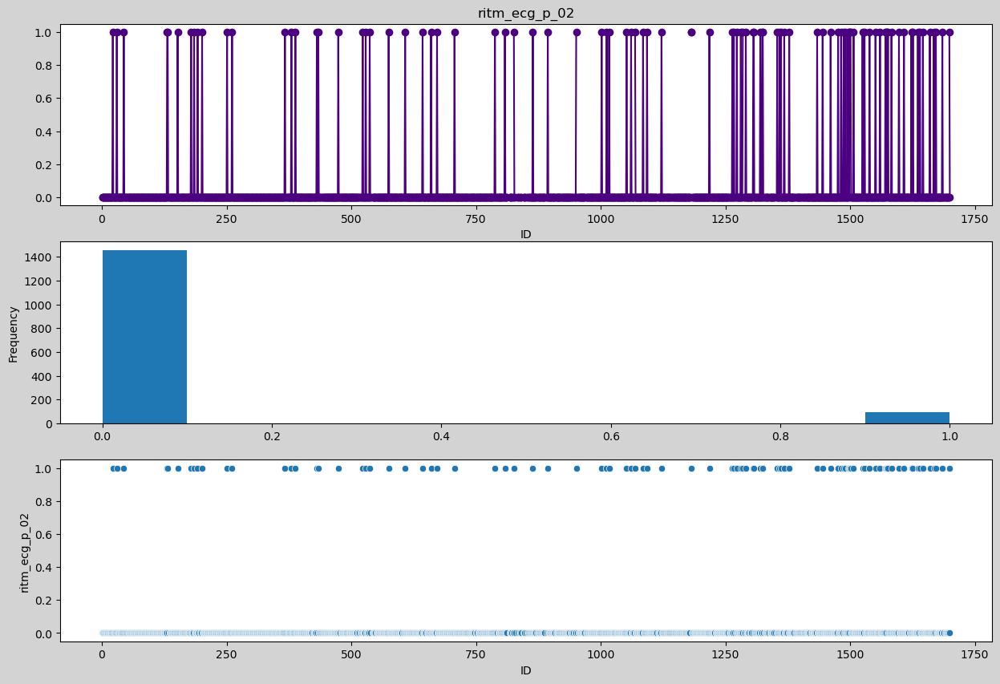

In [47]:
plots(df.ritm_ecg_p_02,'ritm_ecg_p_02','indigo')

In [48]:
df['ritm_ecg_p_02']=df['ritm_ecg_p_02'].fillna(round(df.ritm_ecg_p_02.mean()))

count    1548.000000
mean        0.014858
std         0.121023
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ritm_ecg_p_04, dtype: float64
0.0    1525
1.0      23
Name: ritm_ecg_p_04, dtype: int64


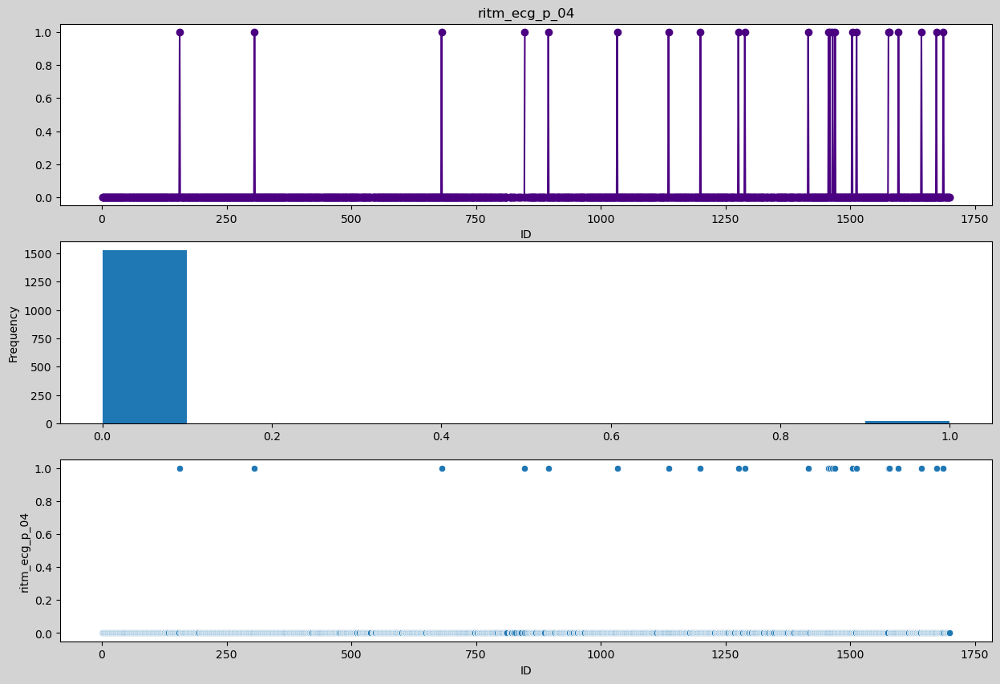

In [49]:
plots(df.ritm_ecg_p_04,'ritm_ecg_p_04','indigo')

In [50]:
df['ritm_ecg_p_04']=df['ritm_ecg_p_04'].fillna(round(df.ritm_ecg_p_04.mean()))

count    1548.000000
mean        0.228036
std         0.419702
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: ritm_ecg_p_07, dtype: float64
0.0    1195
1.0     353
Name: ritm_ecg_p_07, dtype: int64


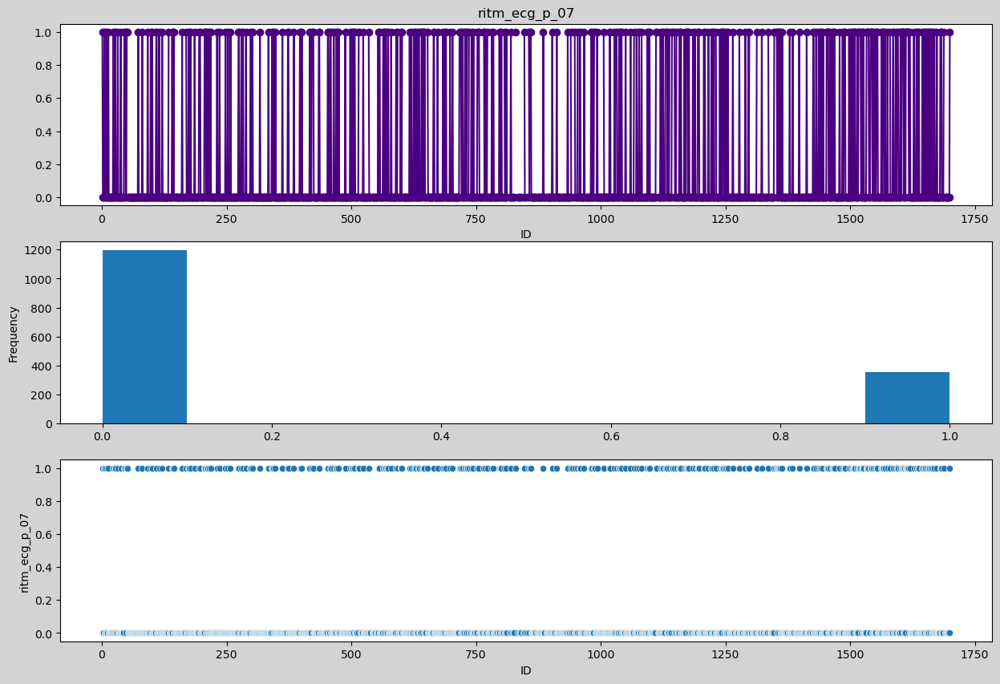

In [51]:
plots(df.ritm_ecg_p_07,'ritm_ecg_p_07','indigo')

In [52]:
df['ritm_ecg_p_07']=df['ritm_ecg_p_07'].fillna(round(df.ritm_ecg_p_07.mean()))

count    1569.000000
mean        0.084767
std         0.355107
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: NOT_NA_3_n, dtype: float64
0.0    1474
1.0      57
2.0      38
Name: NOT_NA_3_n, dtype: int64


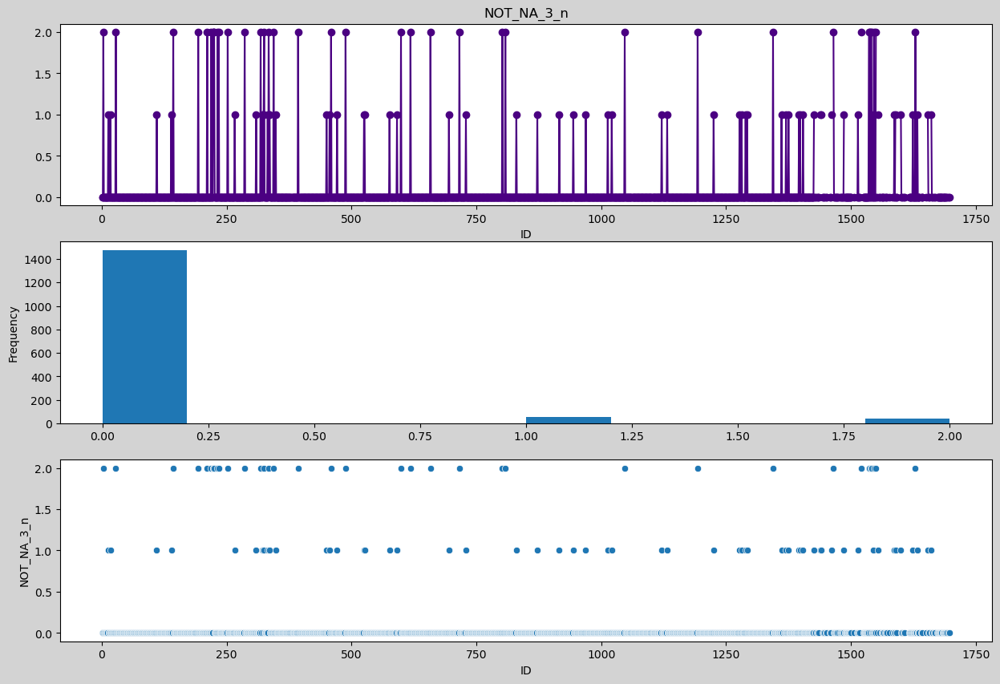

In [53]:
plots(df.NOT_NA_3_n,'NOT_NA_3_n','indigo')

In [54]:
df['NOT_NA_3_n']=df['NOT_NA_3_n'].fillna(round(df.NOT_NA_3_n.mean()))

count    1569.000000
mean        0.058636
std         0.275030
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         2.000000
Name: NA_R_3_n, dtype: float64
0.0    1493
1.0      60
2.0      16
Name: NA_R_3_n, dtype: int64


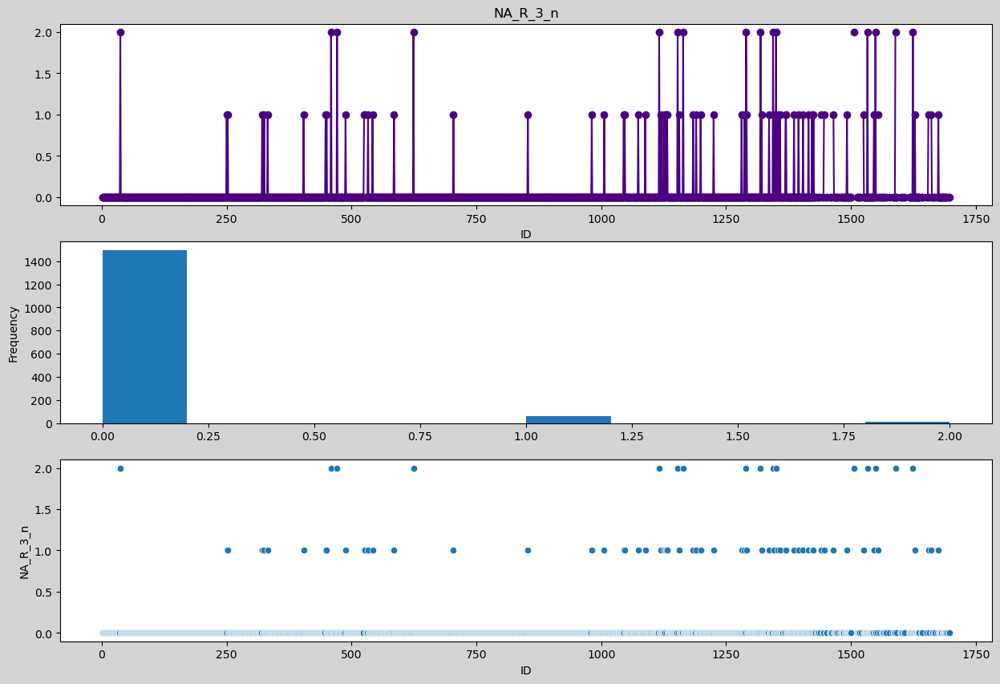

In [55]:
plots(df.NA_R_3_n,'NA_R_3_n','indigo')

In [56]:
df['NA_R_3_n']=df['NA_R_3_n'].fillna(round(df.NA_R_3_n.mean()))

count    1572.000000
mean        0.077608
std         0.313632
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         3.000000
Name: R_AB_3_n, dtype: float64
0.0    1469
1.0      86
2.0      15
3.0       2
Name: R_AB_3_n, dtype: int64


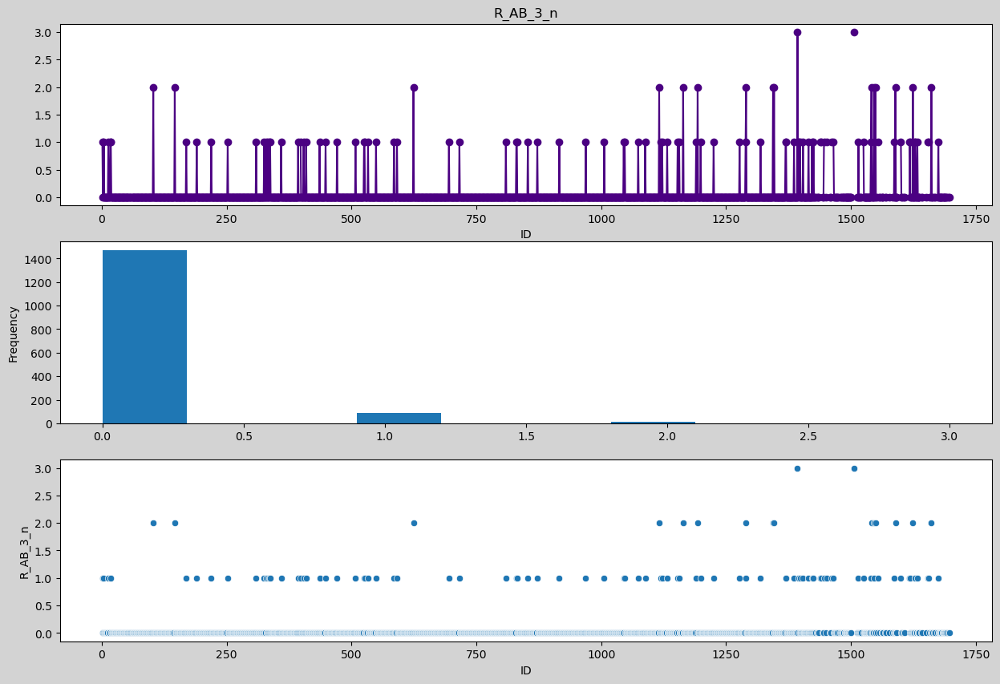

In [57]:
plots(df.R_AB_3_n,'R_AB_3_n','indigo')

In [58]:
df['R_AB_3_n']=df['R_AB_3_n'].fillna(round(df.R_AB_3_n.mean()))

count    1574.000000
mean        4.684244
std         2.871044
min         1.000000
25%         2.000000
50%         4.000000
75%         7.000000
max         9.000000
Name: TIME_B_S, dtype: float64
2.0    360
9.0    269
1.0    198
3.0    175
6.0    151
7.0    141
8.0    101
5.0     92
4.0     87
Name: TIME_B_S, dtype: int64


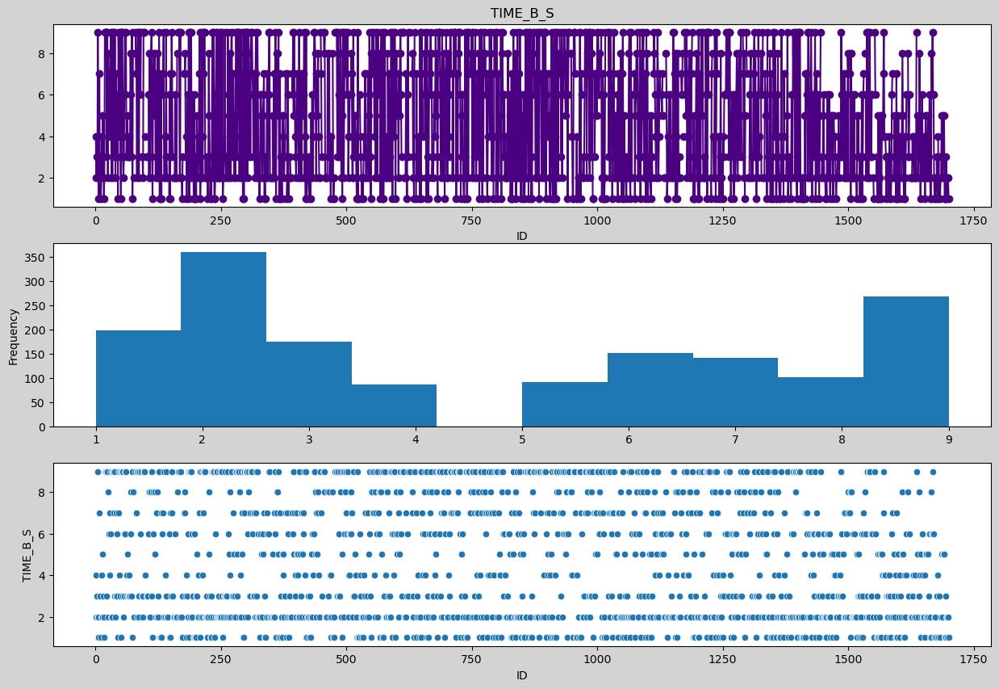

In [59]:
plots(df.TIME_B_S,'TIME_B_S','indigo')

count    1575.000000
mean        8.782914
std         3.400557
min         2.000000
25%         6.400000
50%         8.000000
75%        10.450000
max        27.900000
Name: L_BLOOD, dtype: float64
6.9     32
8.0     30
7.0     30
6.8     29
7.4     29
        ..
23.5     1
2.0      1
3.7      1
2.9      1
23.1     1
Name: L_BLOOD, Length: 174, dtype: int64


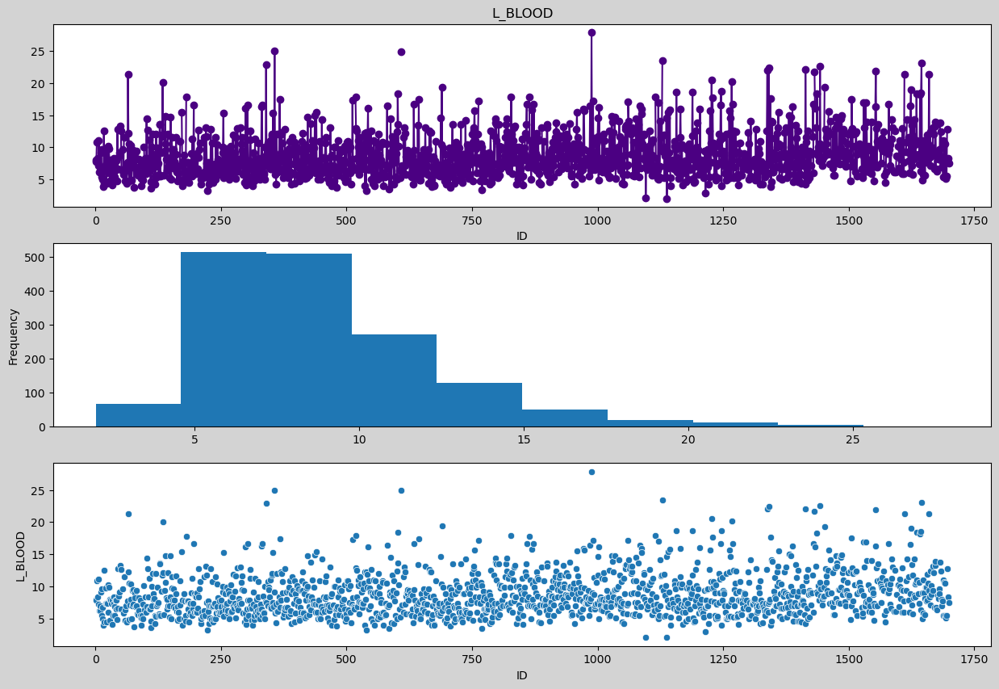

In [60]:
plots(df.L_BLOOD,'L_BLOOD','indigo')

count    1585.000000
mean        0.001262
std         0.035511
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_05, dtype: float64
0.0    1583
1.0       2
Name: n_p_ecg_p_05, dtype: int64


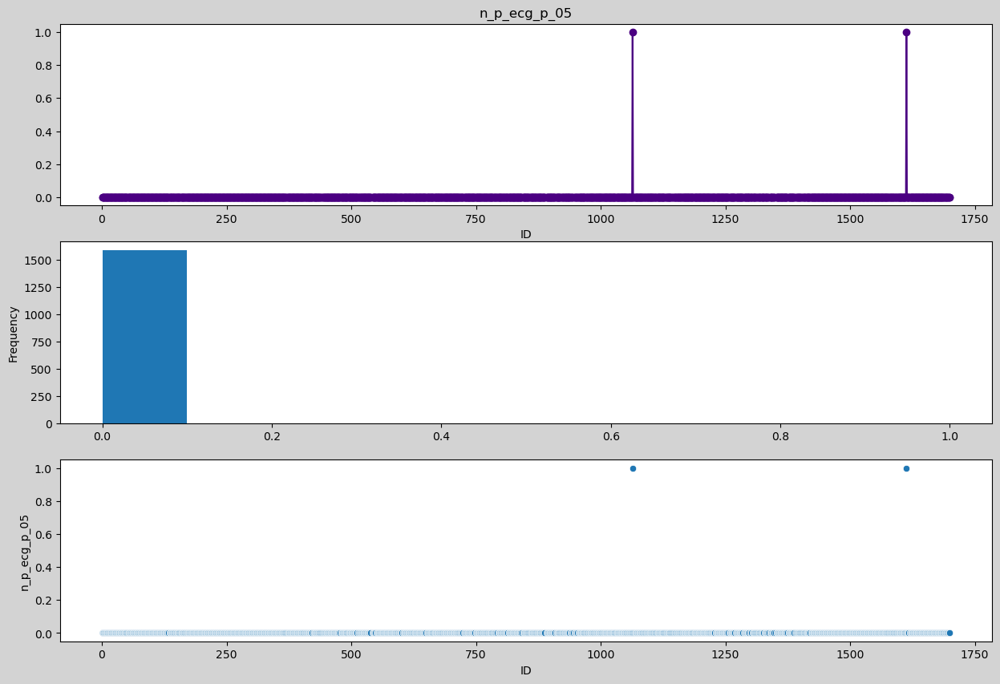

In [61]:
plots(df.n_p_ecg_p_05,'n_p_ecg_p_05','indigo')

In [62]:
df['n_p_ecg_p_05']=df['n_p_ecg_p_05'].fillna(round(df.n_p_ecg_p_05.mean()))

count    1585.000000
mean        0.049211
std         0.216377
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_12, dtype: float64
0.0    1507
1.0      78
Name: n_p_ecg_p_12, dtype: int64


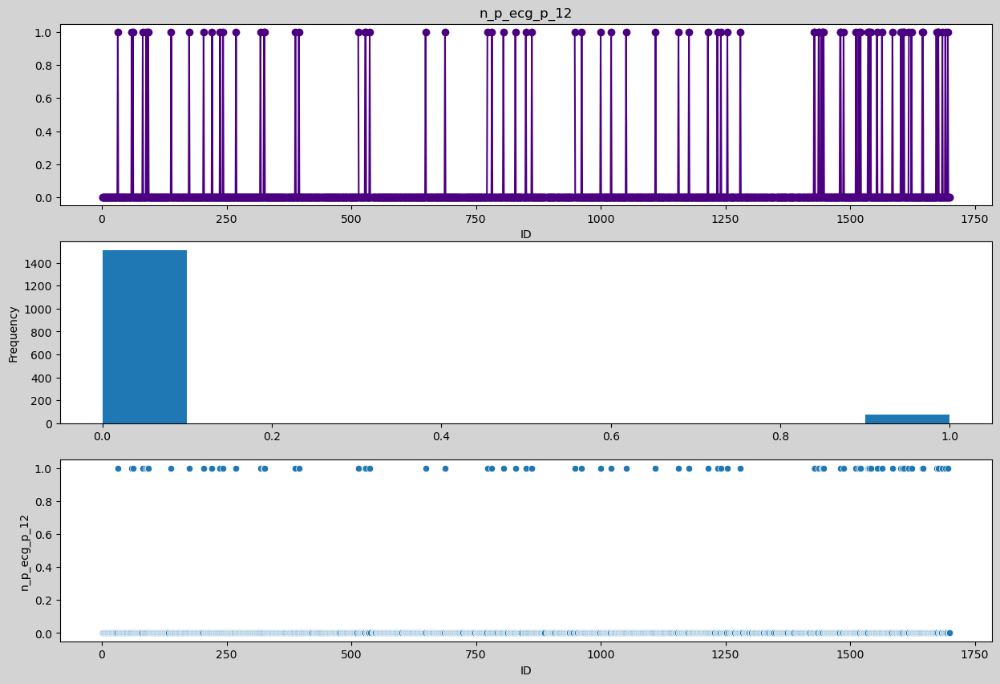

In [63]:
plots(df.n_p_ecg_p_12,'n_p_ecg_p_12','indigo')

In [64]:
df['n_p_ecg_p_12']=df['n_p_ecg_p_12'].fillna(round(df.n_p_ecg_p_12.mean()))

count    1585.000000
mean        0.017666
std         0.131774
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_11, dtype: float64
0.0    1557
1.0      28
Name: n_p_ecg_p_11, dtype: int64


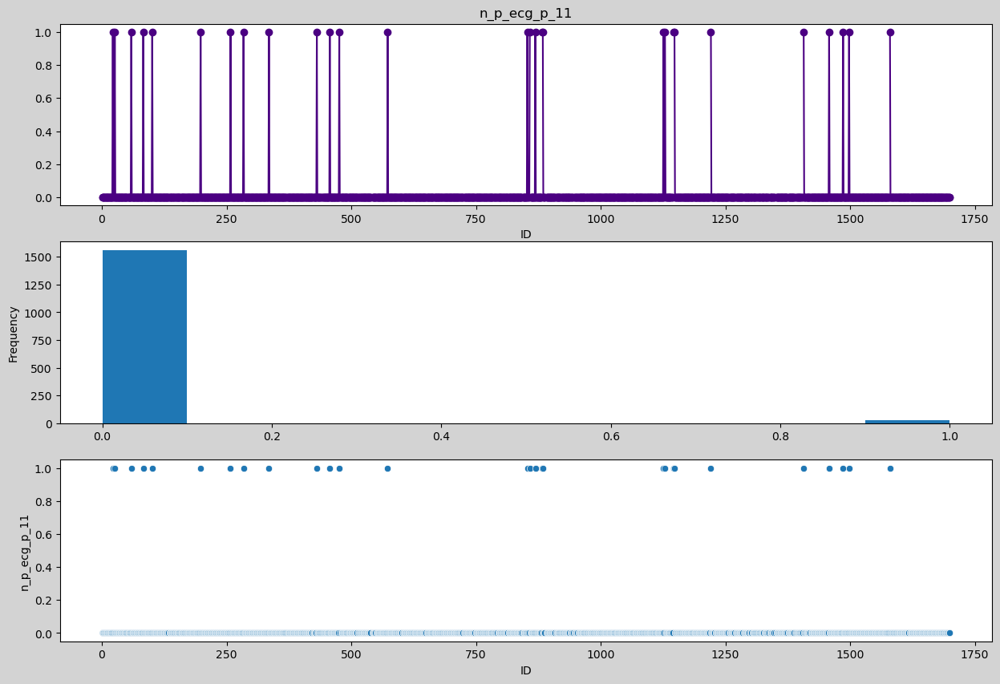

In [65]:
plots(df.n_p_ecg_p_11,'n_p_ecg_p_11','indigo')

In [66]:
df['n_p_ecg_p_11']=df['n_p_ecg_p_11'].fillna(round(df.n_p_ecg_p_11.mean()))

count    1585.000000
mean        0.021451
std         0.144928
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_10, dtype: float64
0.0    1551
1.0      34
Name: n_p_ecg_p_10, dtype: int64


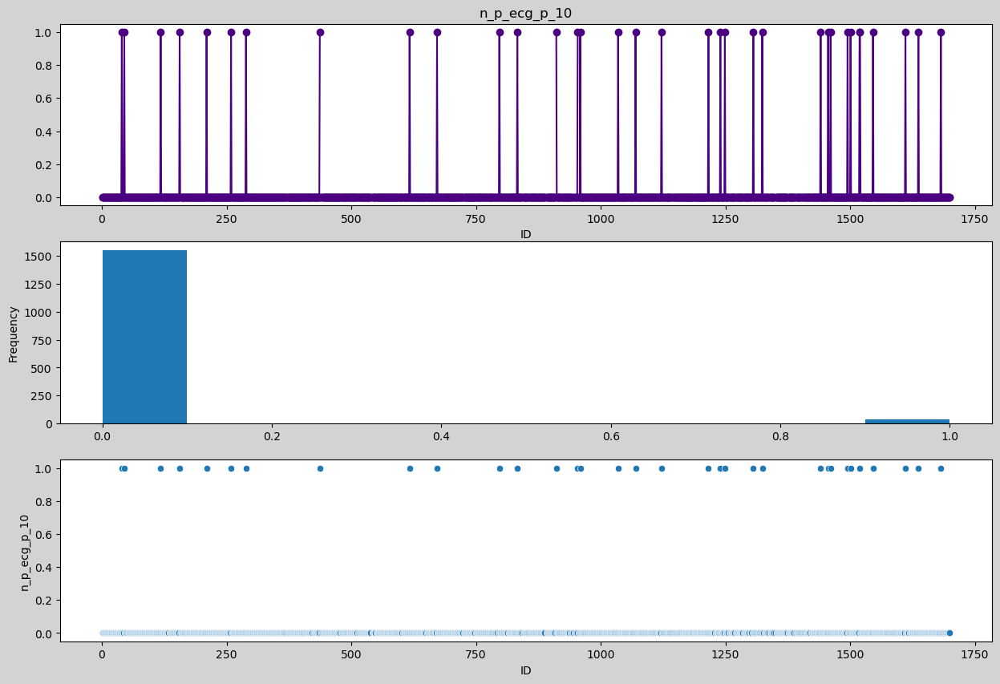

In [67]:
plots(df.n_p_ecg_p_10,'n_p_ecg_p_10','indigo')

In [68]:
df['n_p_ecg_p_10']=df['n_p_ecg_p_10'].fillna(round(df.n_p_ecg_p_10.mean()))

count    1585.000000
mean        0.006309
std         0.079204
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_09, dtype: float64
0.0    1575
1.0      10
Name: n_p_ecg_p_09, dtype: int64


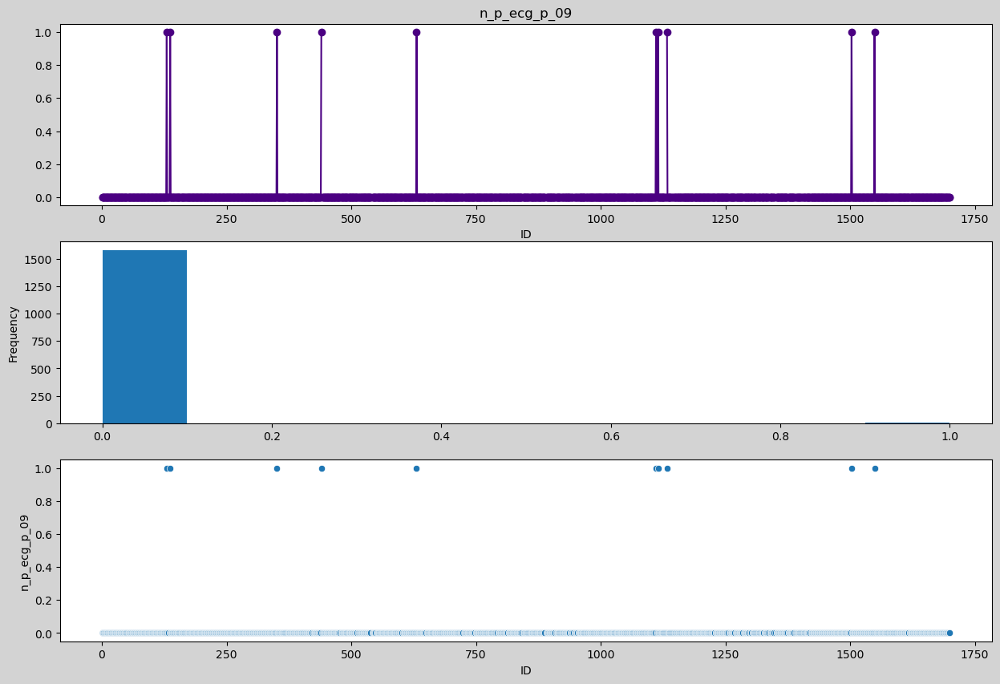

In [69]:
plots(df.n_p_ecg_p_09,'n_p_ecg_p_09','indigo')

In [70]:
df['n_p_ecg_p_09']=df['n_p_ecg_p_09'].fillna(round(df.n_p_ecg_p_09.mean()))

count    1585.000000
mean        0.004416
std         0.066330
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_08, dtype: float64
0.0    1578
1.0       7
Name: n_p_ecg_p_08, dtype: int64


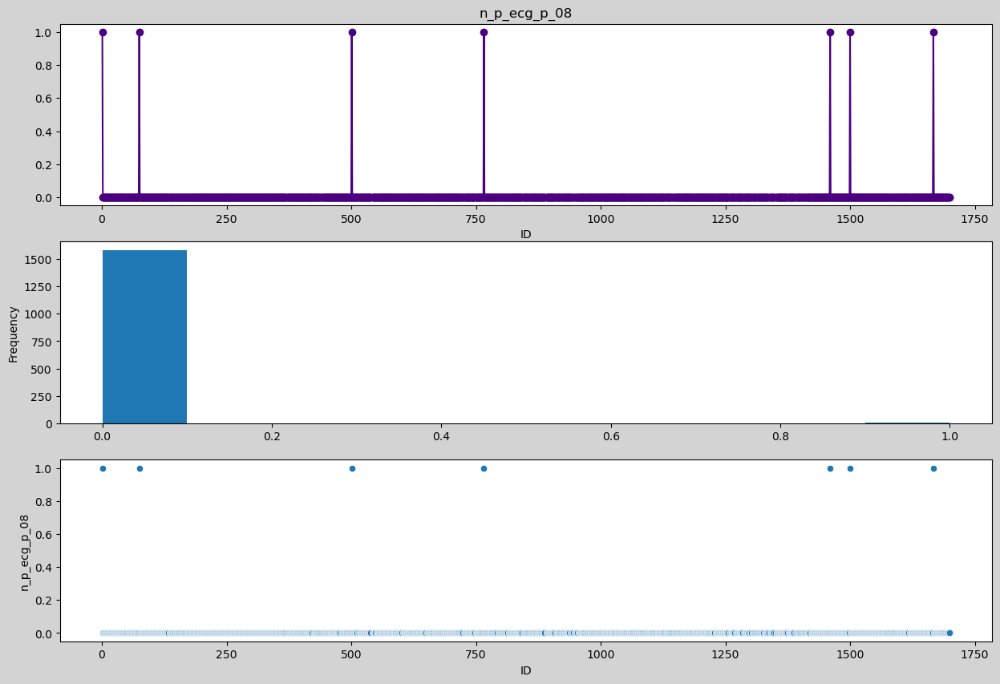

In [71]:
plots(df.n_p_ecg_p_08,'n_p_ecg_p_08','indigo')

In [72]:
df['n_p_ecg_p_08']=df['n_p_ecg_p_08'].fillna(round(df.n_p_ecg_p_08.mean()))

count    1585.000000
mean        0.064353
std         0.245459
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_07, dtype: float64
0.0    1483
1.0     102
Name: n_p_ecg_p_07, dtype: int64


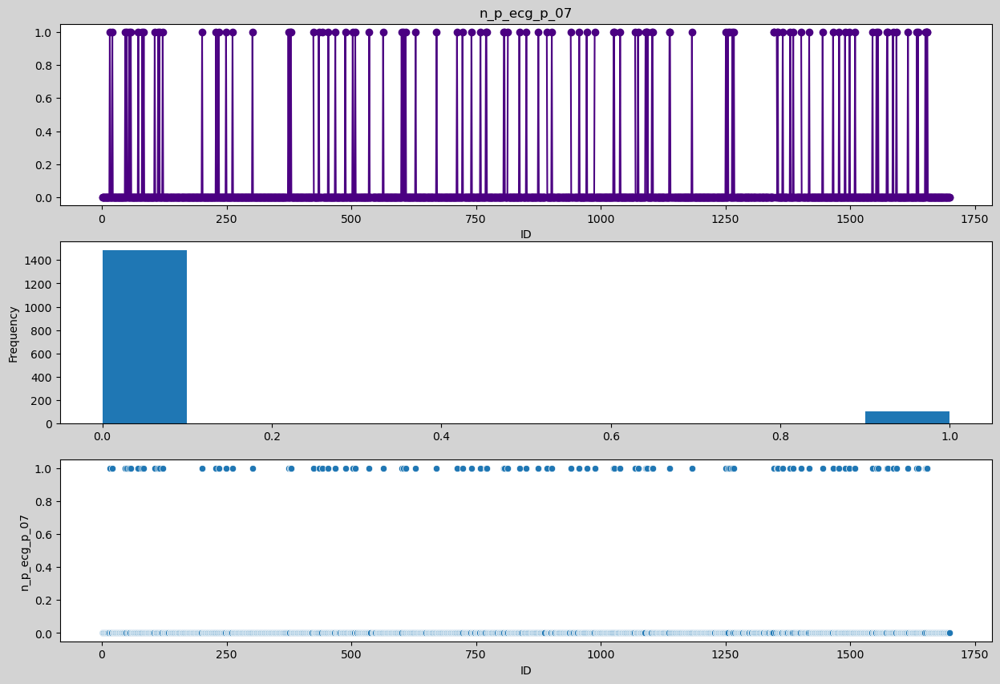

In [73]:
plots(df.n_p_ecg_p_07,'n_p_ecg_p_07','indigo')

In [74]:
df['n_p_ecg_p_07']=df['n_p_ecg_p_07'].fillna(round(df.n_p_ecg_p_07.mean()))

count    1585.000000
mean        0.017035
std         0.129441
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_06, dtype: float64
0.0    1558
1.0      27
Name: n_p_ecg_p_06, dtype: int64


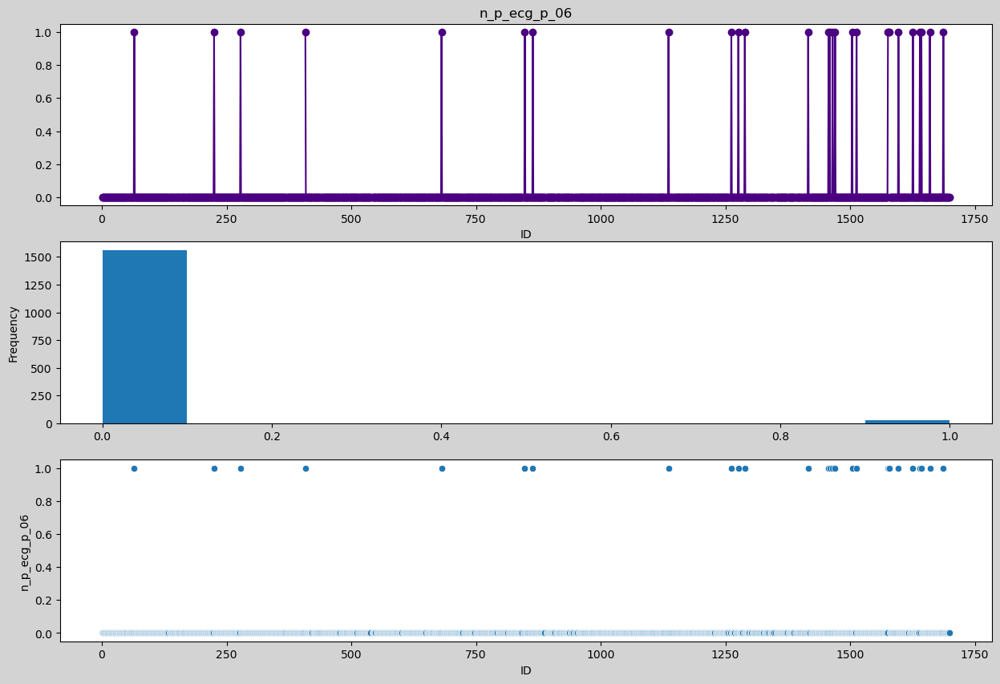

In [75]:
plots(df.n_p_ecg_p_06,'n_p_ecg_p_06','indigo')

In [76]:
df['n_p_ecg_p_06']=df['n_p_ecg_p_06'].fillna(round(df.n_p_ecg_p_06.mean()))

count    1585.000000
mean        0.001262
std         0.035511
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_01, dtype: float64
0.0    1583
1.0       2
Name: n_p_ecg_p_01, dtype: int64


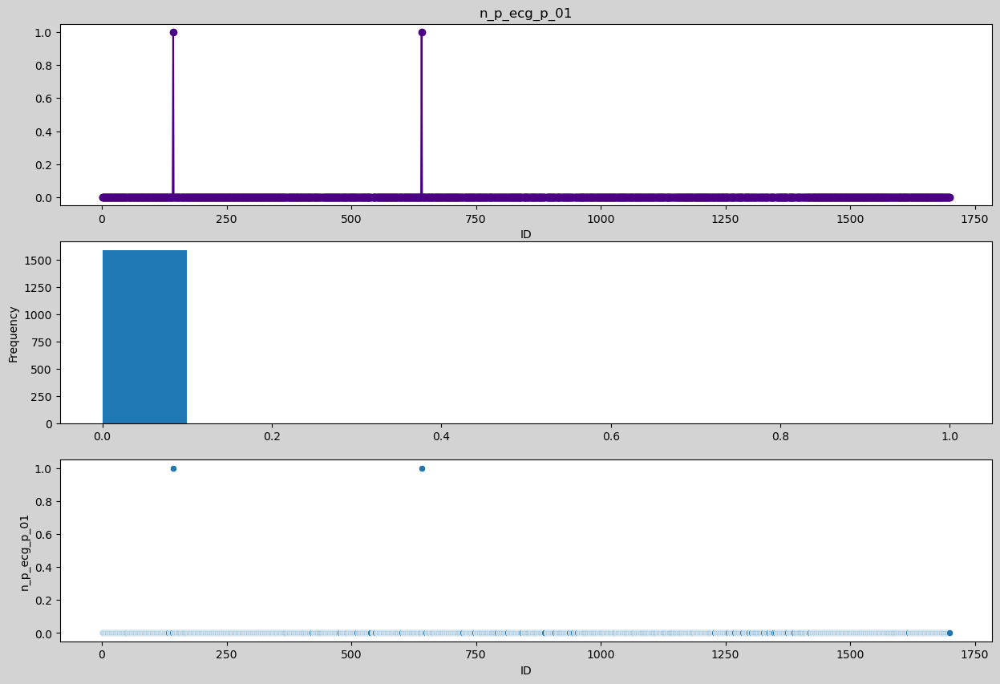

In [77]:
plots(df.n_p_ecg_p_01,'n_p_ecg_p_01','indigo')

In [78]:
df['n_p_ecg_p_01']=df['n_p_ecg_p_01'].fillna(round(df.n_p_ecg_p_01.mean()))

count    1585.000000
mean        0.003155
std         0.056095
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_04, dtype: float64
0.0    1580
1.0       5
Name: n_p_ecg_p_04, dtype: int64


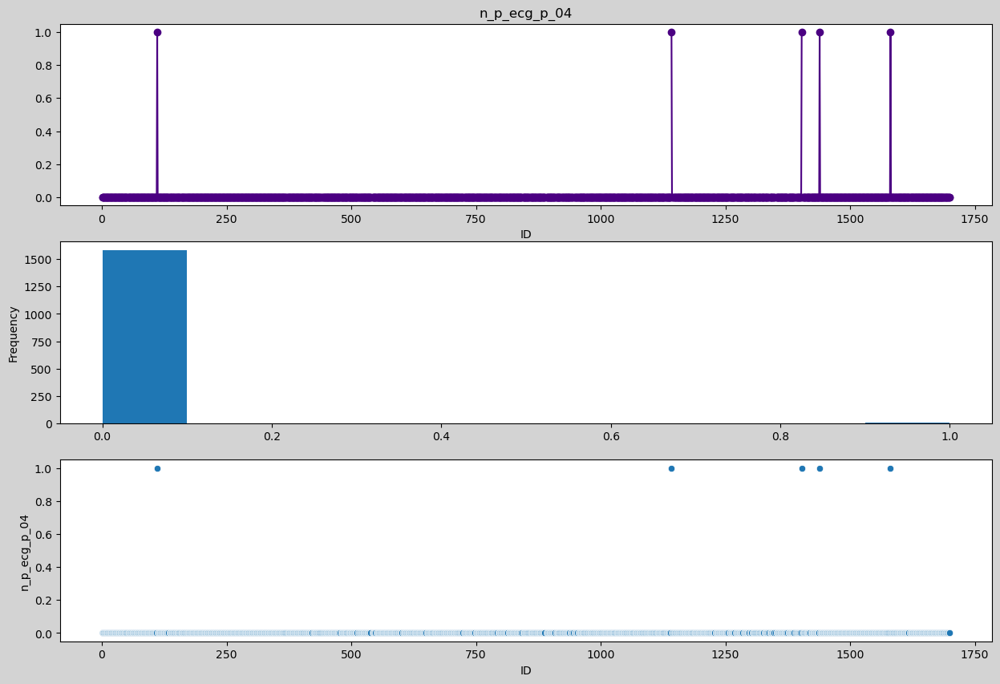

In [79]:
plots(df.n_p_ecg_p_04,'n_p_ecg_p_04','indigo')

In [80]:
df['n_p_ecg_p_04']=df['n_p_ecg_p_04'].fillna(round(df.n_p_ecg_p_04.mean()))

count    1585.000000
mean        0.044164
std         0.205524
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_05, dtype: float64
0.0    1515
1.0      70
Name: n_r_ecg_p_05, dtype: int64


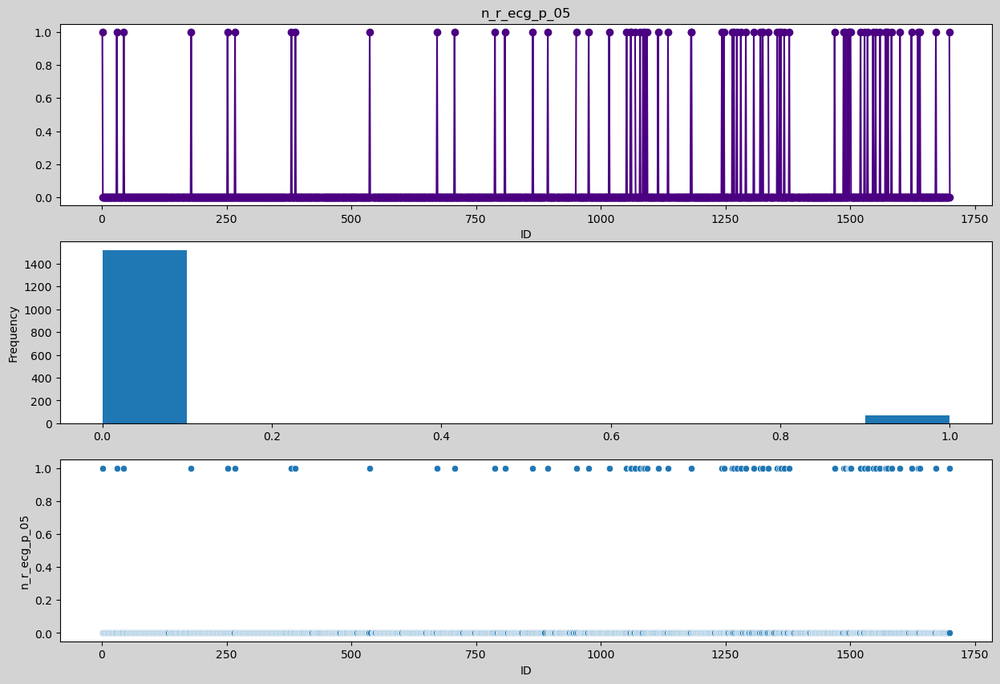

In [81]:
plots(df.n_r_ecg_p_05,'n_r_ecg_p_05','indigo')

In [82]:
df['n_r_ecg_p_05']=df['n_r_ecg_p_05'].fillna(round(df.n_r_ecg_p_05.mean()))

count    1585.000000
mean        0.020189
std         0.140692
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_p_ecg_p_03, dtype: float64
0.0    1553
1.0      32
Name: n_p_ecg_p_03, dtype: int64


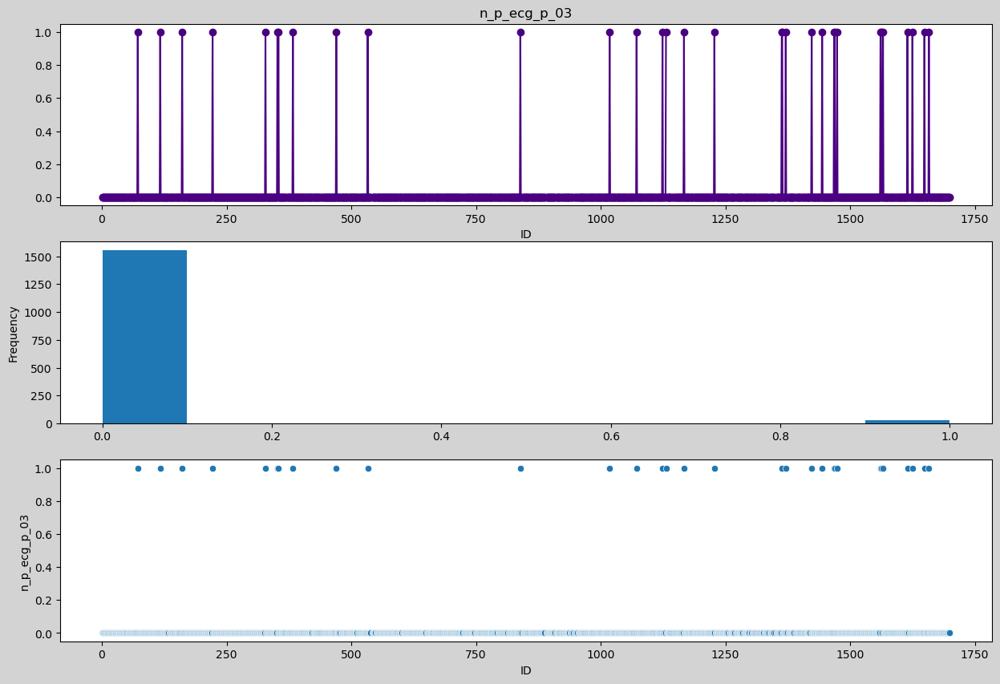

In [83]:
plots(df.n_p_ecg_p_03,'n_p_ecg_p_03','indigo')

In [84]:
df['n_p_ecg_p_03']=df['n_p_ecg_p_03'].fillna(round(df.n_p_ecg_p_03.mean()))

count    1585.000000
mean        0.005047
std         0.070887
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_02, dtype: float64
0.0    1577
1.0       8
Name: n_r_ecg_p_02, dtype: int64


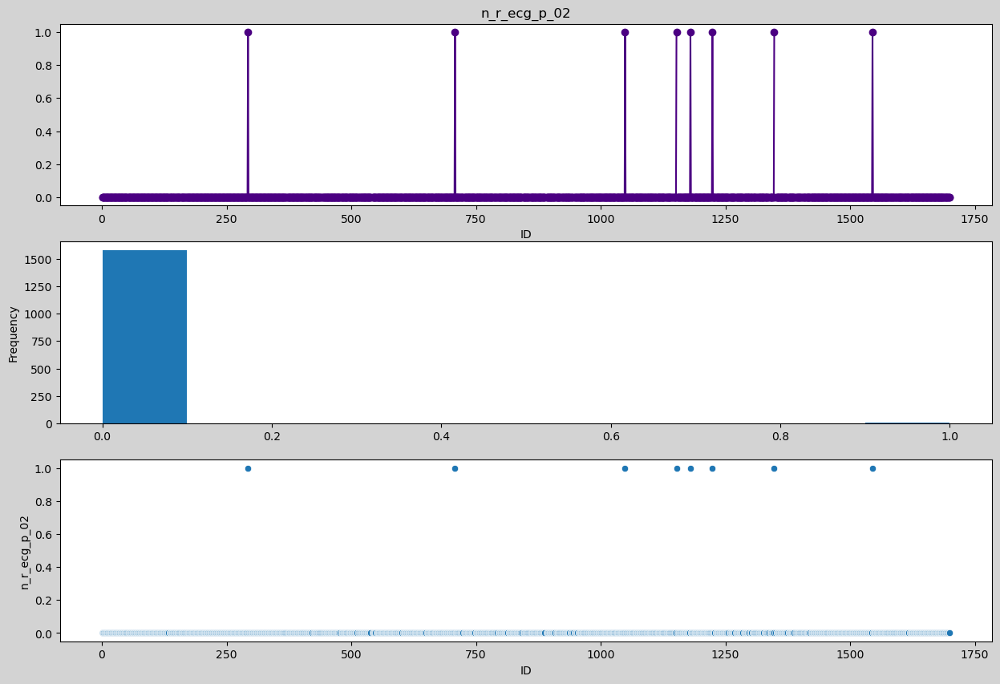

In [85]:
plots(df.n_r_ecg_p_02,'n_r_ecg_p_02','indigo')

In [86]:
df['n_r_ecg_p_02']=df['n_r_ecg_p_02'].fillna(round(df.n_r_ecg_p_02.mean()))

count    1585.000000
mean        0.128707
std         0.334981
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_03, dtype: float64
0.0    1381
1.0     204
Name: n_r_ecg_p_03, dtype: int64


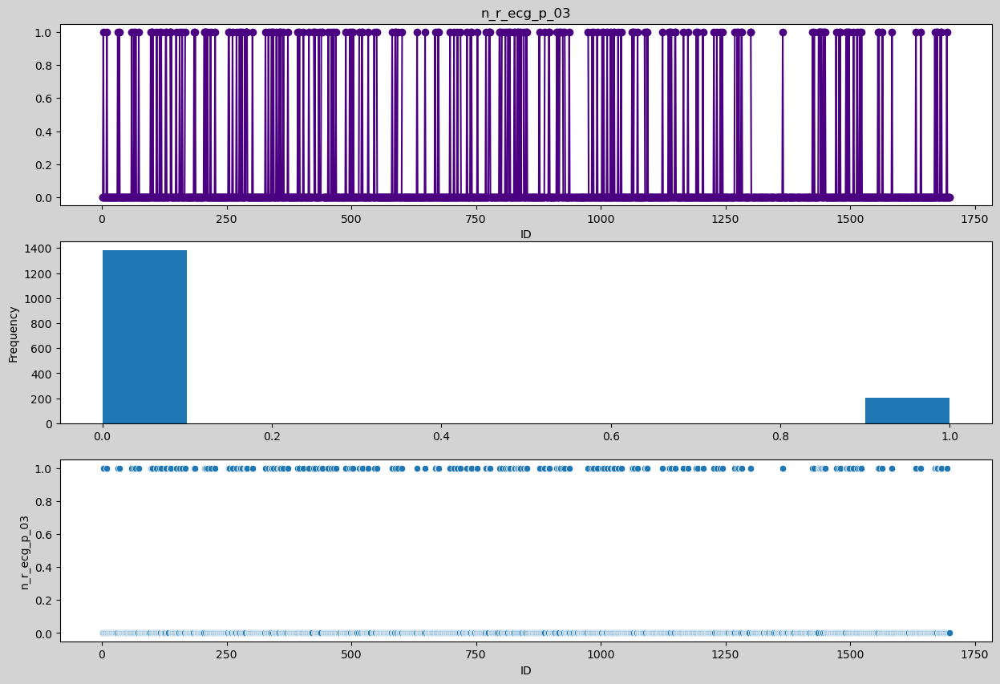

In [87]:
plots(df.n_r_ecg_p_03,'n_r_ecg_p_03','indigo')

In [88]:
df['n_r_ecg_p_03']=df['n_r_ecg_p_03'].fillna(round(df.n_r_ecg_p_03.mean()))

count    1585.000000
mean        0.043533
std         0.204118
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_04, dtype: float64
0.0    1516
1.0      69
Name: n_r_ecg_p_04, dtype: int64


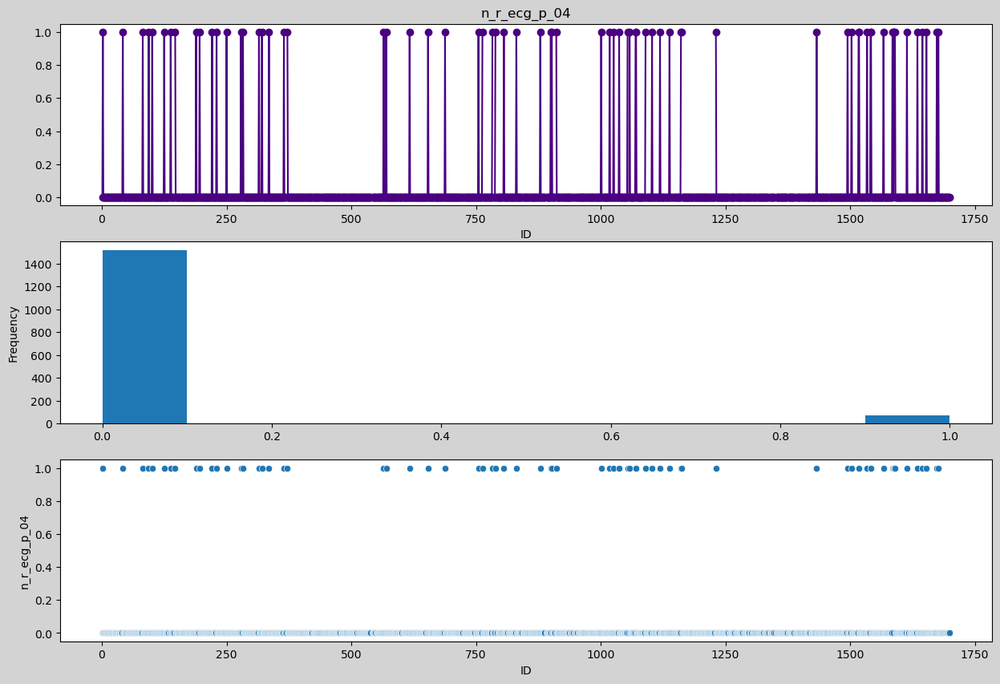

In [89]:
plots(df.n_r_ecg_p_04,'n_r_ecg_p_04','indigo')

In [90]:
df['n_r_ecg_p_04']=df['n_r_ecg_p_04'].fillna(round(df.n_r_ecg_p_04.mean()))

count    1585.000000
mean        0.036593
std         0.187820
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_01, dtype: float64
0.0    1527
1.0      58
Name: n_r_ecg_p_01, dtype: int64


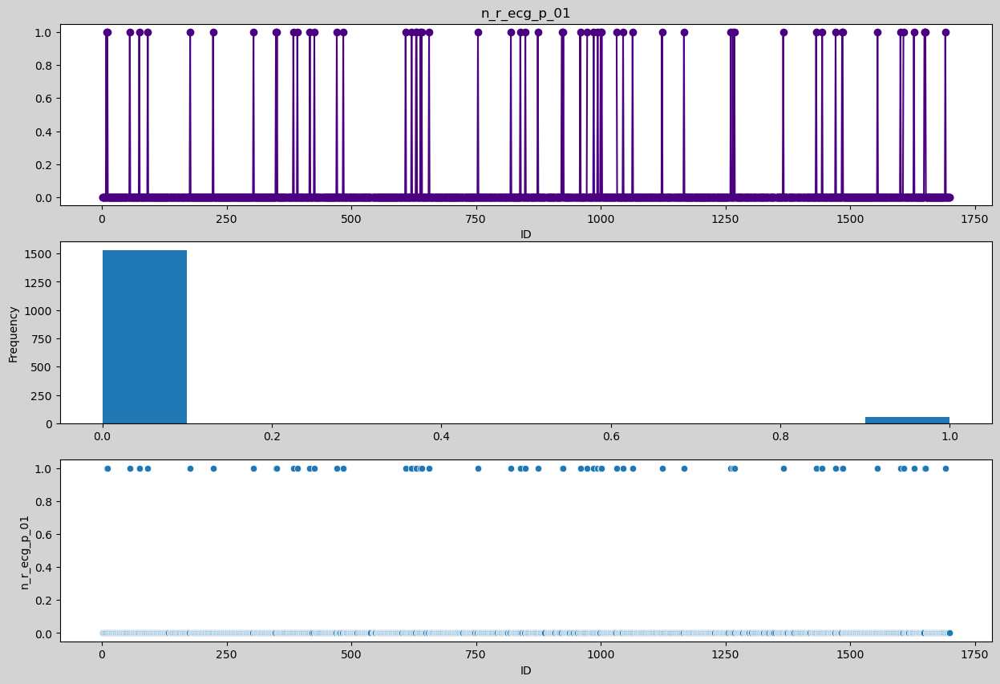

In [91]:
plots(df.n_r_ecg_p_01,'n_r_ecg_p_01','indigo')

In [92]:
df['n_r_ecg_p_01']=df['n_r_ecg_p_01'].fillna(round(df.n_r_ecg_p_01.mean()))

count    1585.000000
mean        0.020189
std         0.140692
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_06, dtype: float64
0.0    1553
1.0      32
Name: n_r_ecg_p_06, dtype: int64


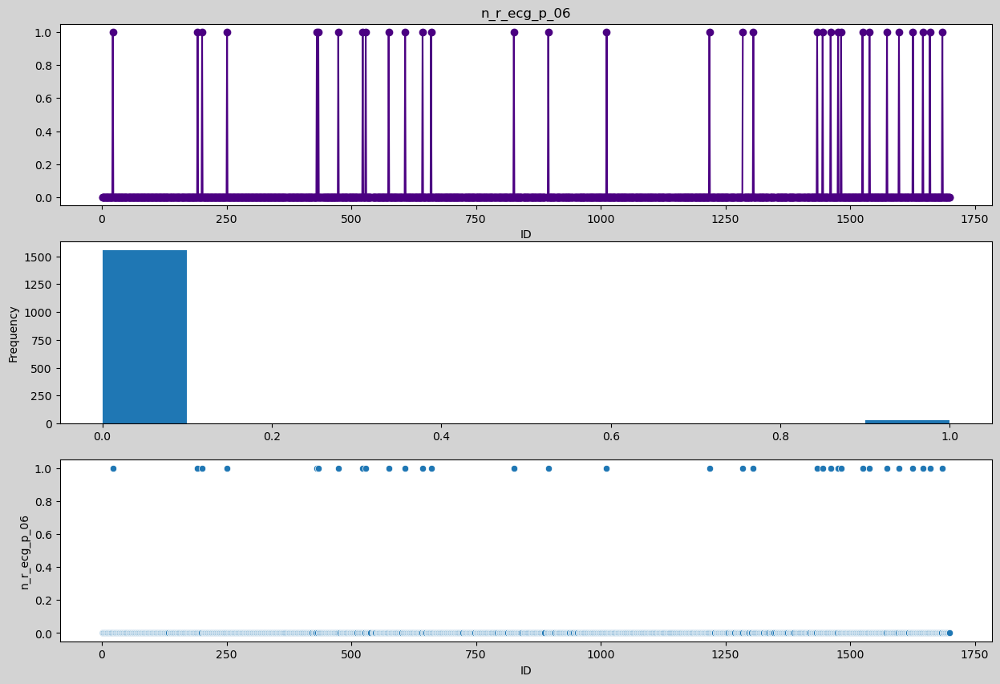

In [93]:
plots(df.n_r_ecg_p_06,'n_r_ecg_p_06','indigo')

In [94]:
df['n_r_ecg_p_06']=df['n_r_ecg_p_06'].fillna(round(df.n_r_ecg_p_06.mean()))

count    1585.000000
mean        0.002524
std         0.050188
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_08, dtype: float64
0.0    1581
1.0       4
Name: n_r_ecg_p_08, dtype: int64


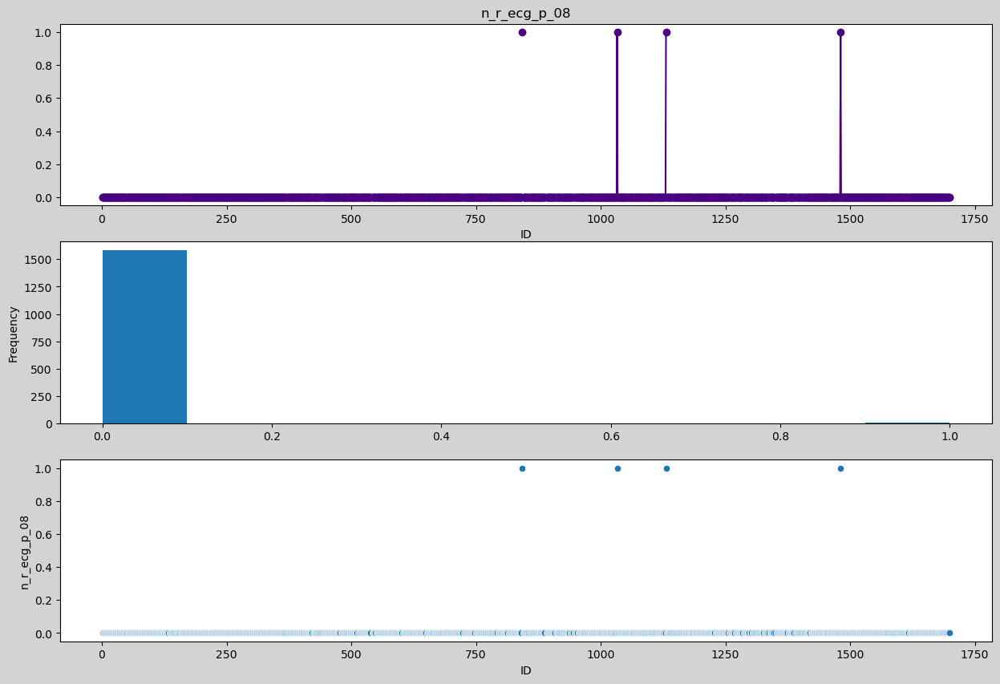

In [95]:
plots(df.n_r_ecg_p_08,'n_r_ecg_p_08','indigo')

In [96]:
df['n_r_ecg_p_08']=df['n_r_ecg_p_08'].fillna(round(df.n_r_ecg_p_08.mean()))

count    1585.000000
mean        0.001262
std         0.035511
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_09, dtype: float64
0.0    1583
1.0       2
Name: n_r_ecg_p_09, dtype: int64


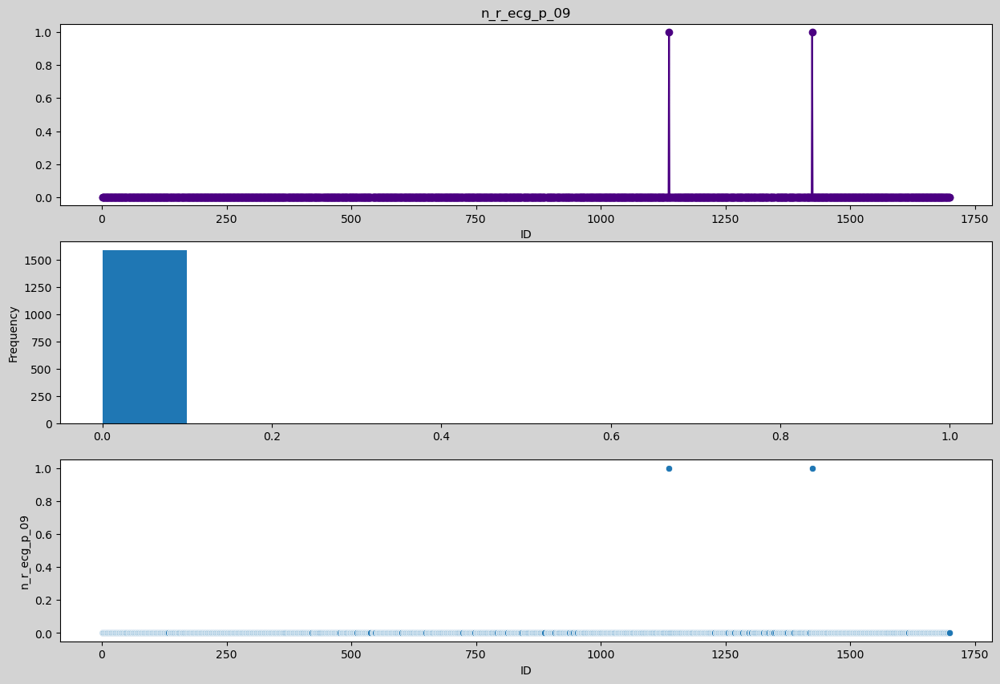

In [97]:
plots(df.n_r_ecg_p_09,'n_r_ecg_p_09','indigo')

In [98]:
df['n_r_ecg_p_09']=df['n_r_ecg_p_09'].fillna(round(df.n_r_ecg_p_09.mean()))

count    1585.000000
mean        0.001262
std         0.035511
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: n_r_ecg_p_10, dtype: float64
0.0    1583
1.0       2
Name: n_r_ecg_p_10, dtype: int64


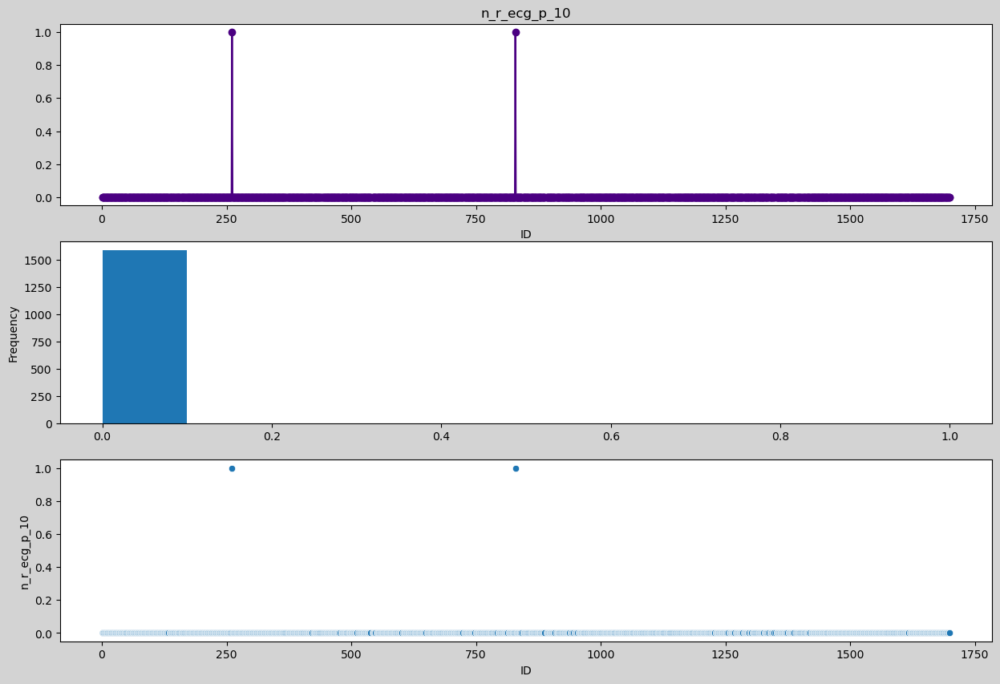

In [99]:
plots(df.n_r_ecg_p_10,'n_r_ecg_p_10','indigo')

In [100]:
df['n_r_ecg_p_10']=df['n_r_ecg_p_10'].fillna(round(df.n_r_ecg_p_10.mean()))

count    1590.000000
mean        0.113208
std         0.399514
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         3.000000
Name: NOT_NA_2_n, dtype: float64
0.0    1454
1.0      95
2.0      38
3.0       3
Name: NOT_NA_2_n, dtype: int64


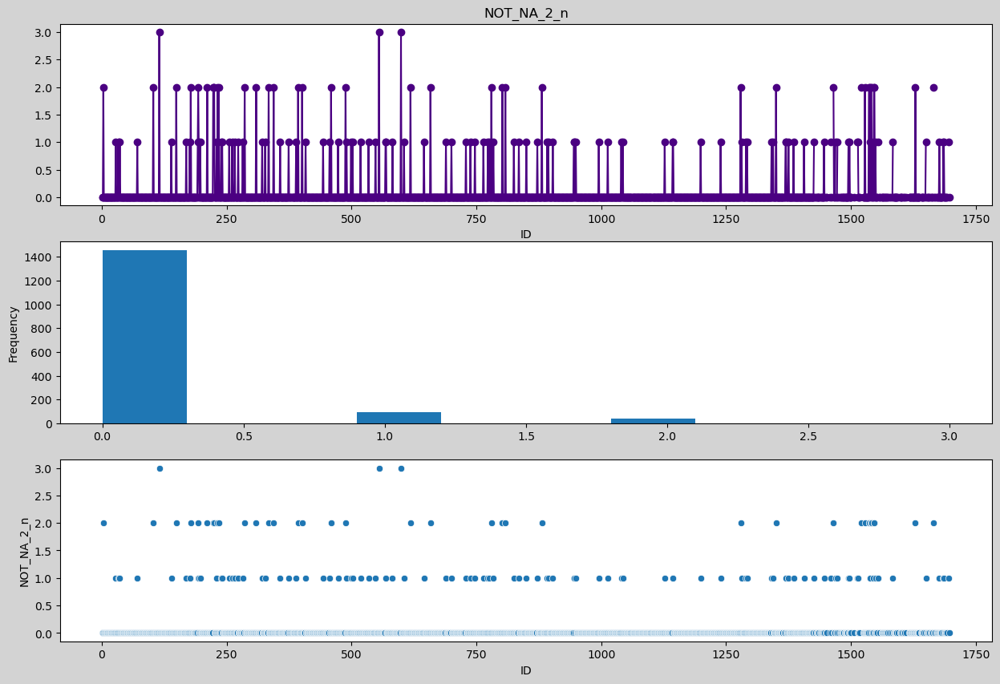

In [101]:
plots(df.NOT_NA_2_n,'NOT_NA_2_n','indigo')

In [102]:
df['NOT_NA_2_n']=df['NOT_NA_2_n'].fillna(round(df.NOT_NA_2_n.mean()))

count    1592.000000
mean        0.140704
std         0.424340
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         3.000000
Name: R_AB_2_n, dtype: float64
0.0    1414
1.0     133
2.0      44
3.0       1
Name: R_AB_2_n, dtype: int64


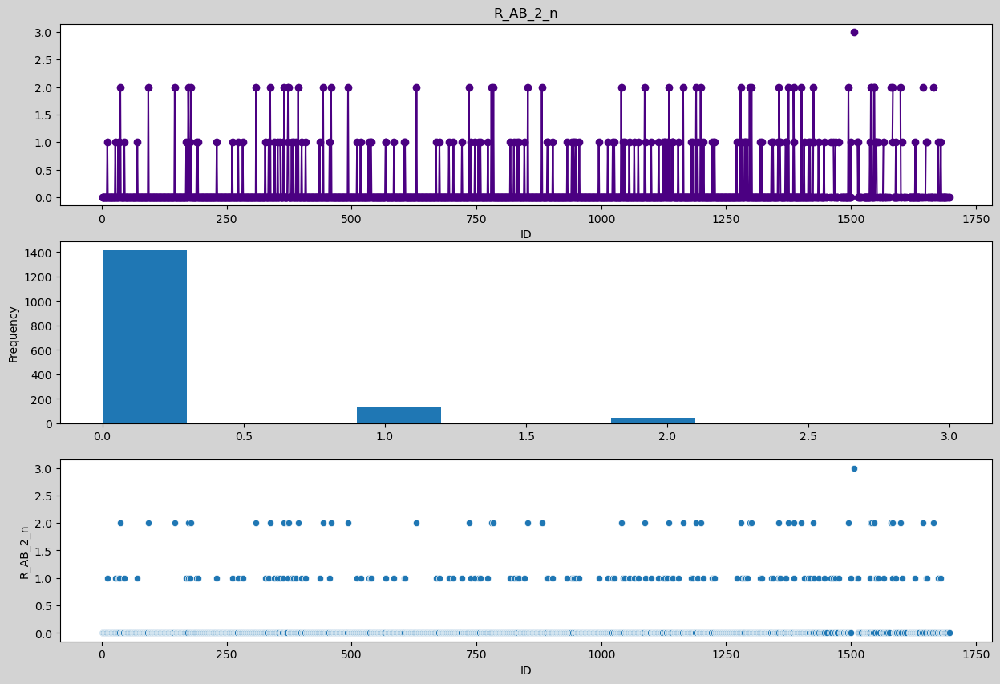

In [103]:
plots(df.R_AB_2_n,'R_AB_2_n','indigo')

In [104]:
df['R_AB_2_n']=df['R_AB_2_n'].fillna(round(df.R_AB_2_n.mean()))

count    1592.000000
mean        0.094221
std         0.356203
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         3.000000
Name: NA_R_2_n, dtype: float64
0.0    1474
1.0      87
2.0      30
3.0       1
Name: NA_R_2_n, dtype: int64


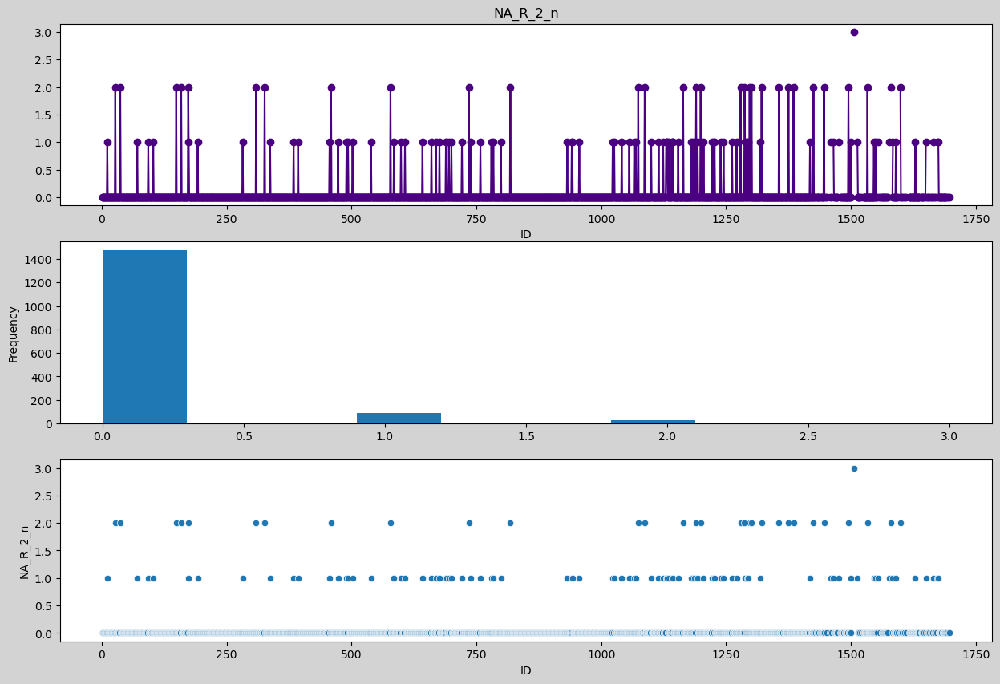

In [105]:
plots(df.NA_R_2_n,'NA_R_2_n','indigo')

In [106]:
df['NA_R_2_n']=df['NA_R_2_n'].fillna(round(df.NA_R_2_n.mean()))

count    1594.000000
mean        2.316186
std         2.440586
min         0.000000
25%         0.000000
50%         1.000000
75%         5.000000
max         6.000000
Name: STENOK_AN, dtype: float64
0.0    661
6.0    332
1.0    146
2.0    137
5.0    125
3.0    117
4.0     76
Name: STENOK_AN, dtype: int64


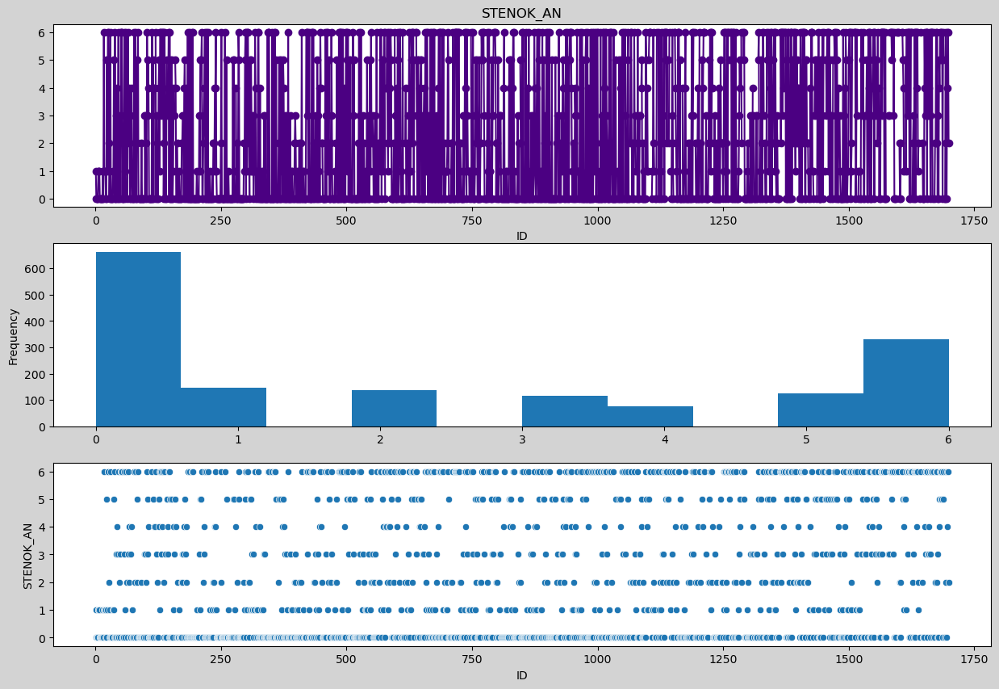

In [107]:
plots(df.STENOK_AN,'STENOK_AN','indigo')

In [108]:
df['STENOK_AN']=df['STENOK_AN'].fillna(round(df.STENOK_AN.mean()))

count    1617.000000
mean        1.570810
std         1.711952
min         0.000000
25%         0.000000
50%         1.000000
75%         4.000000
max         4.000000
Name: ant_im, dtype: float64
0.0    660
4.0    492
1.0    392
2.0     39
3.0     34
Name: ant_im, dtype: int64


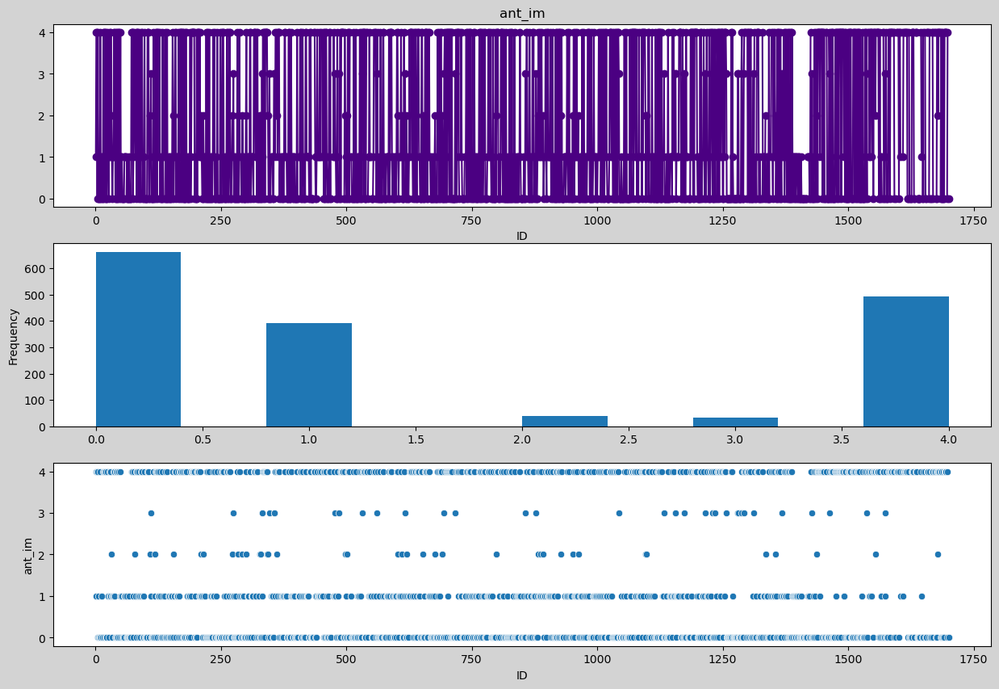

In [109]:
plots(df.ant_im,'ant_im','indigo')

In [110]:
df['ant_im']=df['ant_im'].fillna(round(df.ant_im.mean()))

count    1620.000000
mean        1.014815
std         1.404934
min         0.000000
25%         0.000000
50%         0.000000
75%         2.000000
max         4.000000
Name: inf_im, dtype: float64
0.0    937
1.0    195
2.0    191
4.0    176
3.0    121
Name: inf_im, dtype: int64


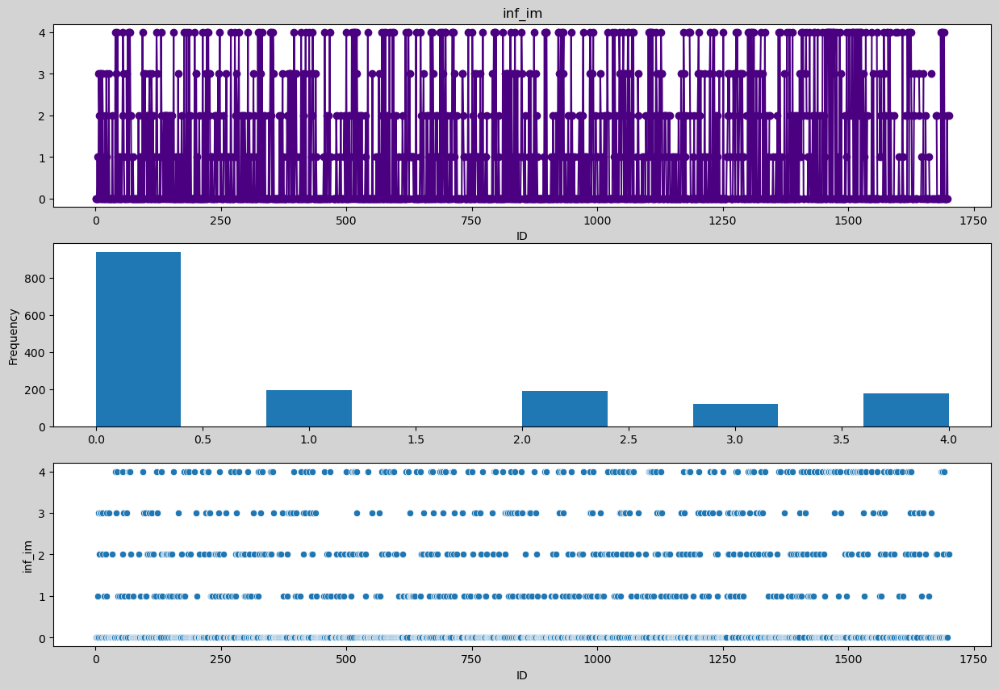

In [111]:
plots(df.inf_im,'inf_im','indigo')

In [112]:
df['inf_im']=df['inf_im'].fillna(round(df.inf_im.mean()))

count    1620.000000
mean        0.861728
std         0.883249
min         0.000000
25%         0.000000
50%         1.000000
75%         1.000000
max         4.000000
Name: lat_im, dtype: float64
1.0    838
0.0    576
2.0     97
3.0     72
4.0     37
Name: lat_im, dtype: int64


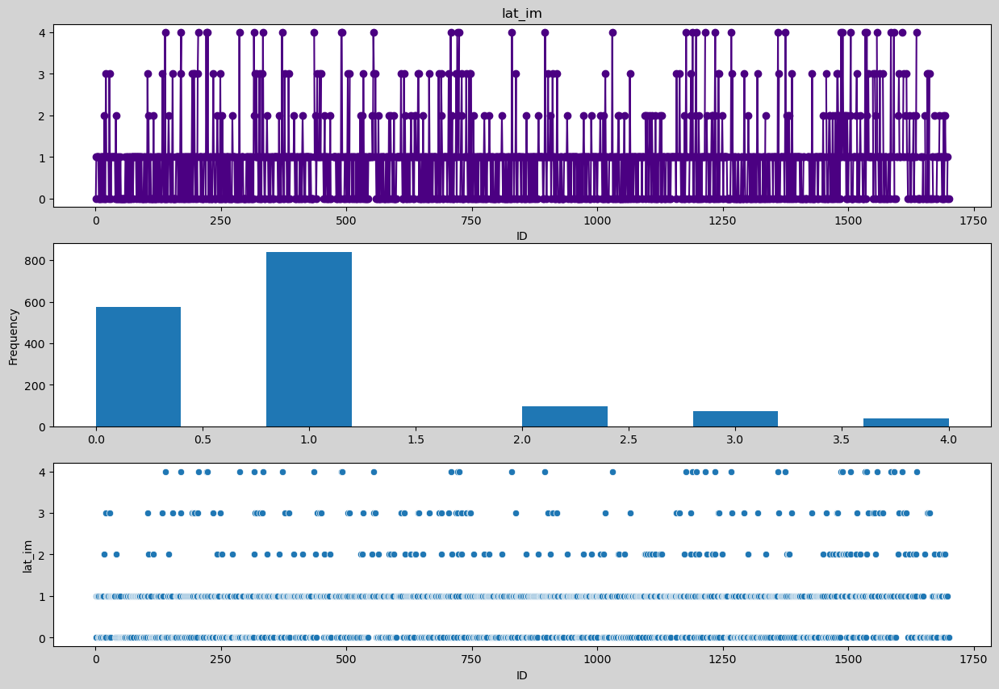

In [113]:
plots(df.lat_im,'lat_im','indigo')

In [114]:
df['lat_im']=df['lat_im'].fillna(round(df.lat_im.mean()))

count    1627.000000
mean        1.205286
std         1.040814
min         0.000000
25%         0.000000
50%         2.000000
75%         2.000000
max         4.000000
Name: FK_STENOK, dtype: float64
2.0    854
0.0    661
3.0     54
1.0     47
4.0     11
Name: FK_STENOK, dtype: int64


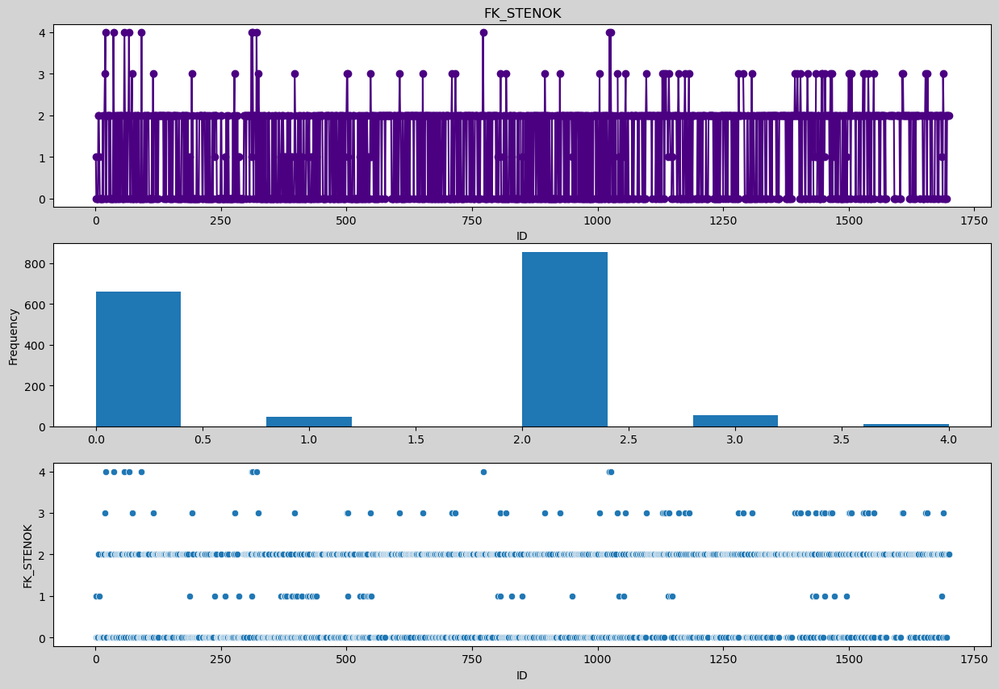

In [115]:
plots(df.FK_STENOK,'FK_STENOK','indigo')

In [116]:
df['FK_STENOK']=df['FK_STENOK'].fillna(round(df.FK_STENOK.mean()))

count    1628.000000
mean        0.259214
std         0.698850
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         4.000000
Name: post_im, dtype: float64
0.0    1370
1.0     157
2.0      52
3.0      35
4.0      14
Name: post_im, dtype: int64


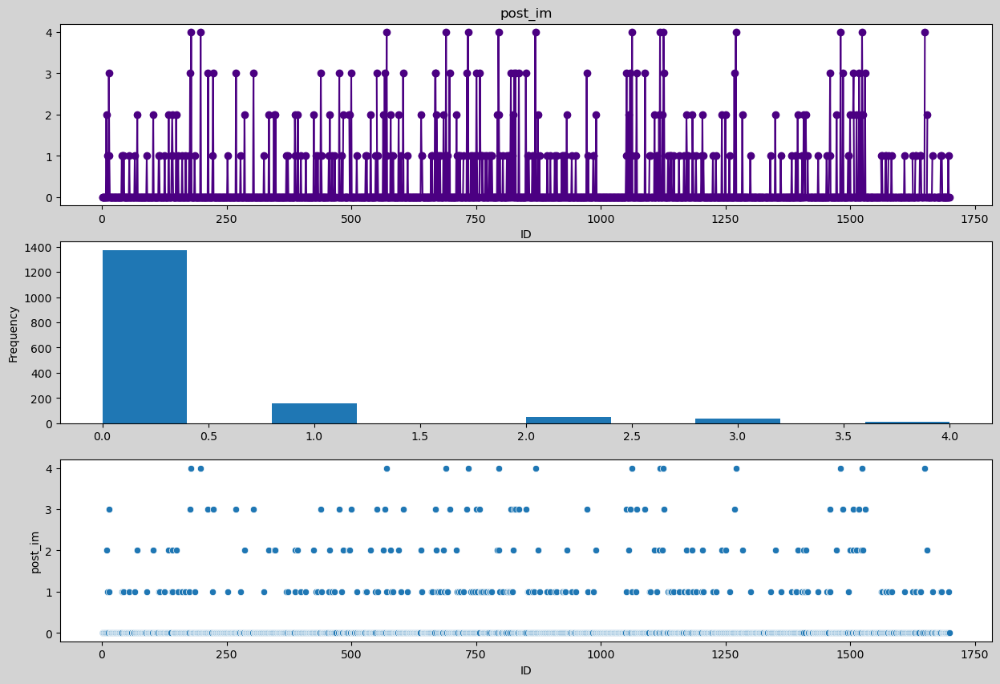

In [117]:
plots(df.post_im,'post_im','indigo')

In [118]:
df['post_im']=df['post_im'].fillna(round(df.post_im.mean()))

count    1646.000000
mean        0.194411
std         0.658722
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         4.000000
Name: ZSN_A, dtype: float64
0.0    1468
1.0     103
3.0      29
2.0      27
4.0      19
Name: ZSN_A, dtype: int64


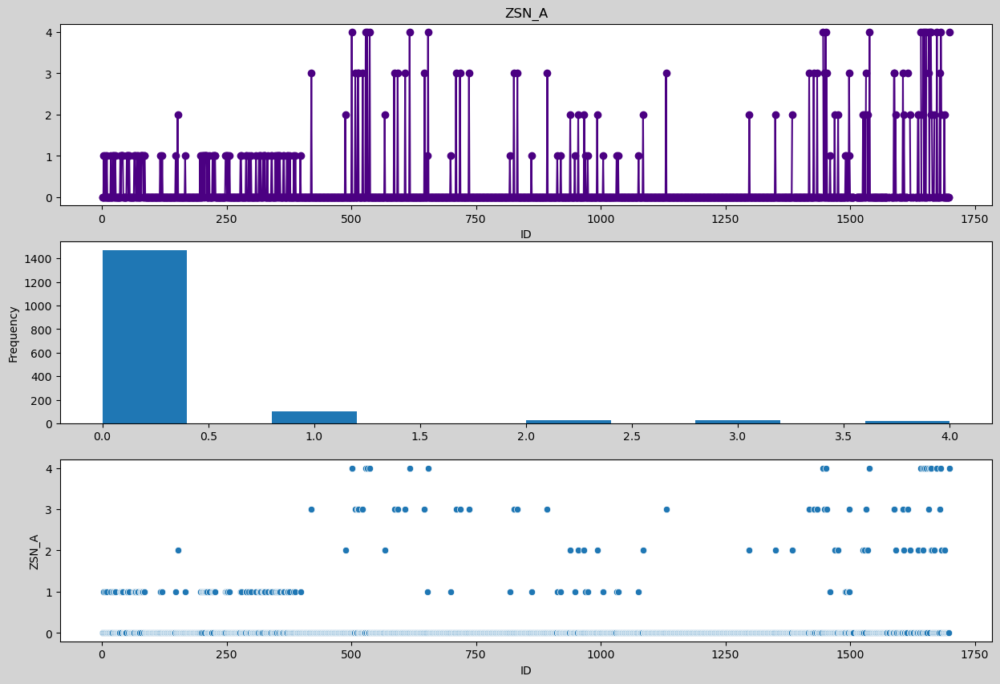

In [119]:
plots(df.ZSN_A,'ZSN_A','indigo')

In [120]:
df['ZSN_A']=df['ZSN_A'].fillna(round(df.ZSN_A.mean()))

count    1649.000000
mean        1.160703
std         0.801400
min         0.000000
25%         0.000000
50%         1.000000
75%         2.000000
max         2.000000
Name: IBS_POST, dtype: float64
2.0    683
1.0    548
0.0    418
Name: IBS_POST, dtype: int64


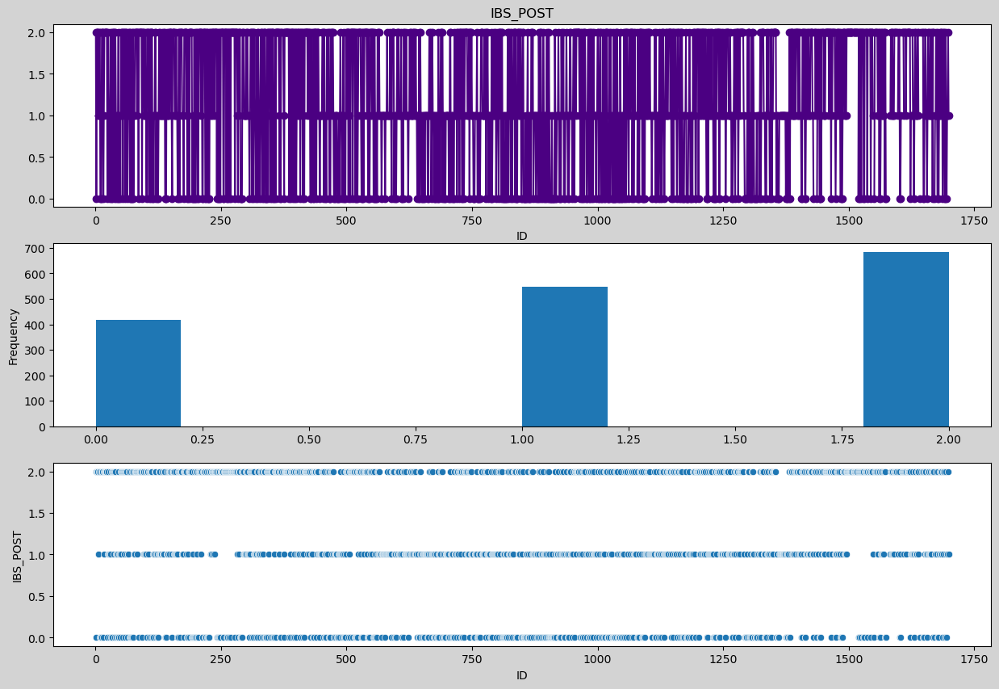

In [121]:
plots(df.IBS_POST,'IBS_POST','indigo')

In [122]:
df['IBS_POST']=df['IBS_POST'].fillna(round(df.IBS_POST.mean()))

count    1325.000000
mean        0.022642
std         0.148814
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         1.000000
Name: GIPER_NA, dtype: float64
0.0    1295
1.0      30
Name: GIPER_NA, dtype: int64


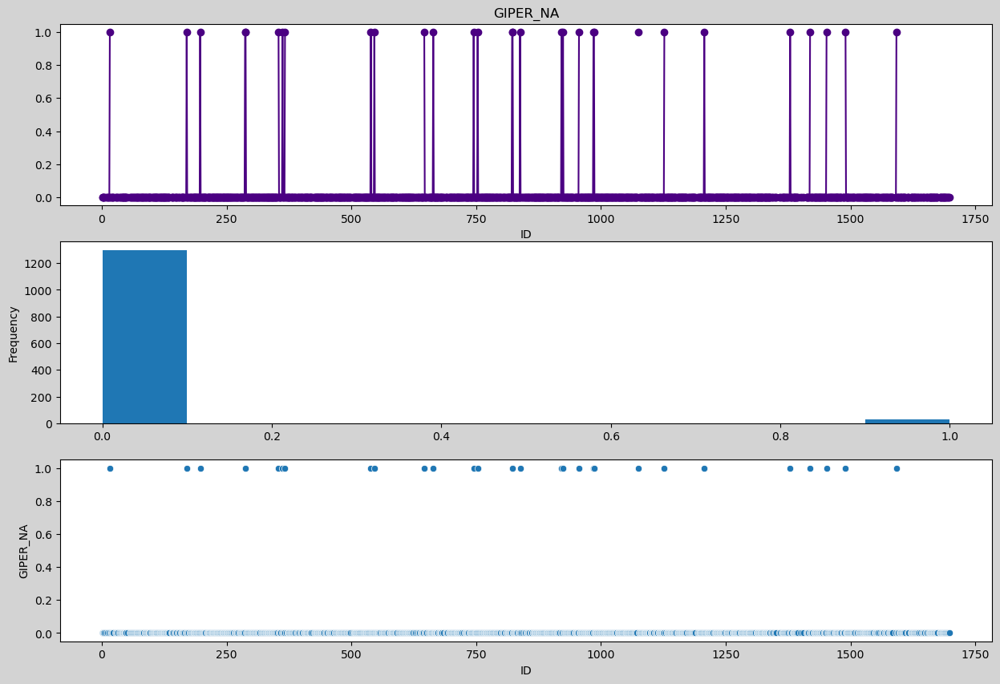

In [123]:
plots(df.GIPER_NA,'GIPER_NA','indigo')

In [124]:
df['GIPER_NA']=df['GIPER_NA'].fillna(round(df.GIPER_NA.mean()))

In [125]:
#Find the duplicates

df.duplicated().sum()

0

In [126]:
x=df.isnull().sum()/len(df)
o=display(x[x>0].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))
o


,percentage of null values
NA_BLOOD,0.220588
K_BLOOD,0.218235
GIPO_K,0.217059
AST_BLOOD,0.167647
ALT_BLOOD,0.167059
S_AD_ORIT,0.157059
D_AD_ORIT,0.157059
DLIT_AG,0.145882
ROE,0.119412
TIME_B_S,0.074118


In [127]:
display(x[x==0].sort_values(ascending = False).to_frame().rename({0:'percentage of null values'}, axis = 1).style.background_gradient('magma_r'))
print(f'Number of no null values   {len(x[x==0])}')

,percentage of null values
AGE,0.000000
n_r_ecg_p_06,0.000000
R_AB_2_n,0.000000
R_AB_1_n,0.000000
GIPER_NA,0.000000
fibr_ter_08,0.000000
fibr_ter_07,0.000000
fibr_ter_06,0.000000
fibr_ter_05,0.000000
fibr_ter_03,0.000000


Number of no null values   105


In [128]:
b=(x[x>0])

In [129]:
#here i have used knn imputer for randomly distributed variables
from sklearn.impute import KNNImputer

cols=b.index
impute = KNNImputer(n_neighbors=5)


df[cols]=impute.fit_transform(df[cols])

In [130]:
#now there are no null values 
s=df.isnull().sum()/len(df)
s[s==0]

AGE          0.0
SEX          0.0
INF_ANAM     0.0
STENOK_AN    0.0
FK_STENOK    0.0
            ... 
DRESSLER     0.0
ZSN          0.0
REC_IM       0.0
P_IM_STEN    0.0
LET_IS       0.0
Length: 116, dtype: float64

In [131]:
def univariate(df,col,vartype,hue =None):
    for col in df.columns:

        sns.set(style="darkgrid")
        if vartype == 0:
            fig, ax=plt.subplots(nrows =1,ncols=3,figsize=(20,8))
            ax[0].set_title("Distribution Plot")
            sns.distplot(df[col],ax=ax[0])
            ax[1].set_title("Violin Plot")
            sns.violinplot(data =df, x=col,ax=ax[1], inner="quartile")
            ax[2].set_title("Box Plot")
            sns.boxplot(data =df, x=col,ax=ax[2],orient='v')
        if vartype == 1:
            temp = pd.Series(data = hue)
            fig, ax = plt.subplots()
            width = len(df[col].unique()) + 6 + 4*len(temp.unique())
            fig.set_size_inches(width , 7)
            ax = sns.countplot(data = df, x= col, order=df[col].value_counts().index,hue = hue) 
            if len(temp.unique()) > 0:
                for p in ax.patches:
                    ax.annotate('{:1.1f}%'.format((p.get_height()*100)/float(len(df))), (p.get_x()+0.05, p.get_height()+20))  
            else:
                for p in ax.patches:
                    ax.annotate(p.get_height(), (p.get_x()+0.32, p.get_height()+20)) 
            del temp
        else:
            exit
        plt.show()

In [132]:
df.columns

Index(['AGE', 'SEX', 'INF_ANAM', 'STENOK_AN', 'FK_STENOK', 'IBS_POST', 'GB',
       'SIM_GIPERT', 'DLIT_AG', 'ZSN_A',
       ...
       'JELUD_TAH', 'FIBR_JELUD', 'A_V_BLOK', 'OTEK_LANC', 'RAZRIV',
       'DRESSLER', 'ZSN', 'REC_IM', 'P_IM_STEN', 'LET_IS'],
      dtype='object', length=116)

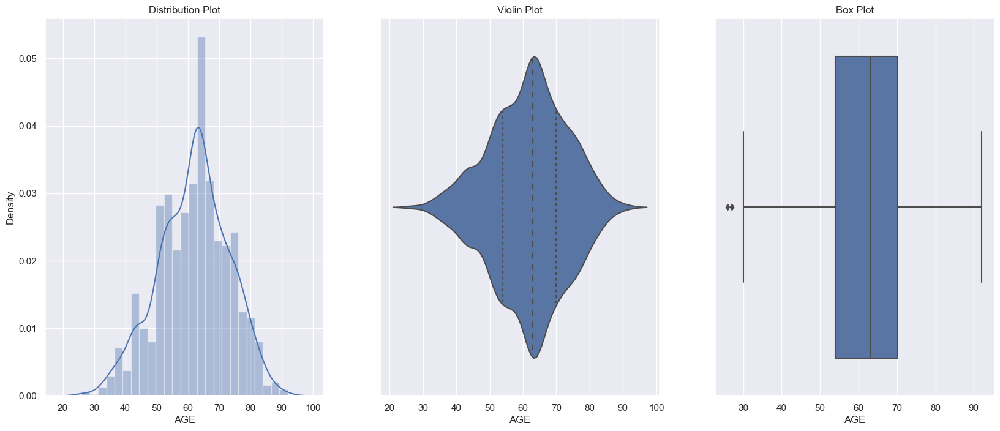

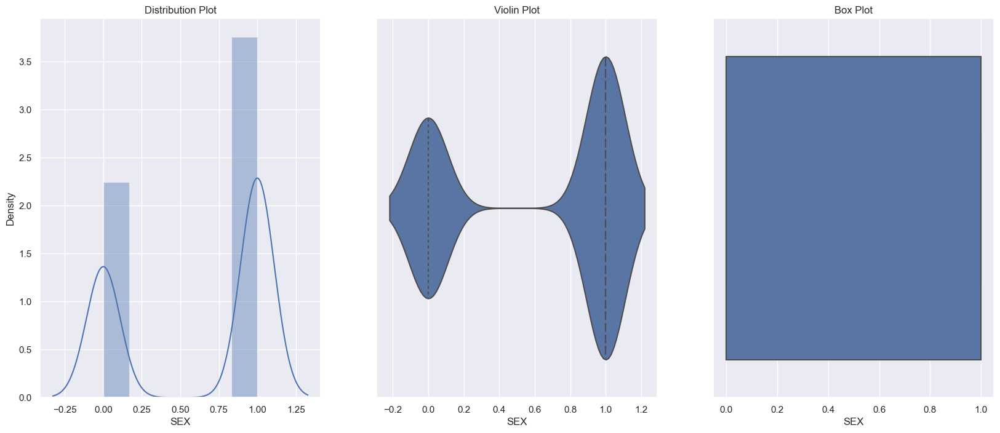

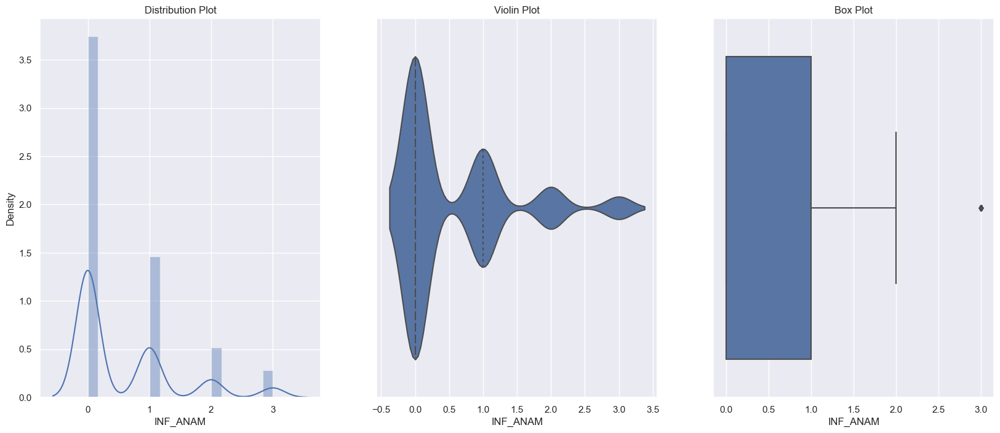

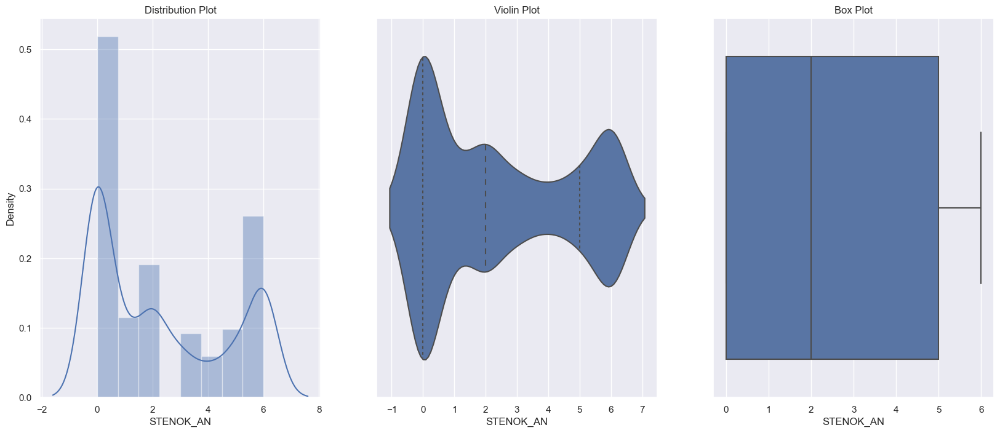

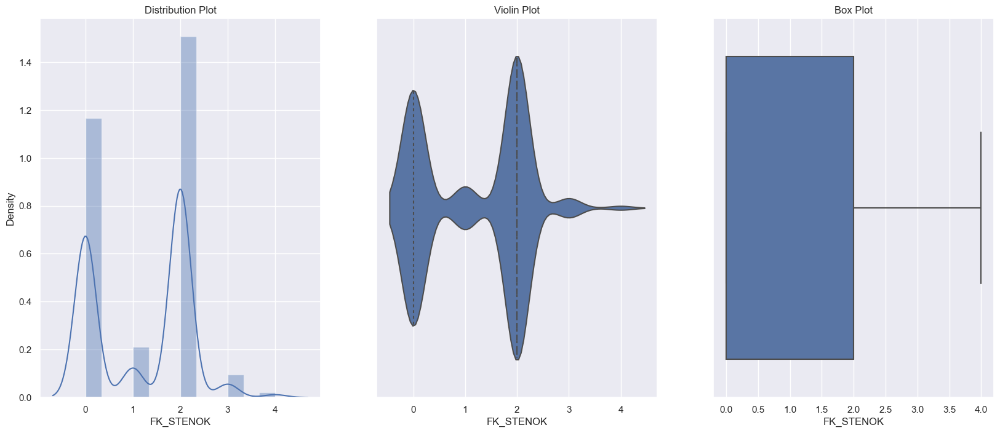

...

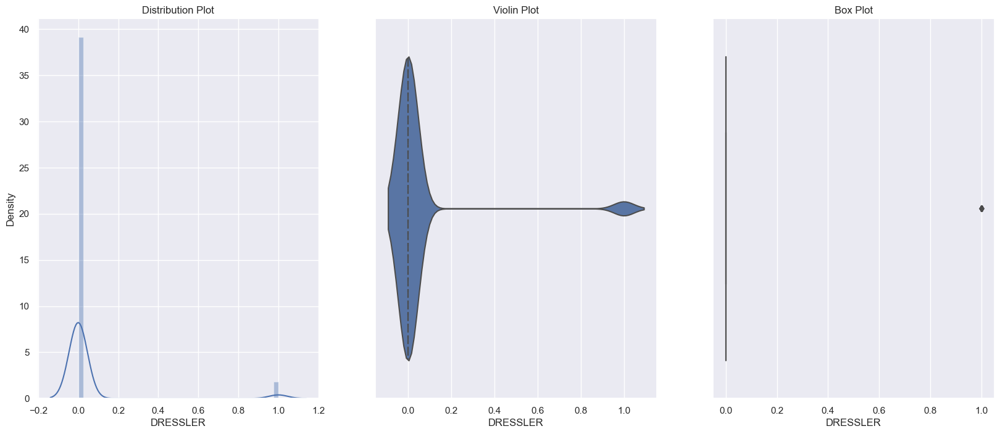

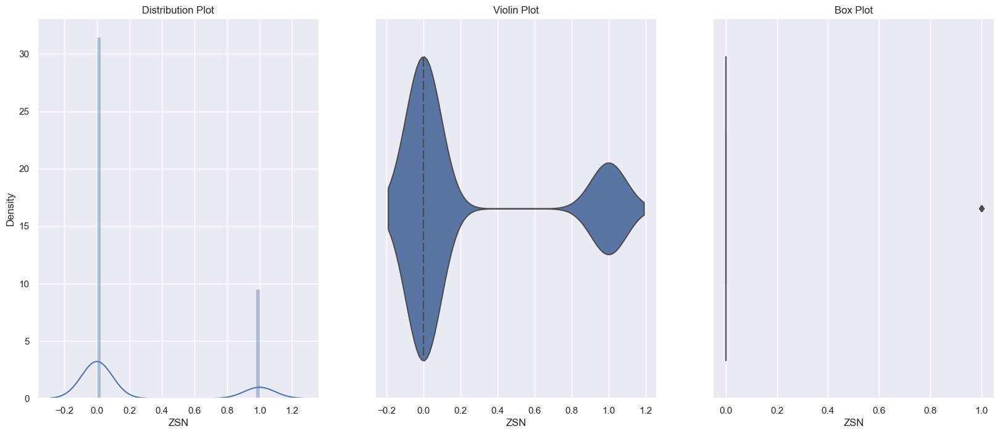

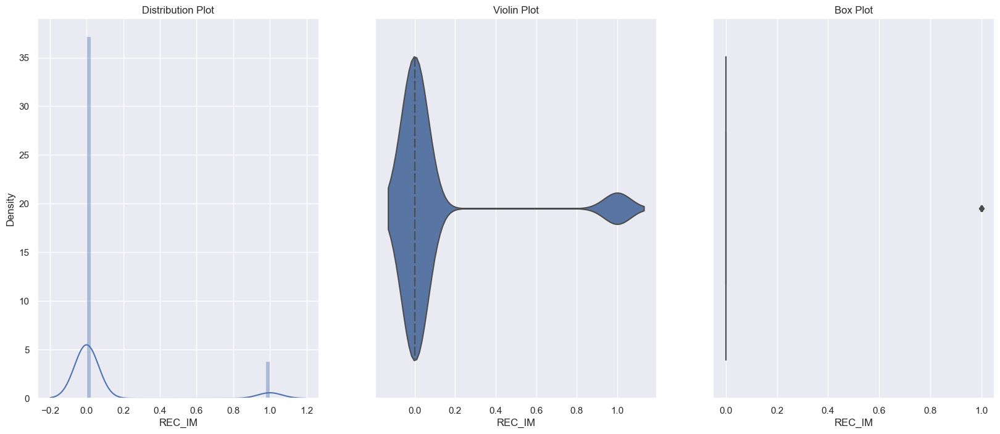

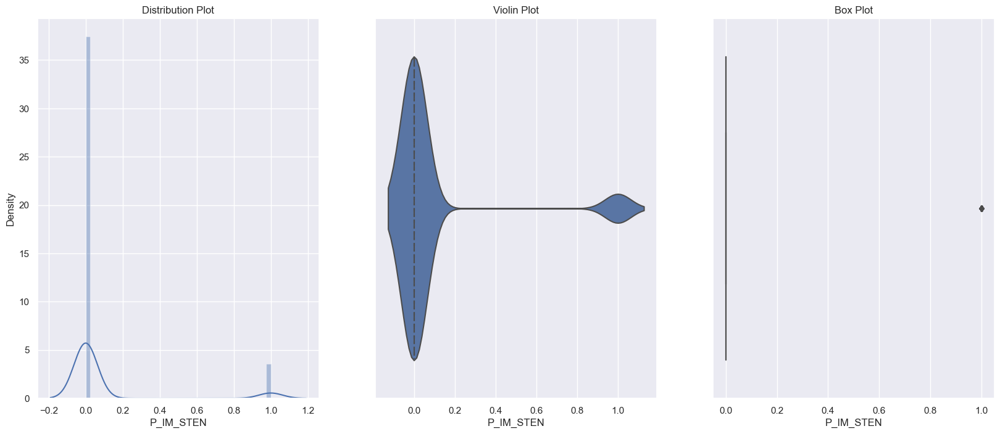

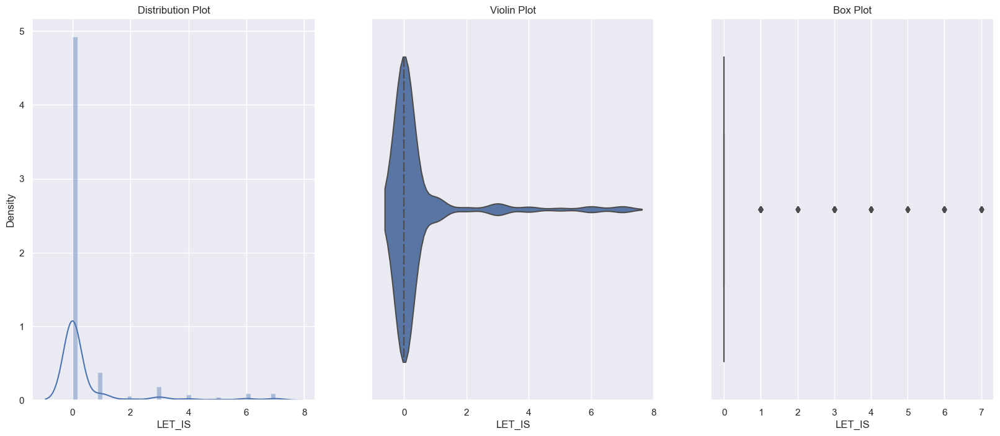

In [133]:
import warnings
warnings.filterwarnings('ignore')

univariate(df=df,col='AGE',vartype=0)

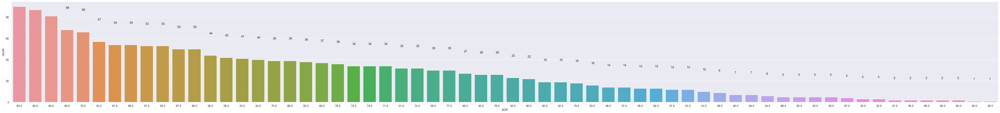

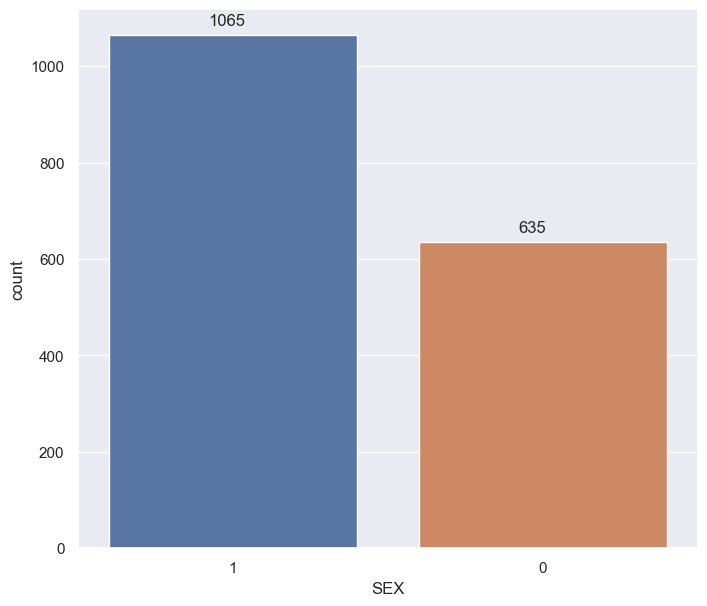

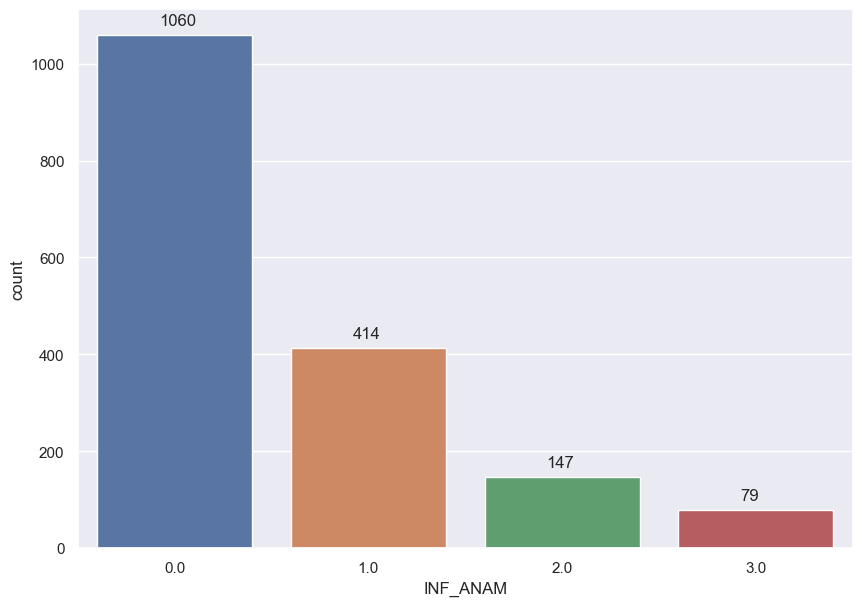

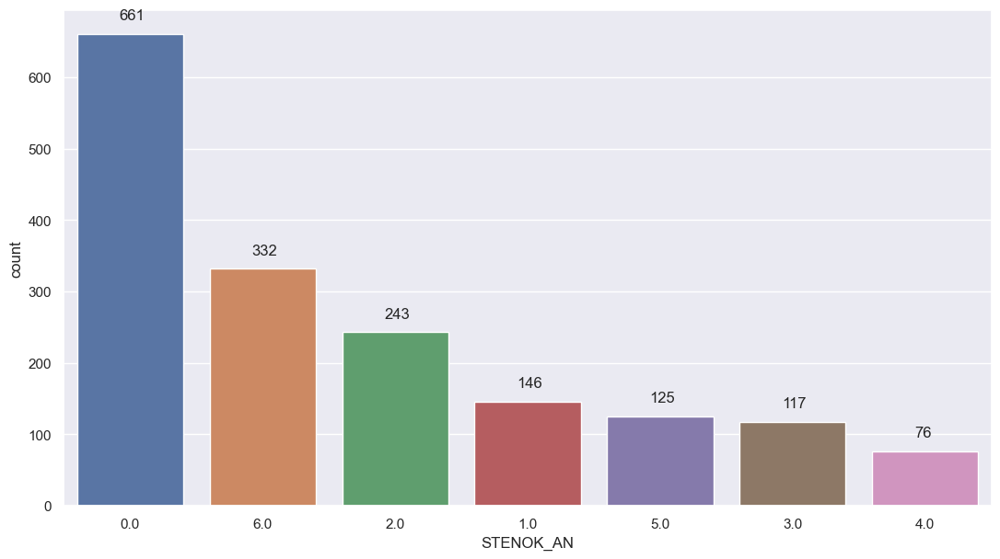

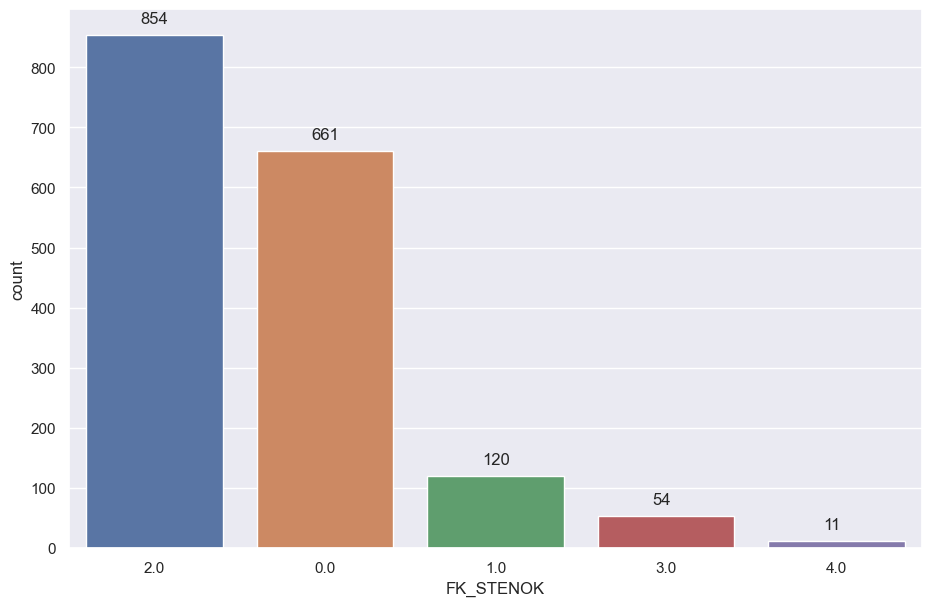

...

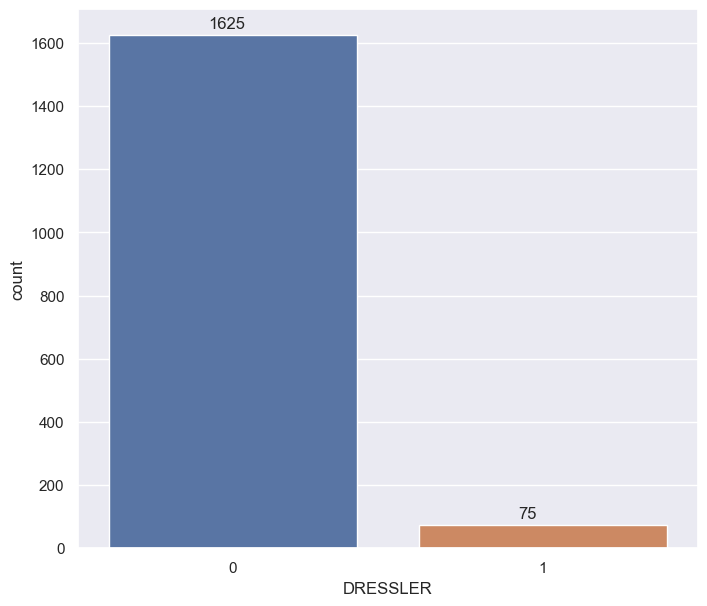

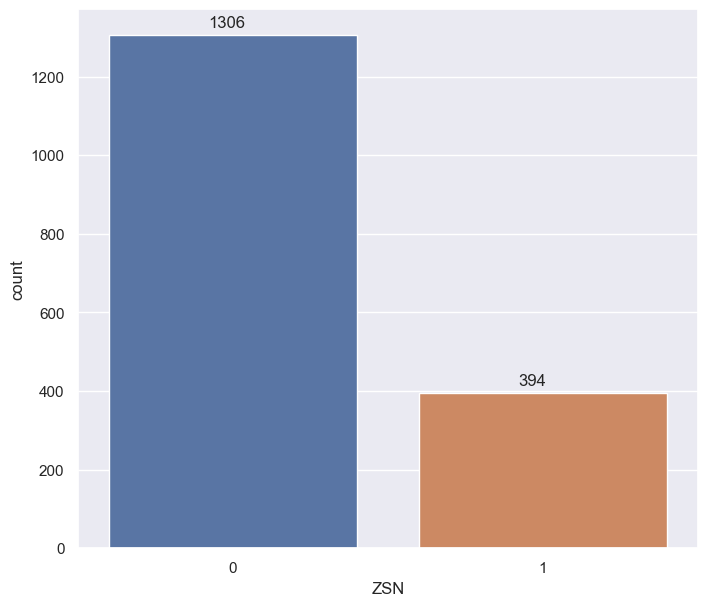

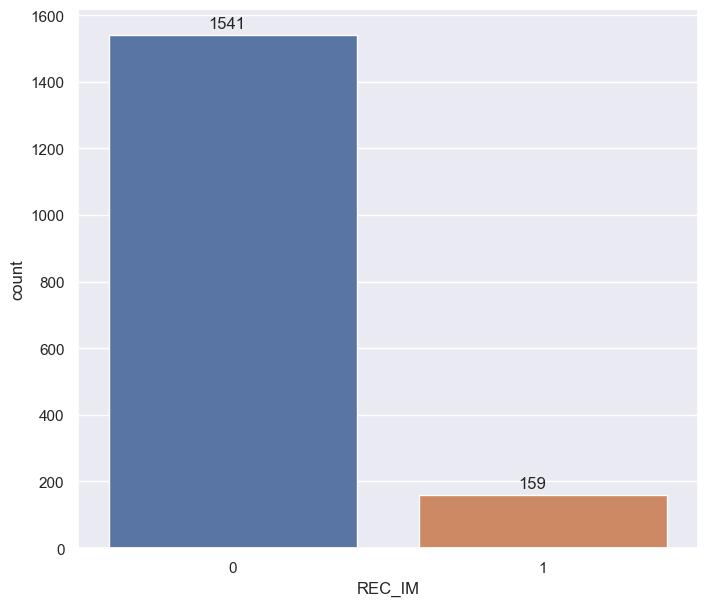

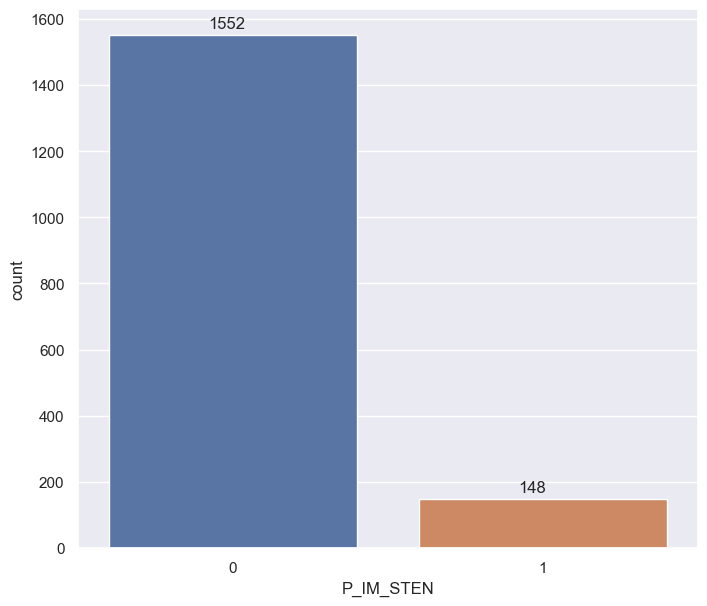

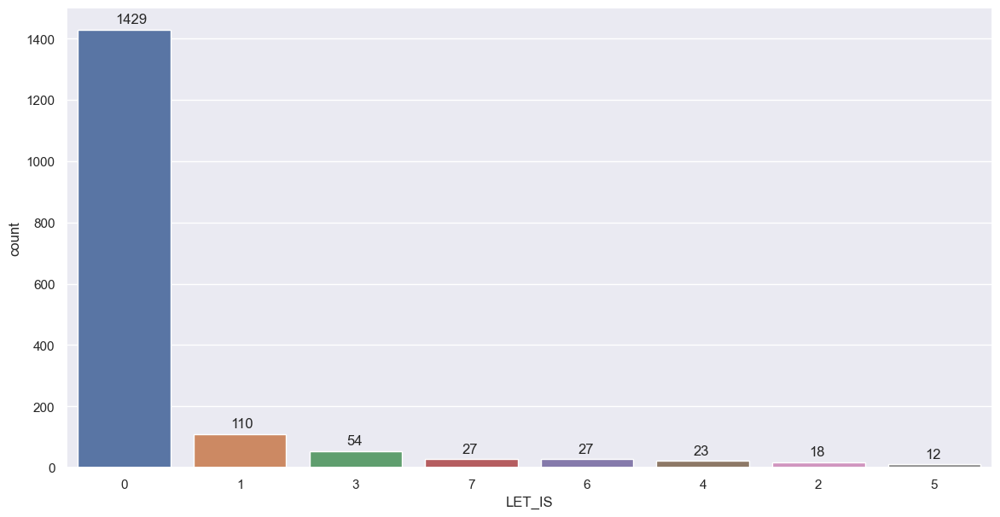

In [134]:
univariate(df=df,col='AGE',vartype=1)

In [135]:
#ok now let me check all the distribution and there outliers
'''
import warnings
warnings.filterwarnings('ignore')
for col in z.index:
    plt.figure(figsize=(15,5),facecolor='lightgrey')
   axes=plt.axes()
    axes.set_facecolor('lightgrey')
    sns.scatterplot(df[col],label='skewness:'+ str(np.round(df[col].skew(),2)),ax=axes)'''

"\nimport warnings\nwarnings.filterwarnings('ignore')\nfor col in z.index:\n    plt.figure(figsize=(15,5),facecolor='lightgrey')\n   axes=plt.axes()\n    axes.set_facecolor('lightgrey')\n    sns.scatterplot(df[col],label='skewness:'+ str(np.round(df[col].skew(),2)),ax=axes)"

In [136]:
new_df=df.copy()

In [137]:
new_df=new_df.reset_index()

In [138]:
new_df=new_df.drop('ID',axis=1)
new_df

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,77.0,1,2.0,1.0,1.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2,52.0,1,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,68.0,0,0.0,0.0,0.0,2.0,2.0,0.0,3.0,1.0,...,0,0,0,0,0,0,1,0,0,0
4,60.0,1,0.0,0.0,0.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,77.0,0,0.0,4.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,1,0,1,0,0,0,0,3
1696,70.0,0,0.0,6.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,1
1697,55.0,1,3.0,6.0,2.0,2.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,1,0,6
1698,79.0,0,2.0,2.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,1,0,0,0,0,0,1


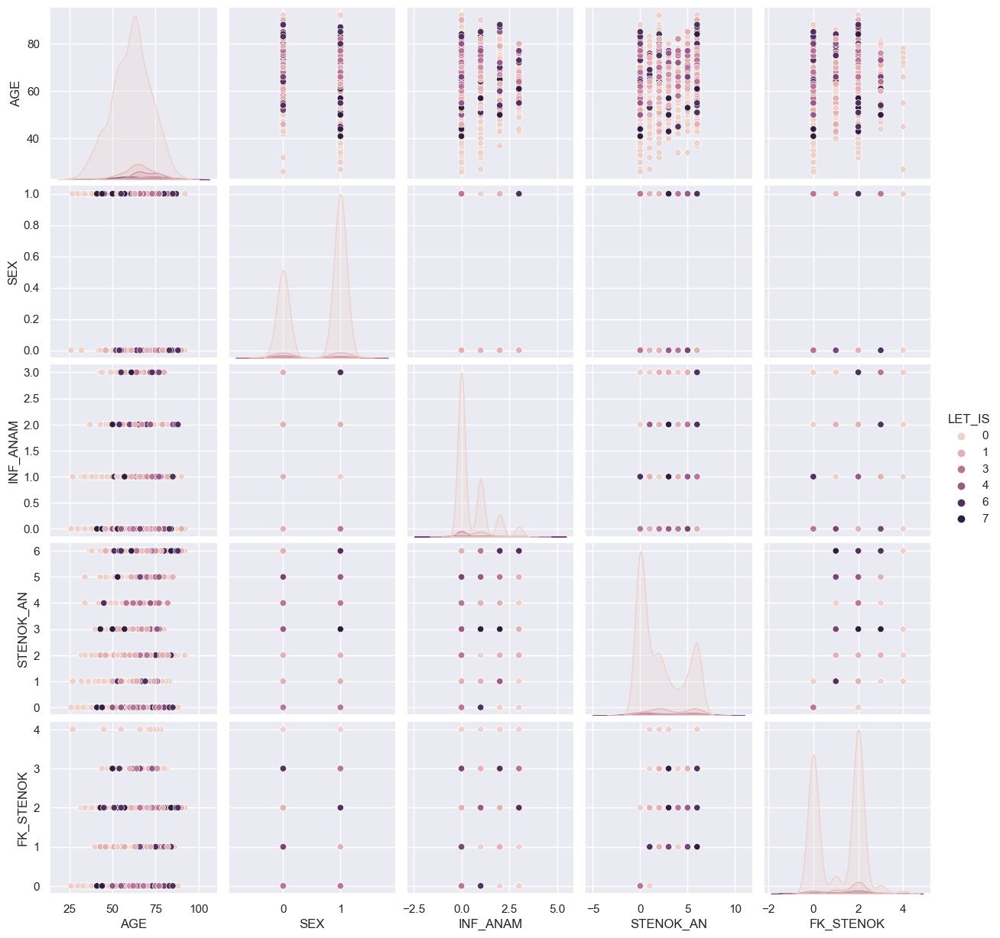

In [139]:
sns.pairplot(data = new_df,vars=['AGE','SEX','INF_ANAM','STENOK_AN','FK_STENOK'],hue='LET_IS')
plt.show()

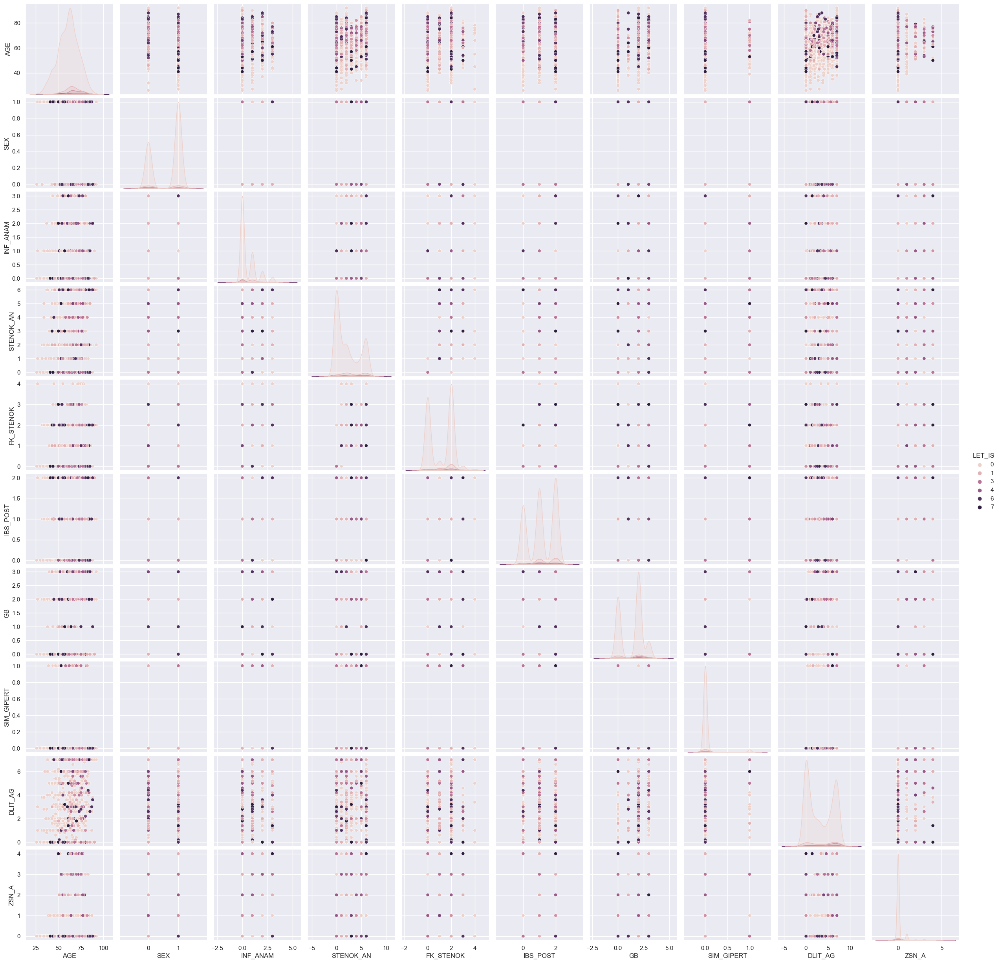

In [140]:
a1=new_df.iloc[:,:10]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

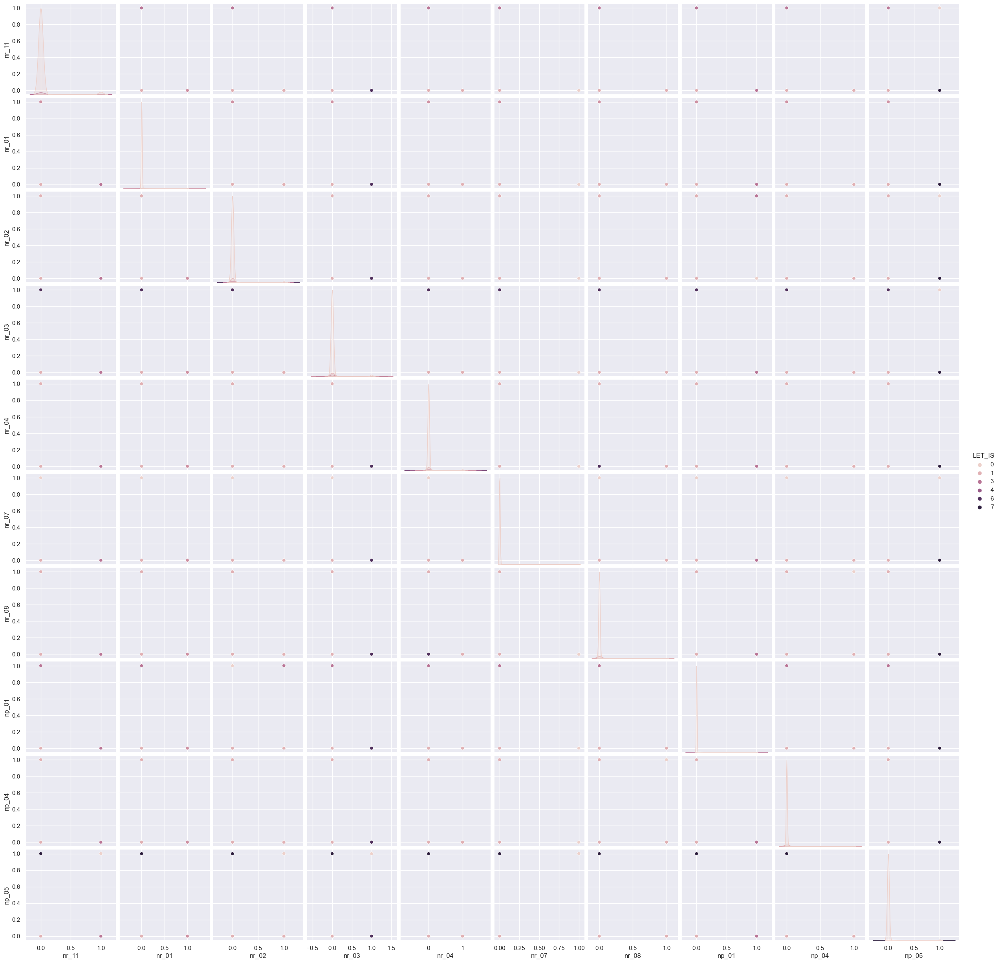

In [141]:
a1=new_df.iloc[:,10:20]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

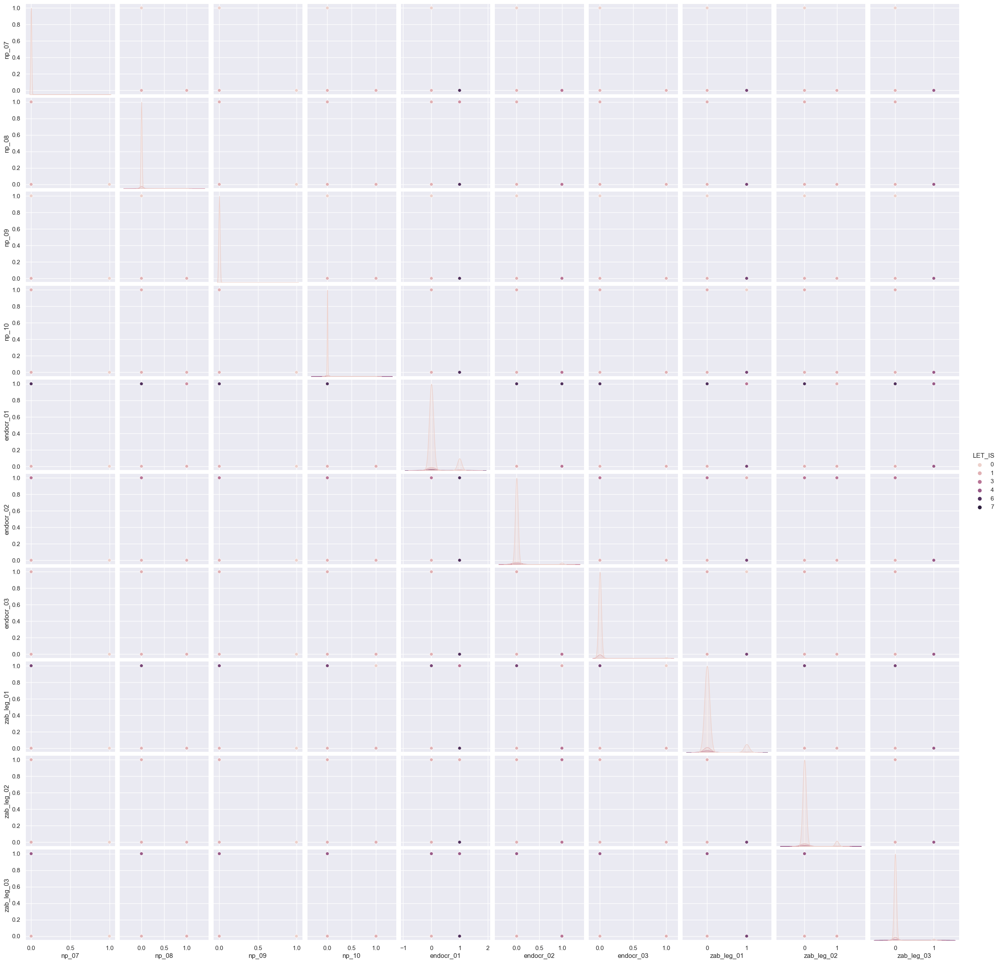

In [142]:
a1=new_df.iloc[:,20:30]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

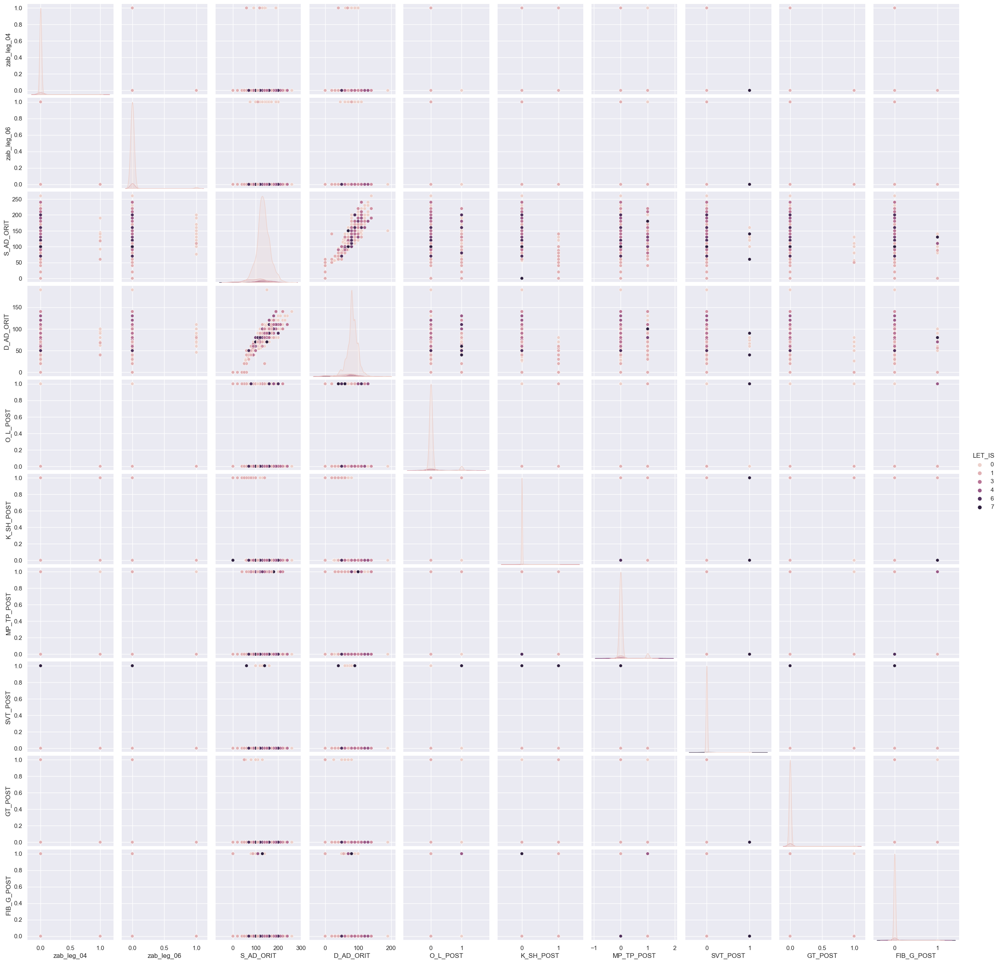

In [143]:
a1=new_df.iloc[:,30:40]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

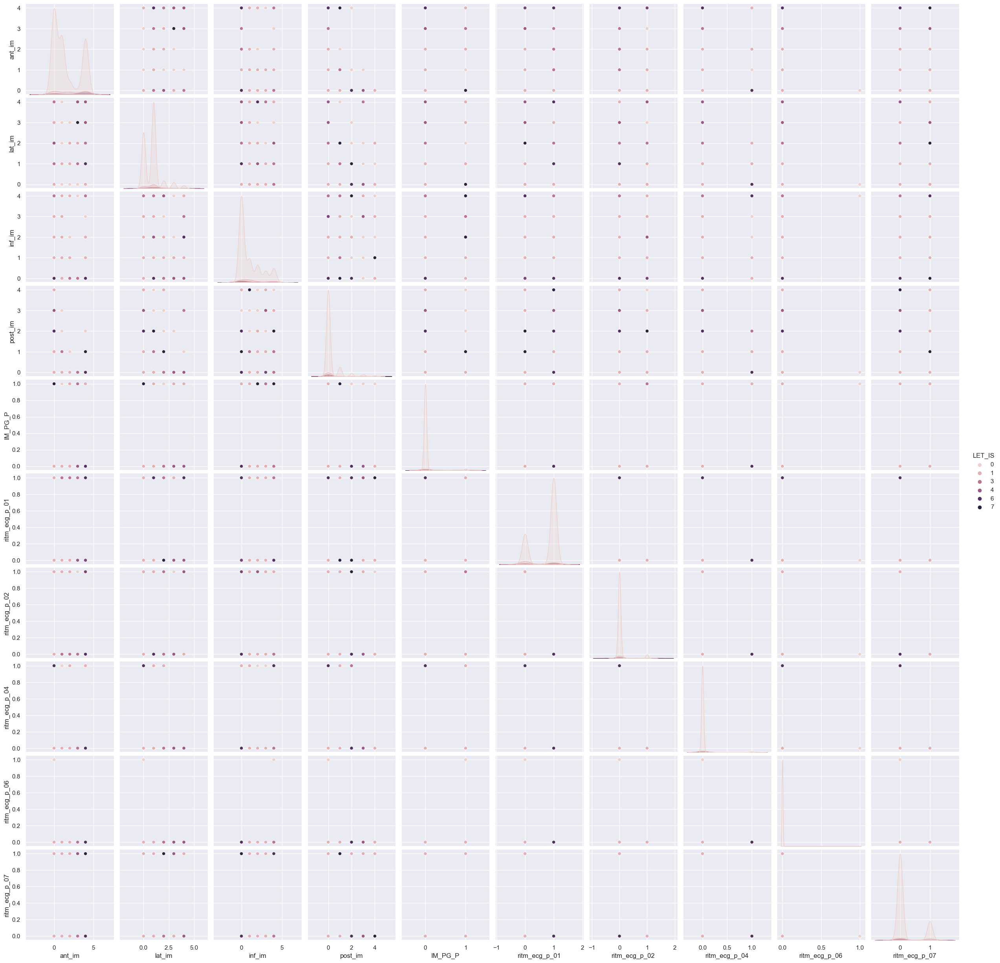

In [144]:
a1=new_df.iloc[:,40:50]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

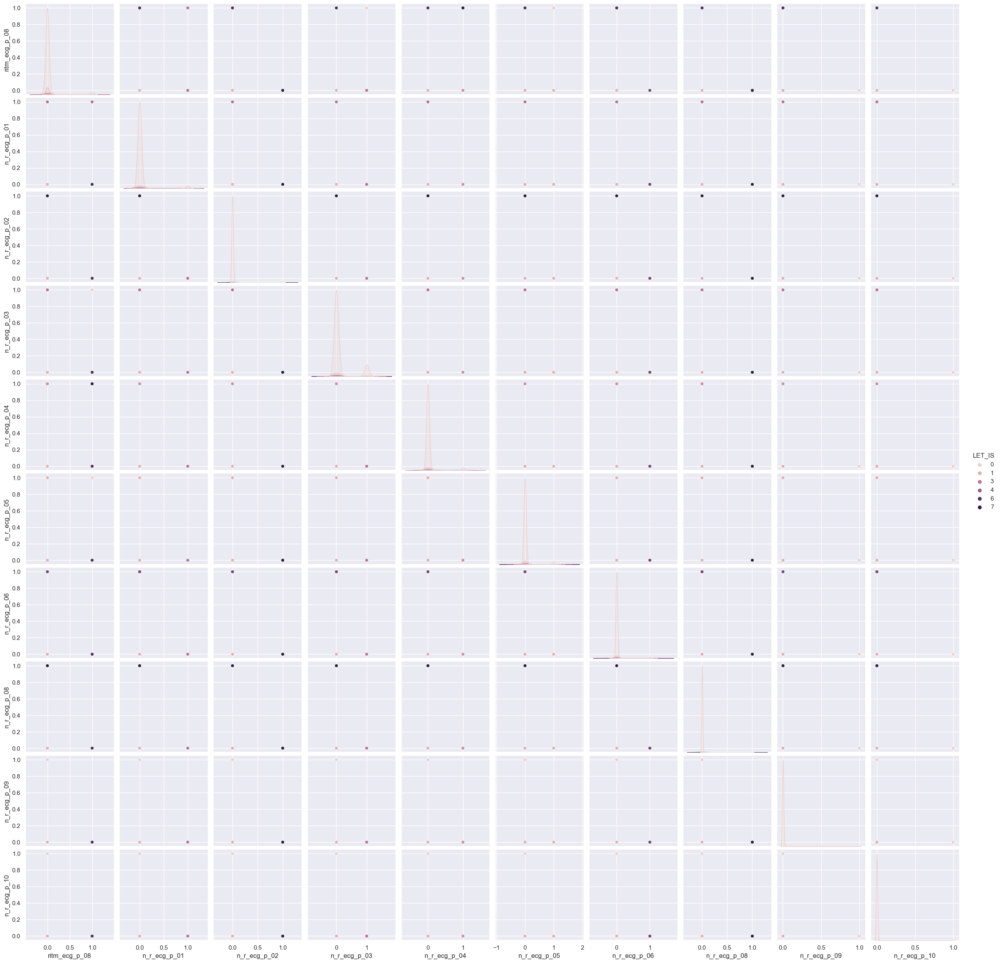

In [145]:
a1=new_df.iloc[:,50:60]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

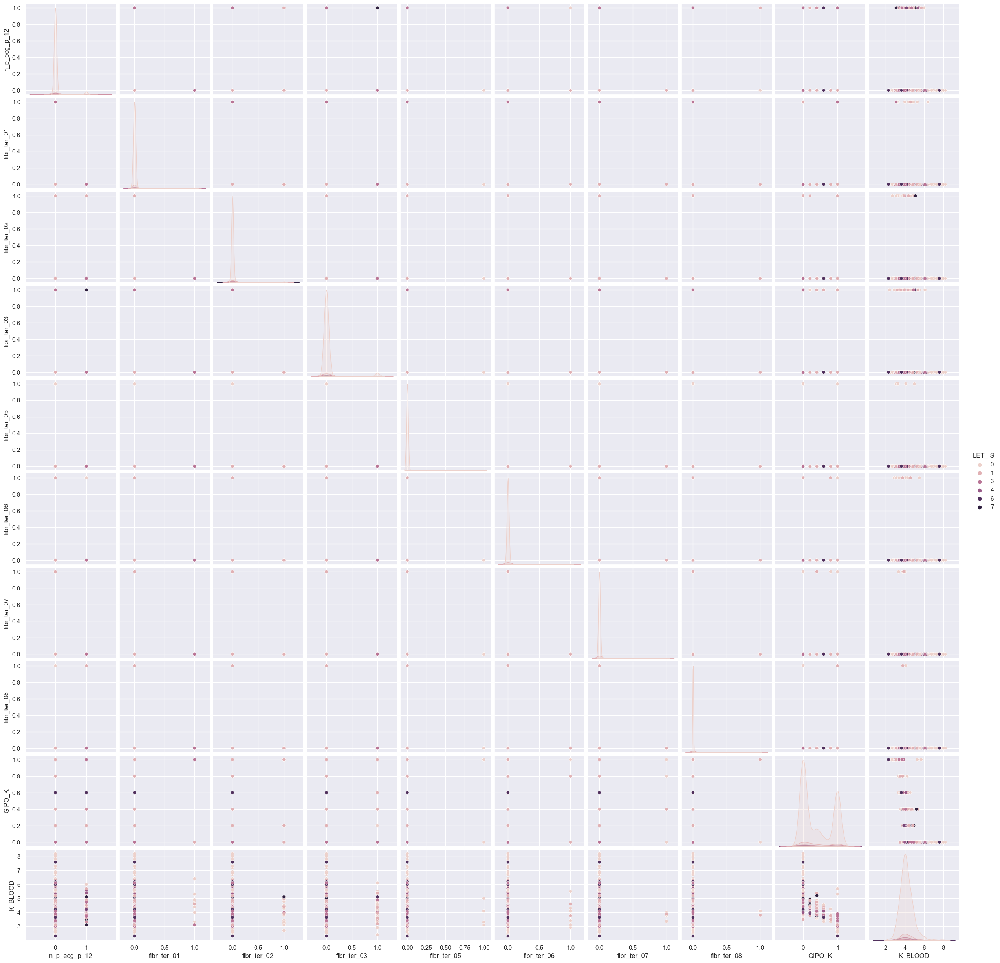

In [146]:
a1=new_df.iloc[:,70:80]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

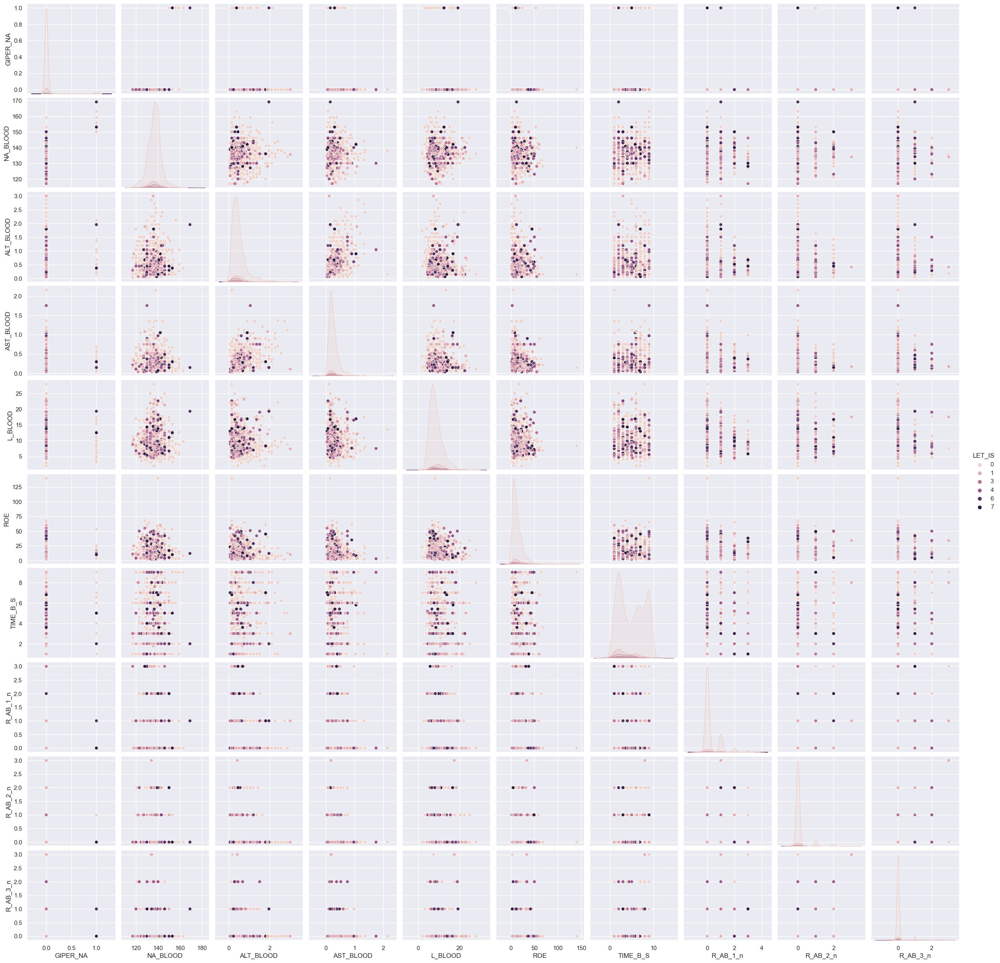

In [147]:
a1=new_df.iloc[:,80:90]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

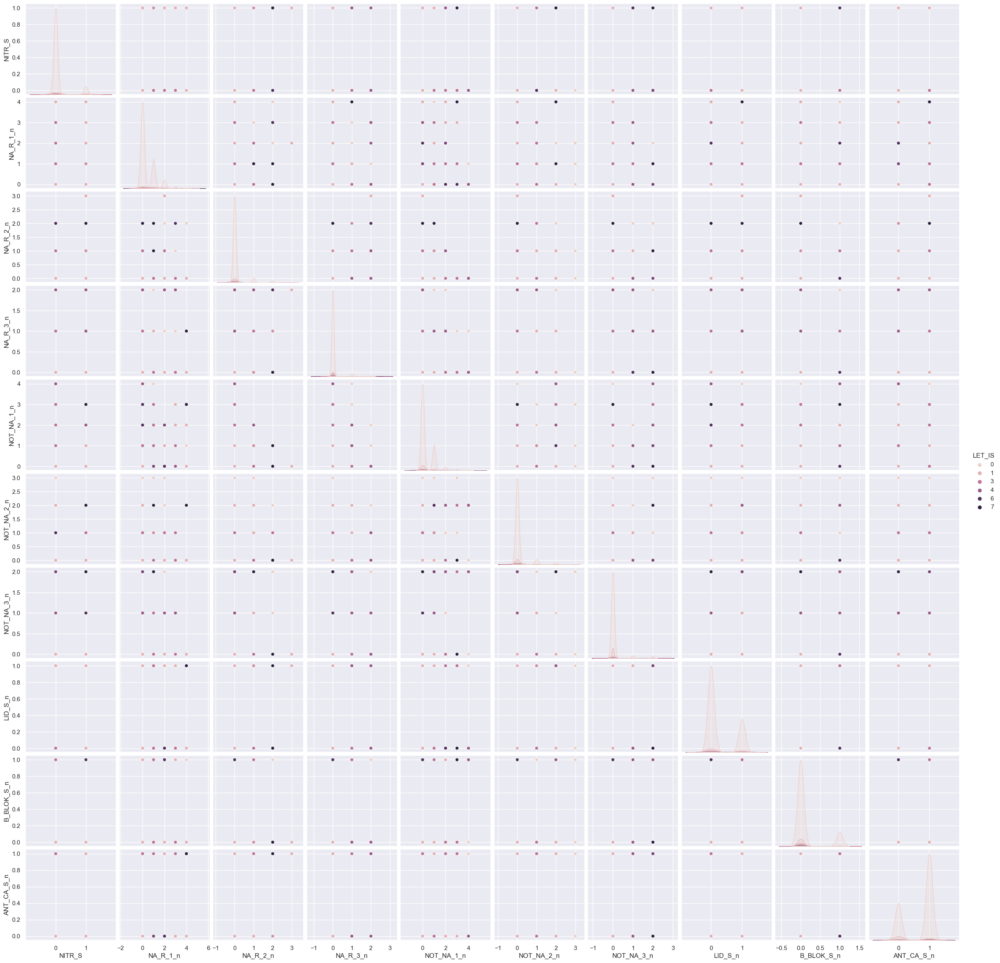

In [148]:
a1=new_df.iloc[:,90:100]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

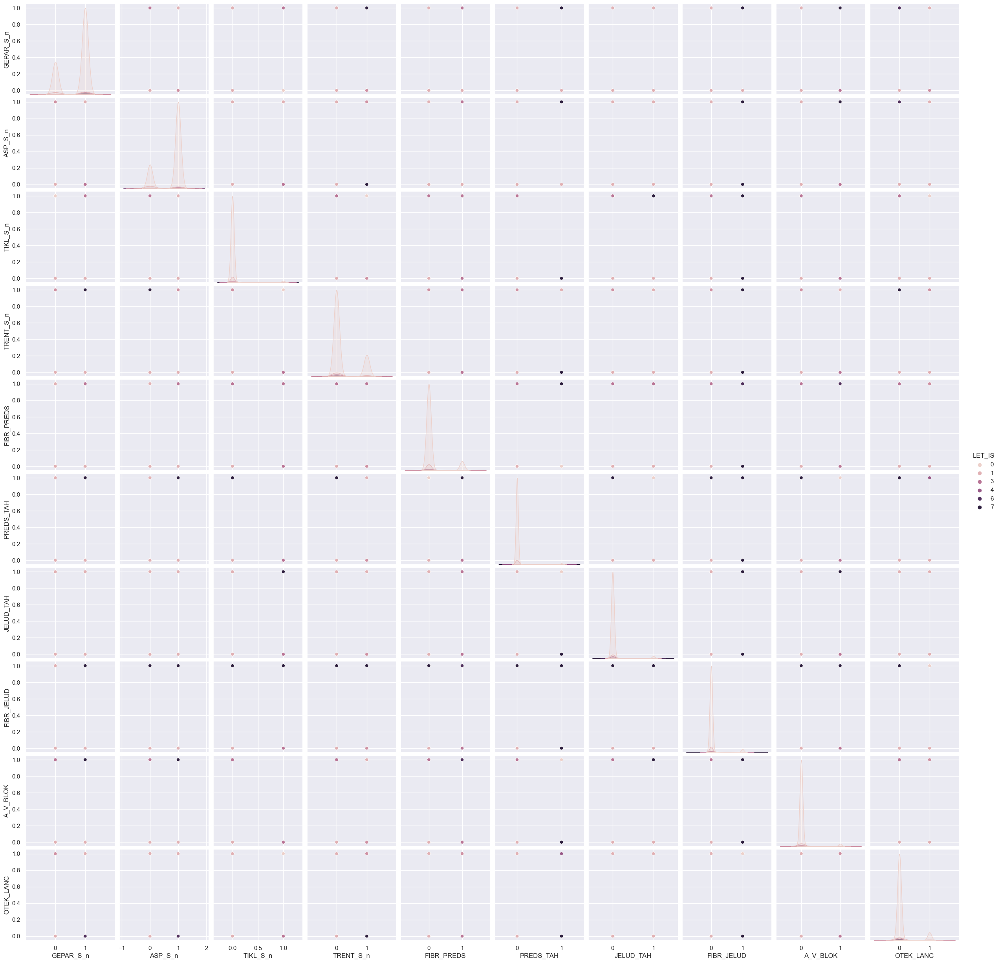

In [149]:
a1=new_df.iloc[:,100:110]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

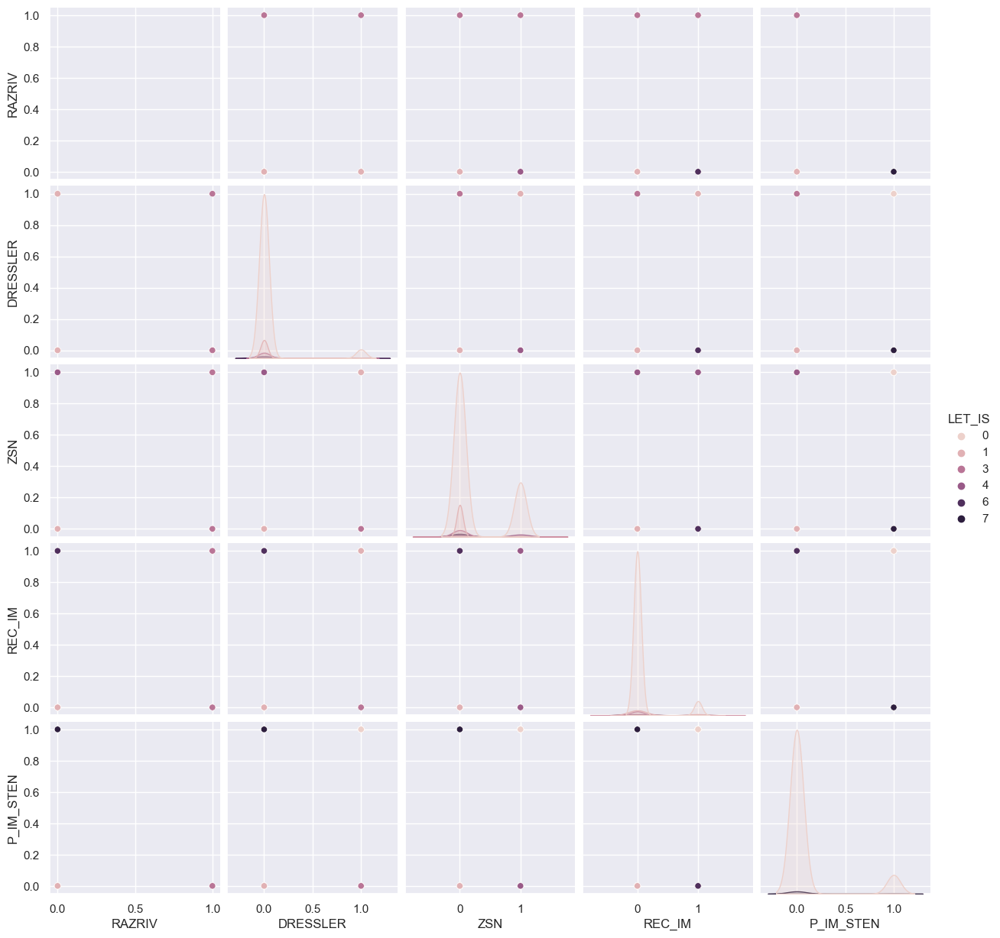

In [150]:
a1=new_df.iloc[:,110:115]
sns.pairplot(data = new_df,vars=a1,hue='LET_IS')
plt.show()

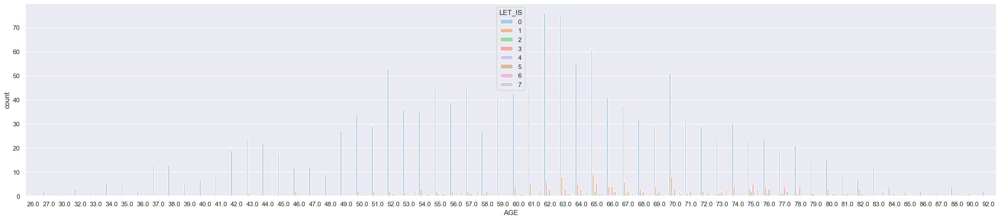

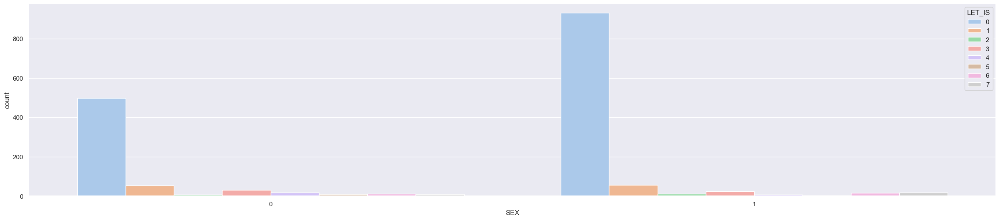

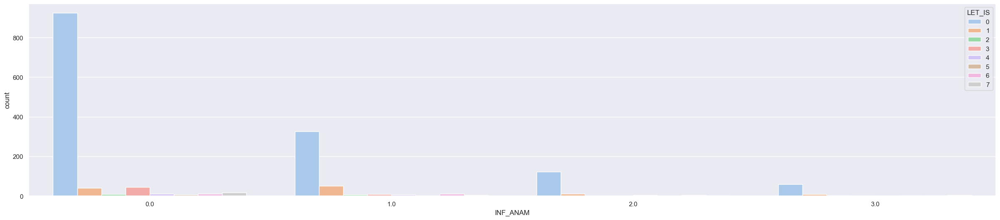

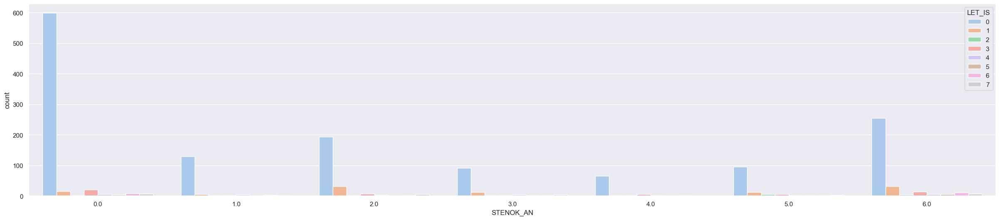

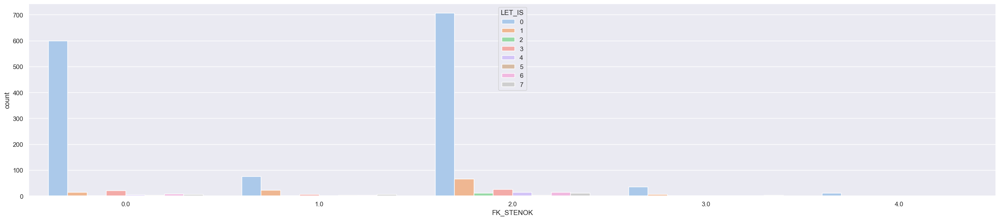

...

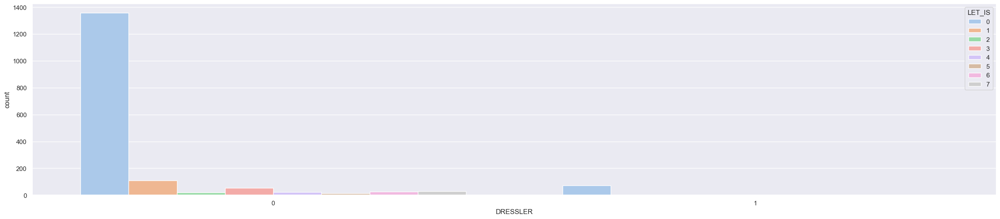

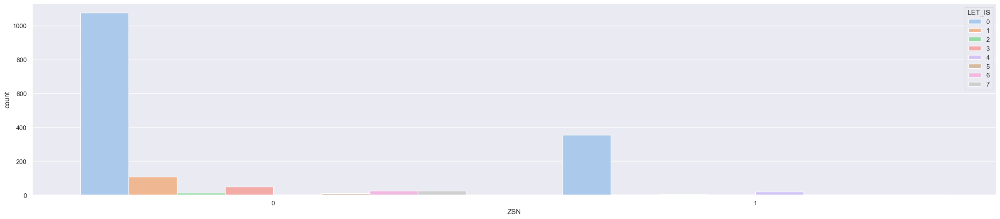

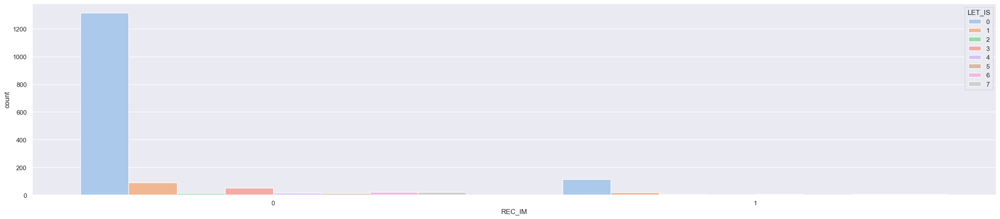

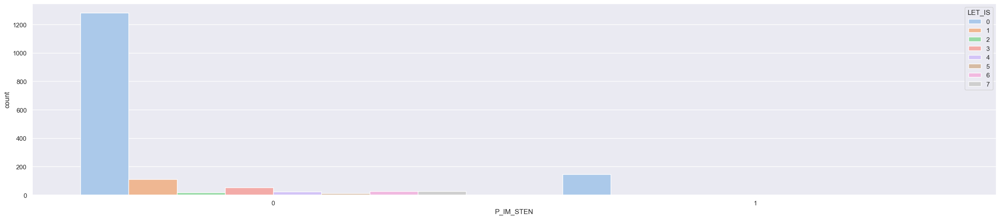

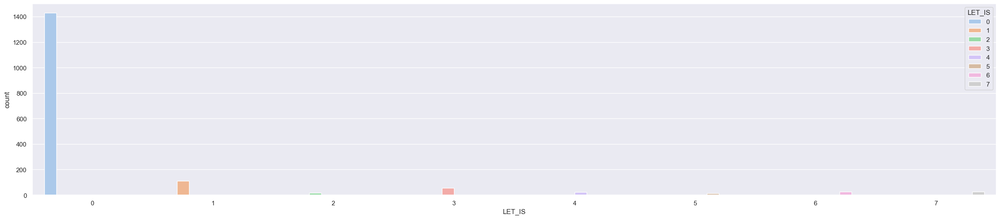

In [151]:
for col in df.columns:
    plt.figure(figsize = (30, 6))
    sns.countplot(x=col, hue="LET_IS", data=df, palette="pastel")
    plt.show()

<AxesSubplot:>

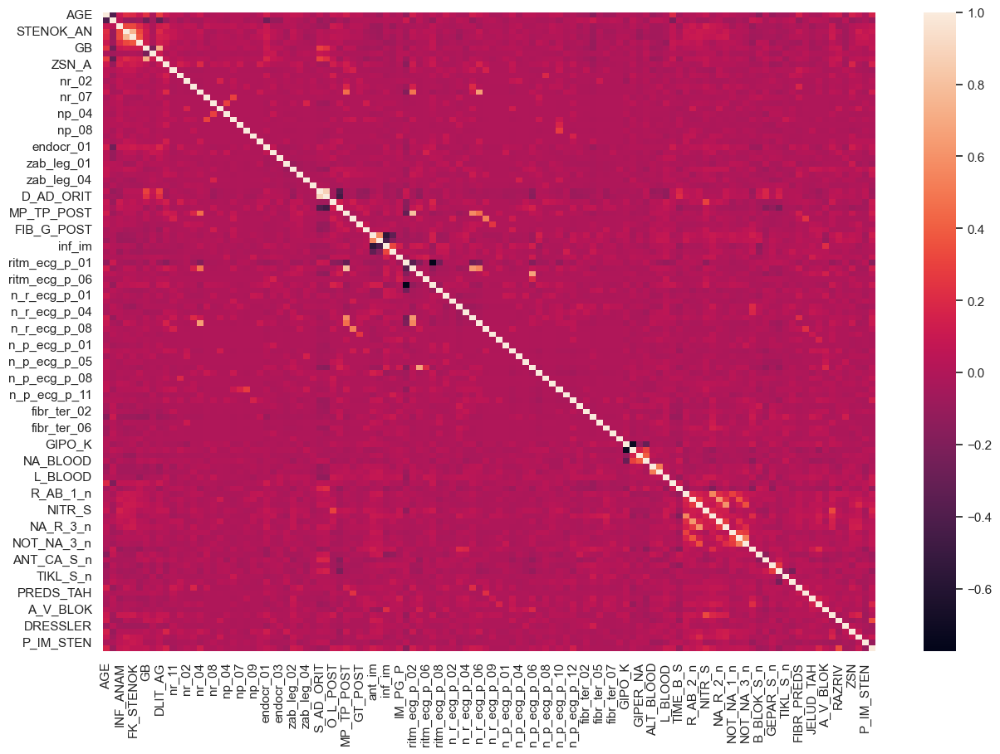

In [152]:
plt.figure(figsize=(15,10))
sns.heatmap(df.corr())

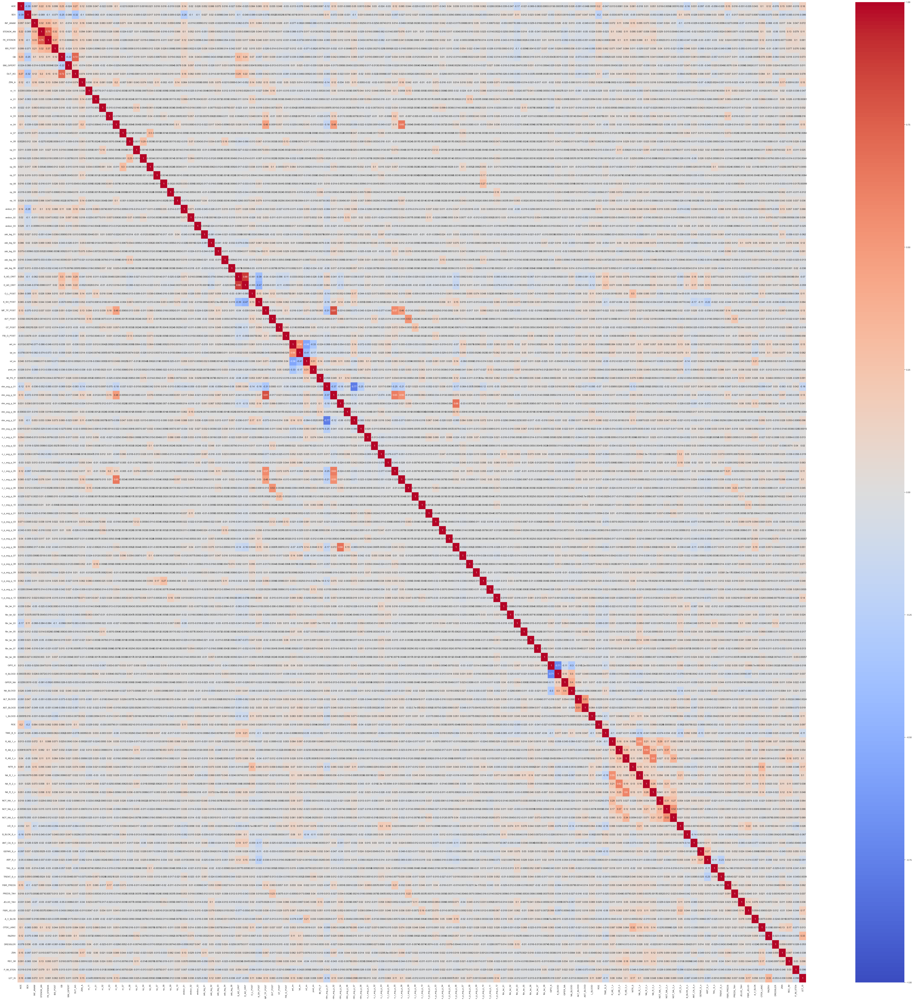

In [153]:
plt.figure(figsize = (90,90))
sns.heatmap(df.corr(), vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')
plt.show()

In [154]:
df.corr()

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
AGE,1.000000,-0.393430,0.097355,0.221790,0.190883,0.099365,0.234013,-0.024118,0.274254,0.120325,...,-0.030714,-0.034534,0.042516,0.104632,0.124456,-0.077624,0.145746,0.090961,-0.018753,0.157756
SEX,-0.393430,1.000000,0.040714,-0.088865,-0.104133,-0.070871,-0.254858,-0.065584,-0.315875,-0.100206,...,0.044560,0.027478,0.008722,-0.065186,-0.075090,0.035616,-0.097490,-0.065186,-0.016035,-0.086326
INF_ANAM,0.097355,0.040714,1.000000,0.320306,0.325598,0.207414,0.100018,-0.014408,0.123917,0.158477,...,-0.069579,-0.019235,-0.018317,0.093331,-0.068291,-0.050347,0.016649,0.040157,0.046754,0.072433
STENOK_AN,0.221790,-0.088865,0.320306,1.000000,0.751377,0.322583,0.128062,-0.020596,0.197839,0.093628,...,-0.029581,0.003670,0.009817,0.103296,0.029786,-0.059664,0.014856,0.128081,0.078669,0.106928
FK_STENOK,0.190883,-0.104133,0.325598,0.751377,1.000000,0.373663,0.114499,-0.000638,0.150618,0.129144,...,-0.026975,0.008805,-0.023091,0.116525,-0.011884,-0.061113,0.007650,0.092729,0.100198,0.061302
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
DRESSLER,-0.077624,0.035616,-0.050347,-0.059664,-0.061113,-0.060557,-0.064197,0.023635,-0.042568,-0.053493,...,0.039620,0.012424,-0.024103,-0.000145,-0.022579,1.000000,0.058501,0.009693,-0.025700,-0.053456
ZSN,0.145746,-0.097490,0.016649,0.014856,0.007650,0.015154,0.042203,-0.001631,0.036492,0.169371,...,0.011369,-0.010141,-0.001631,0.125196,-0.067689,0.058501,1.000000,0.086894,-0.045993,-0.038309
REC_IM,0.090961,-0.065186,0.040157,0.128081,0.092729,0.077313,0.018236,0.007506,0.056099,-0.009121,...,0.052993,0.044024,0.007506,0.174350,-0.023622,0.009693,0.086894,1.000000,0.029793,0.098199
P_IM_STEN,-0.018753,-0.016035,0.046754,0.078669,0.100198,0.076454,-0.013246,-0.011155,0.043252,-0.050996,...,-0.035708,-0.043609,-0.057518,-0.070530,-0.055933,-0.025700,-0.045993,0.029793,1.000000,-0.096070


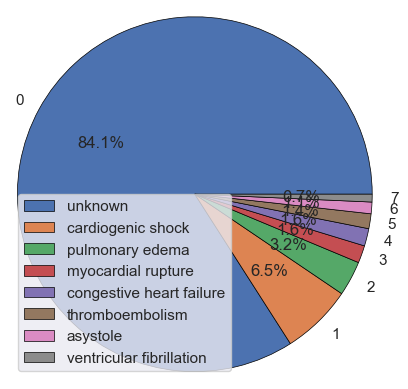

In [155]:
wp = { 'linewidth' : 0.5, 'edgecolor' : "black" }
def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%".format(pct, absolute)
s=df.LET_IS.value_counts()
label=[0,1,2,3,4,5,6,7]
plt.pie(s,autopct = lambda pct: func(pct, df['LET_IS']),labels=label,wedgeprops = wp,radius=1.2);
plt.legend(['unknown','cardiogenic shock','pulmonary edema','myocardial rupture','congestive heart failure','thromboembolism','asystole','ventricular fibrillation'],loc='lower left')

In [156]:
#Information Gain

from sklearn.feature_selection import mutual_info_classif

x=new_df.iloc[:,:-1]
y=new_df.iloc[:,-1]
x

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,77.0,1,2.0,1.0,1.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2,52.0,1,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,68.0,0,0.0,0.0,0.0,2.0,2.0,0.0,3.0,1.0,...,0,0,0,0,0,0,0,1,0,0
4,60.0,1,0.0,0.0,0.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,77.0,0,0.0,4.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,1,0,1,0,0,0,0
1696,70.0,0,0.0,6.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1697,55.0,1,3.0,6.0,2.0,2.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,1,0
1698,79.0,0,2.0,2.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,0,1,0,0,0,0,0


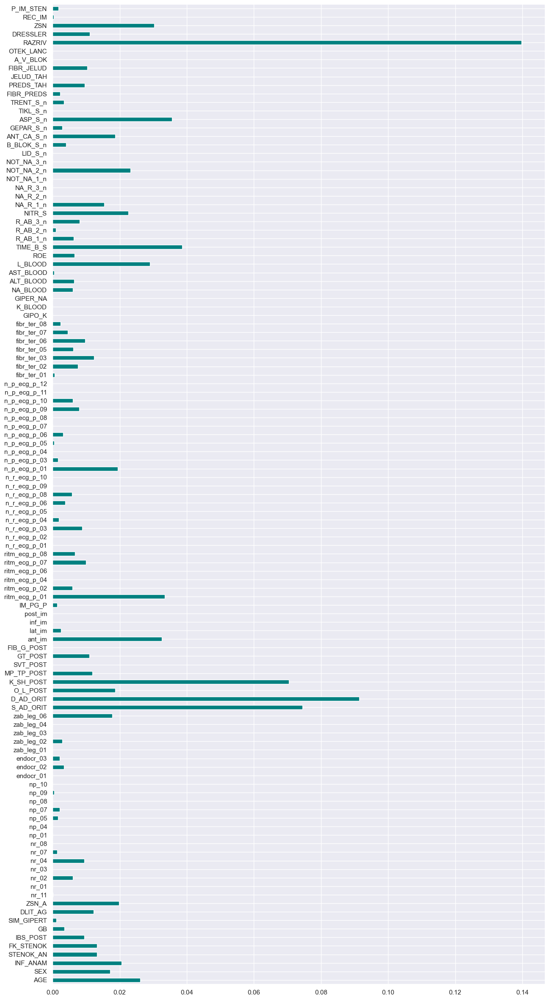

In [157]:
plt.figure(figsize=(15,30))
importance=mutual_info_classif(x,y)
feat_imp=pd.Series(importance,df.columns[0:len(df.columns)-1])
feat_imp.plot(kind='barh',color='teal')
plt.show()

In [158]:
dict(feat_imp)

{'AGE': 0.026081954516395278,
 'SEX': 0.017081397924758157,
 'INF_ANAM': 0.020603609215052776,
 'STENOK_AN': 0.013231587394868516,
 'FK_STENOK': 0.013191615078315788,
 'IBS_POST': 0.009439676101230532,
 'GB': 0.00347675527597735,
 'SIM_GIPERT': 0.0011563515940076208,
 'DLIT_AG': 0.012193281145487234,
 'ZSN_A': 0.01981856107620006,
 'nr_11': 7.409766958743624e-05,
 'nr_01': 0.0,
 'nr_02': 0.0060484882716058674,
 'nr_03': 0.0,
 'nr_04': 0.009384006192930006,
 'nr_07': 0.0013092128043141749,
 'nr_08': 0.0,
 'np_01': 0.0,
 'np_04': 0.0,
 'np_05': 0.0016477813381101658,
 'np_07': 0.0021345172587092787,
 'np_08': 0.0,
 'np_09': 0.00041444255364941895,
 'np_10': 0.0,
 'endocr_01': 0.0,
 'endocr_02': 0.003410549524298201,
 'endocr_03': 0.002147429839950643,
 'zab_leg_01': 0.0,
 'zab_leg_02': 0.0029233849074079554,
 'zab_leg_03': 0.0,
 'zab_leg_04': 0.0,
 'zab_leg_06': 0.01770958807529488,
 'S_AD_ORIT': 0.07441329569280342,
 'D_AD_ORIT': 0.09136199994509475,
 'O_L_POST': 0.018669478103146675,
 

In [159]:
print(f'number of feature which as zero importance {len(feat_imp[feat_imp==0])}')

number of feature which as zero importance 39


In [160]:
#Chi-square Test

from sklearn.feature_selection import SelectKBest,chi2
chi2_feature=SelectKBest(chi2)
X_kbest_feat=chi2_feature.fit_transform(x,y)

In [161]:
X_kbest_feat

array([[77.,  1.,  0., ...,  0.,  0.,  0.],
       [55.,  0.,  0., ...,  0.,  0.,  0.],
       [52.,  0.,  0., ...,  0.,  0.,  0.],
       ...,
       [55.,  6.,  0., ...,  1.,  0.,  0.],
       [79.,  2.,  0., ...,  1.,  0.,  0.],
       [63.,  2.,  4., ...,  1.,  0.,  0.]])

In [162]:
##Recursive Feature Elimination
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

model = LogisticRegression(max_iter=400)
rfe = RFE(model)
fit = rfe.fit(x,y)
print(fit.ranking_)

[46  1  4 24 23  1 38  9 41  1  1  1  1  1  1 59 50 44 40  1 58 14 56 34
  1  1  6  1  1  1 29 20 52 49  1  1  1  1  5  1 18  1 19  1  1 30  1 32
 37  3  1  1 13  1  1  1  1 39 55 53 48  1  1 57  1  1 25 28 26 21  1 43
 31 27 35 16 54  1  1  1  8 47  1  1 45 51 42 36  2  1  1 22 12 17 33  1
  1  7  1  1  1  1  1 15 11  1  1  1 10  1  1  1  1  1  1]


In [163]:
c=pd.Series(fit.feature_names_in_)

In [164]:
ranking = pd.Series(fit.ranking_)
ranking

0      46
1       1
2       4
3      24
4      23
       ..
110     1
111     1
112     1
113     1
114     1
Length: 115, dtype: int32

In [165]:
len(ranking[ranking==1])

57

In [166]:
len(ranking[ranking==4])

1

In [167]:
m=pd.DataFrame(ranking.values,c).tail(50).rename({0:'Ranking'}, axis = 1)

In [168]:
Y = pd.DataFrame(fit.ranking_).T
Y.columns= x.columns
Y

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,46,1,4,24,23,1,38,9,41,1,...,1,1,1,10,1,1,1,1,1,1


In [169]:
# Filter columns with non-zero values
rank_one_cols = Y.columns[(Y <= 1).any(axis=0)]
Y[rank_one_cols]

,SEX,IBS_POST,ZSN_A,nr_11,nr_01,nr_02,nr_03,nr_04,np_05,endocr_01,...,TIKL_S_n,PREDS_TAH,JELUD_TAH,FIBR_JELUD,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


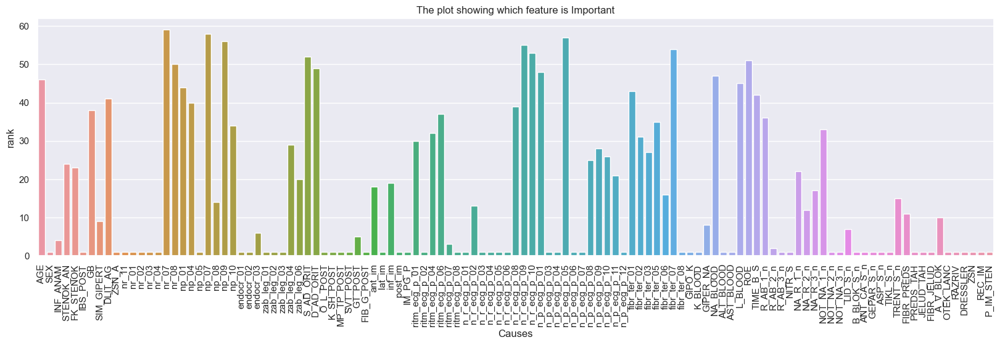

In [170]:
plt.figure(figsize=(20,5))
sns.barplot(data=Y)
plt.title('The plot showing which feature is Important')
plt.xlabel('Causes')
plt.ylabel('rank')
plt.xticks(rotation=90)
plt.show()

In [171]:
a=pd.Series(fit.ranking_)
b=pd.Series(new_df.columns)

In [172]:
d=pd.concat([a, b], axis=1).rename({1:'Ranking'}, axis = 1)
d

,0,Ranking
0,46.0,AGE
1,1.0,SEX
2,4.0,INF_ANAM
3,24.0,STENOK_AN
4,23.0,FK_STENOK
...,...,...
111,1.0,DRESSLER
112,1.0,ZSN
113,1.0,REC_IM
114,1.0,P_IM_STEN


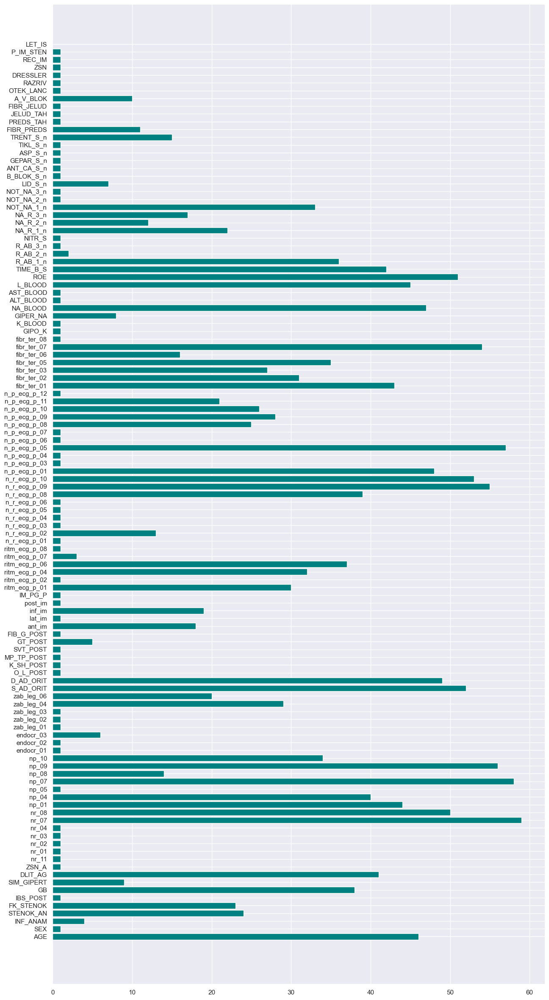

In [173]:
plt.figure(figsize=(15,30))
plt.barh(d['Ranking'],d[0],color='teal');
plt.show()

In [174]:
#Decision Tree
from sklearn.tree import DecisionTreeClassifier
model = DecisionTreeClassifier()
model.fit(x,y)
print(model.feature_importances_)

[0.03118122 0.00482505 0.00268711 0.01311361 0.00909136 0.01911612
 0.00450448 0.00589754 0.00477631 0.01071277 0.         0.
 0.0036238  0.         0.00416572 0.         0.         0.
 0.         0.         0.         0.00364682 0.         0.
 0.00828543 0.00361014 0.00384223 0.         0.00554687 0.00844074
 0.         0.         0.03446353 0.02055819 0.00818253 0.12834227
 0.         0.         0.         0.         0.00843285 0.0171412
 0.0055732  0.0057998  0.00499713 0.00549822 0.00204699 0.
 0.         0.         0.         0.00597226 0.         0.00513298
 0.00756057 0.         0.         0.         0.         0.
 0.         0.         0.00194586 0.         0.00543538 0.00606344
 0.         0.         0.00165792 0.         0.00975262 0.00342503
 0.         0.00341165 0.         0.         0.         0.00193659
 0.02192735 0.02637939 0.         0.01869097 0.02397813 0.04594505
 0.02608286 0.02152666 0.01191981 0.01906446 0.         0.01730583
 0.01928842 0.02178529 0.00749684 0.

In [175]:
X = pd.DataFrame(model.feature_importances_).T
X.columns = x.columns
X

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.031181,0.004825,0.002687,0.013114,0.009091,0.019116,0.004504,0.005898,0.004776,0.010713,...,0.0,0.0,0.009263,0.002093,0.015912,0.188268,0.0,0.009936,0.012961,0.0


In [176]:
# Filter columns with non-zero values
non_zero_cols = X.columns[(X != 0).any(axis=0)]
X[non_zero_cols]

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,GEPAR_S_n,ASP_S_n,TRENT_S_n,FIBR_PREDS,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,ZSN,REC_IM
0,0.031181,0.004825,0.002687,0.013114,0.009091,0.019116,0.004504,0.005898,0.004776,0.010713,...,0.012501,0.002047,0.005239,0.006043,0.009263,0.002093,0.015912,0.188268,0.009936,0.012961


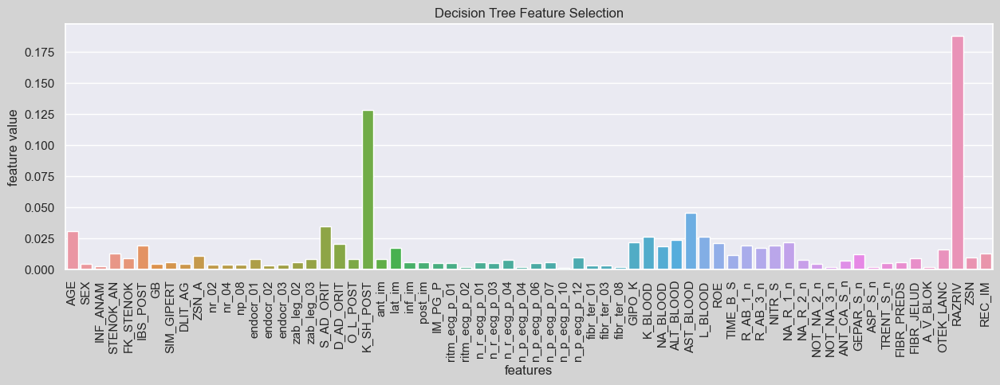

In [177]:
plt.figure(figsize=(15,4), facecolor='lightgray')
sns.barplot(data=X[non_zero_cols])
plt.title('Decision Tree Feature Selection')
plt.xlabel('features')
plt.ylabel('feature value')
plt.xticks(rotation=90)
plt.show()

In [178]:
a=pd.Series(model.feature_importances_)
b=pd.Series(new_df.columns)
d=pd.concat([b, a], axis=1).rename({1:'Score'}, axis = 1)
d

,0,Score
0,AGE,0.031181
1,SEX,0.004825
2,INF_ANAM,0.002687
3,STENOK_AN,0.013114
4,FK_STENOK,0.009091
...,...,...
111,DRESSLER,0.000000
112,ZSN,0.009936
113,REC_IM,0.012961
114,P_IM_STEN,0.000000


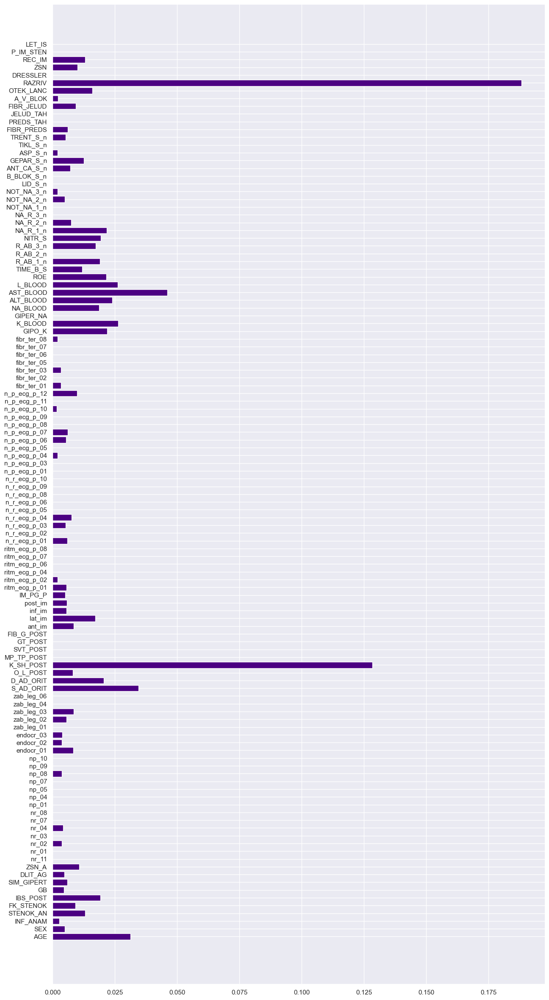

In [179]:
plt.figure(figsize=(15,30))
plt.barh(d[0],d['Score'],color='indigo');
plt.show()

In [180]:
print(f'number of feature which as zero importance {len(model.feature_importances_[model.feature_importances_==0])}')

number of feature which as zero importance 49


In [181]:
# Univariate Feature Selection
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
from numpy import set_printoptions
test = SelectKBest(score_func=chi2, k=5)
fit = test.fit(x,y)
set_printoptions(precision=4)
print(fit.scores_)

[1.7705e+02 1.5103e+01 5.3583e+01 1.0786e+02 2.6262e+01 1.2825e+01
 1.7562e+01 9.3759e+00 6.8211e+01 2.5098e+02 6.3636e+00 2.2288e+01
 4.1859e+00 1.2641e+01 5.3251e+01 1.8964e-01 2.5403e+00 1.4336e+01
 3.7377e+00 5.5388e+00 1.8964e-01 1.5489e+01 3.7929e-01 2.7186e+01
 2.6351e+01 2.0926e+01 1.3664e+00 7.8121e+00 3.4283e+01 2.3253e+01
 4.3456e+00 2.5494e+00 1.3071e+03 8.9822e+02 6.6848e+01 5.2173e+02
 5.2917e+01 2.8835e+01 1.2184e+00 1.8770e+01 8.7055e+01 2.8466e+01
 2.2934e+01 6.6960e+00 4.7915e+01 2.8353e+01 6.3689e+01 3.2429e+01
 1.8964e-01 4.2302e+01 3.2430e+00 4.9219e+00 7.1569e+00 5.7655e+00
 1.9753e+01 4.2575e+01 2.9869e+01 1.4417e+01 3.7929e-01 3.7929e-01
 3.7929e-01 1.9489e+01 9.5050e+00 6.3221e+00 4.2373e+01 3.5114e+00
 1.9770e+01 6.5505e+00 9.6211e+00 3.0374e+00 7.2336e+01 1.6833e+00
 7.5926e+00 5.1127e+00 7.5857e-01 4.3456e+00 1.5326e+00 6.3221e+00
 4.0624e+00 1.0135e+00 3.6210e+00 1.9603e+00 3.9169e+00 2.5689e+00
 6.1486e+01 2.2914e+02 8.8619e+01 3.2048e+01 7.1317e+00 8.7476

In [182]:
Z = pd.DataFrame(fit.scores_).T
Z.columns=x.columns
Z

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,177.046801,15.103094,53.583118,107.864458,26.261868,12.825086,17.562312,9.37589,68.211465,250.976114,...,12.288404,9.795939,130.651358,15.426511,68.011002,1646.0,8.693451,80.19351,40.340167,26.121357


In [183]:
# Checking is there any zero value
non_zero_cols = Z.columns[(Z != 0).any(axis=0)]
Z[non_zero_cols]

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,177.046801,15.103094,53.583118,107.864458,26.261868,12.825086,17.562312,9.37589,68.211465,250.976114,...,12.288404,9.795939,130.651358,15.426511,68.011002,1646.0,8.693451,80.19351,40.340167,26.121357


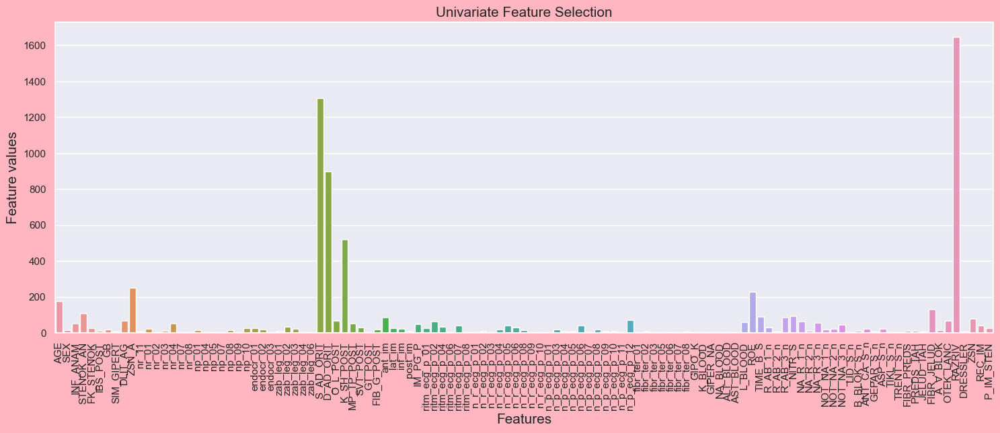

In [184]:
plt.figure(figsize=(18,6), facecolor='lightpink')
sns.barplot(data=Z)
plt.title('Univariate Feature Selection', size=15)
plt.xlabel('Features', size=15)
plt.ylabel('Feature values',size=15)
plt.xticks(rotation=90)
plt.show()

In [185]:
a=pd.Series(fit.scores_)
b=pd.Series(new_df.columns)
d=pd.concat([b, a], axis=1).rename({1:'Score'}, axis = 1)
d

,0,Score
0,AGE,177.046801
1,SEX,15.103094
2,INF_ANAM,53.583118
3,STENOK_AN,107.864458
4,FK_STENOK,26.261868
...,...,...
111,DRESSLER,8.693451
112,ZSN,80.193510
113,REC_IM,40.340167
114,P_IM_STEN,26.121357


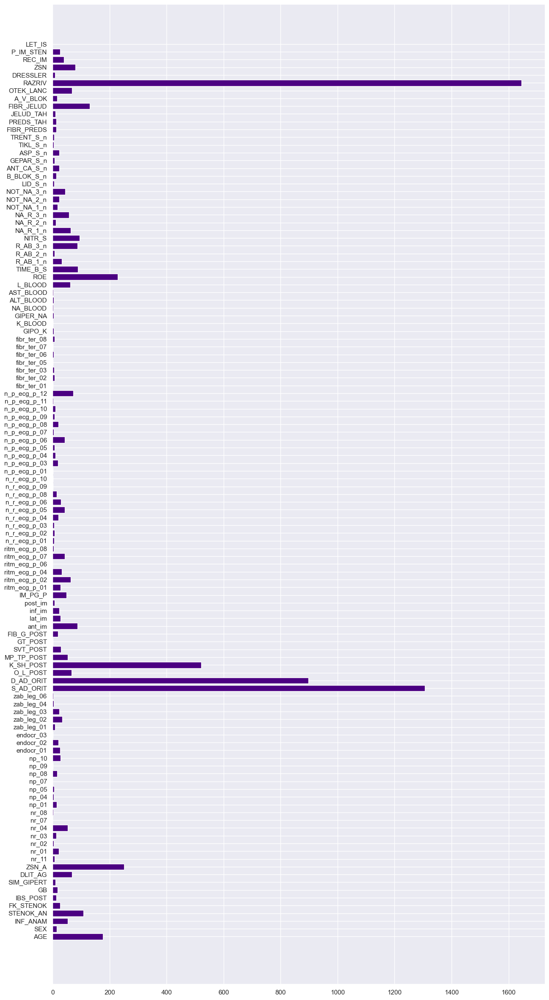

In [186]:
plt.figure(figsize=(15,30))
plt.barh(d[0],d['Score'],color='indigo');
plt.show()

Multi-class Classification: Classification tasks with more than two classes
    
Some algorithms are designed for binary classification problems. Examples include:

Logistic Regression
Support Vector Machines
Instead, heuristic methods can be used to split a multi-class classification problem into multiple binary classification datasets and train a binary classification model each.

Two examples of these heuristic methods include:

One-vs-Rest (OvR)
One-vs-One (OvO)

One-Vs-Rest (OvR) for Multi-Class Classification

One-vs-rest (OvR) for short, also referred to as One-vs-All (OvA) is a heuristic method for using binary classification algorithms for multi-class classification.

It involves splitting the multi-class dataset into multiple binary classification problems.

A binary classifier is then trained on each binary classification problem and predictions are made using the model that is the most confident.

Approach of OvA or OvR

The obvious approach is to use a one-versus-the-rest approach (also called one-vs-all), in which we train C binary classifiers, fc(x), where the data from class c is treated as positive, and the data from all the other classes is treated as negative.
This approach requires that each model predicts a class membership probability or a probability-like score. The argmax of these scores (class index with the largest score) is then used to predict a class.
This approach is commonly used for algorithms that naturally predict numerical class membership probability or score, such as: Logistic Regression.
As such, the implementation of these algorithms in the scikit-learn library implements the OvR strategy by default when using these algorithms for multi-class classification.


In [187]:
from sklearn.metrics import roc_curve, auc
def calculate_tpr_fpr(y_real, y_pred):
    '''
    Calculates the True Positive Rate (tpr) and the True Negative Rate (fpr) based on real and predicted observations
    
    Args:
        y_real: The list or series with the real classes
        y_pred: The list or series with the predicted classes
        
    Returns:
        tpr: The True Positive Rate of the classifier
        fpr: The False Positive Rate of the classifier
    '''
    
    # Calculates the confusion matrix and recover each element
    cm = confusion_matrix(y_real, y_pred)
    TN = cm[0, 0]
    FP = cm[0, 1]
    FN = cm[1, 0]
    TP = cm[1, 1]
    
    # Calculates tpr and fpr
    tpr =  TP/(TP + FN) # sensitivity - true positive rate
    fpr = 1 - TN/(TN+FP) # 1-specificity - false positive rate
    
    return tpr, fpr

In [188]:
def get_all_roc_coordinates(y_real, y_proba):
    '''
    Calculates all the ROC Curve coordinates (tpr and fpr) by considering each point as a threshold for the predicion of the class.
    
    Args:
        y_real: The list or series with the real classes.
        y_proba: The array with the probabilities for each class, obtained by using the `.predict_proba()` method.
        
    Returns:
        tpr_list: The list of TPRs representing each threshold.
        fpr_list: The list of FPRs representing each threshold.
    '''
    tpr_list = [0]
    fpr_list = [0]
    for i in range(len(y_proba)):
        threshold = y_proba[i]
        y_pred = y_proba >= threshold
        tpr, fpr = calculate_tpr_fpr(y_real, y_pred)
        tpr_list.append(tpr)
        fpr_list.append(fpr)
    return tpr_list, fpr_list

In [189]:
def plot_roc_curve(tpr, fpr, scatter = True, ax = None):
    '''
    Plots the ROC Curve by using the list of coordinates (tpr and fpr).
    
    Args:
        tpr: The list of TPRs representing each coordinate.
        fpr: The list of FPRs representing each coordinate.
        scatter: When True, the points used on the calculation will be plotted with the line (default = True).
    '''
    if ax == None:
        plt.figure(figsize = (5, 5))
        ax = plt.axes()
    
    if scatter:
        sns.scatterplot(x = fpr, y = tpr, ax = ax)
    sns.lineplot(x = fpr, y = tpr, ax = ax)
    sns.lineplot(x = [0, 1], y = [0, 1], color = 'green', ax = ax)
    plt.xlim(-0.05, 1.05)
    plt.ylim(-0.05, 1.05)
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")

In [190]:
# logistic regression for multi-class classification using built-in one-vs-rest
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression

# define dataset
X, y = make_classification(n_samples=1000, n_features=115, n_informative=5, n_redundant=5, n_classes=8, random_state=1)
X

from sklearn.model_selection import train_test_split

In [191]:
y=new_df.iloc[:,-1]

In [192]:
#train test split
X_train, X_test, y_train, y_test = train_test_split(x,y,test_size=0.3)
# define model
model = LogisticRegression(multi_class='ovr')

# fit model
model.fit(X_train, y_train)

# make predictions
yhat = model.predict(X_test)

In [193]:
from sklearn.metrics import accuracy_score

accuracy_score(y_test,yhat)

0.8666666666666667

In [194]:
yhat = model.predict(X_train)
accuracy_score(y_train,yhat)

0.9117647058823529

In [195]:
# logistic regression for multi-class classification using a one-vs-rest
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier

# define dataset
X, y = make_classification(n_samples=1000, n_features=10, n_informative=5, n_redundant=5, n_classes=3, random_state=1)

# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(X_train, y_train)

# make predictions
ypred = ovr.predict(X_test)

In [196]:
#testing accuracy
accuracy_score(y_test,ypred)

0.8666666666666667

In [197]:
#training accuracy
yhat = ovr.predict(X_train)
accuracy_score(y_train,yhat)

0.9117647058823529

In [198]:
y_pred = ovr.predict(X_test)
y_proba = ovr.predict_proba(X_test)

classes = ovr.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

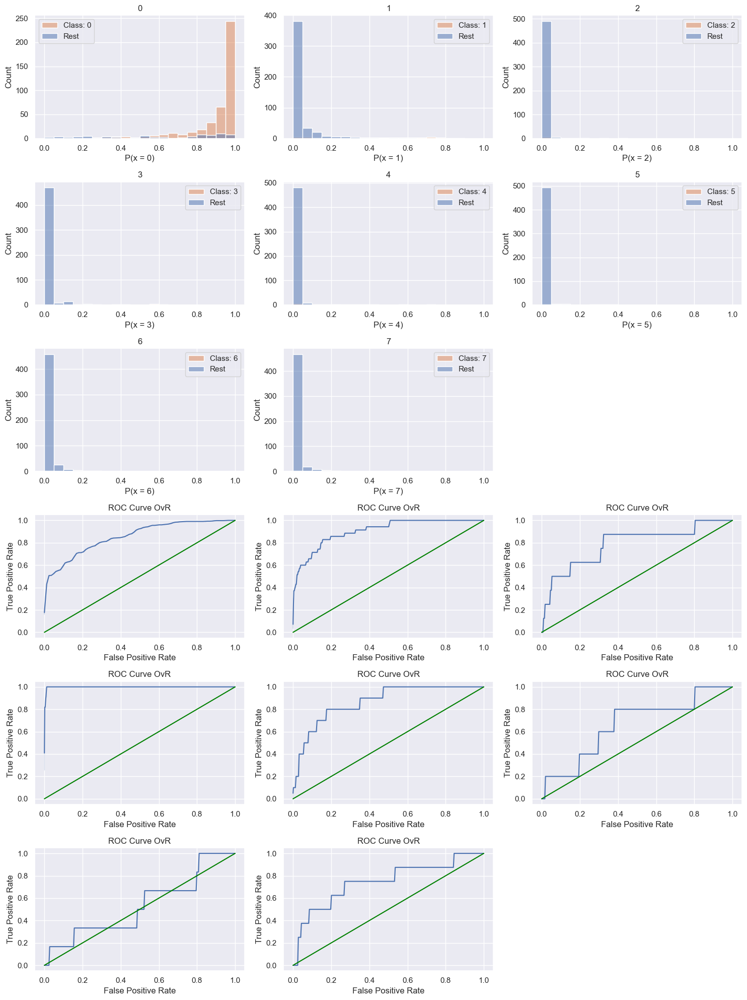

In [199]:
# Plots the Probability Distributions and the ROC Curves One vs Rest

from sklearn.metrics import roc_auc_score,confusion_matrix
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    # Plots the probability distribution for the class and the rest
    ax = plt.subplot(6, 3, i+1)
    sns.histplot(x = "prob", data = df_aux, hue = 'class', color = 'b', ax = ax, bins = bins)
    ax.set_title(c)
    ax.legend([f"Class: {c}", "Rest"])
    ax.set_xlabel(f"P(x = {c})")
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [200]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.8552
1 ROC AUC OvR: 0.9060
2 ROC AUC OvR: 0.7871
3 ROC AUC OvR: 0.9985
4 ROC AUC OvR: 0.8670
5 ROC AUC OvR: 0.6614
6 ROC AUC OvR: 0.5337
7 ROC AUC OvR: 0.7473
average ROC AUC OvR: 0.7945


<AxesSubplot:>

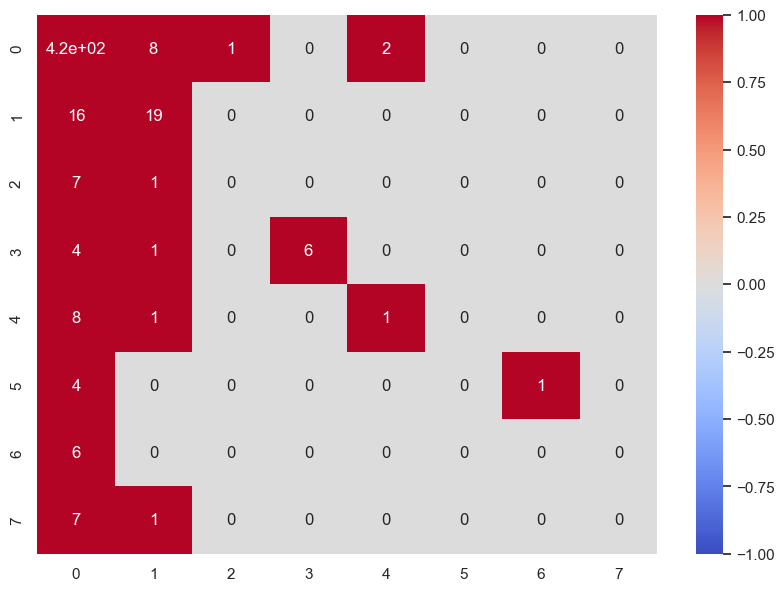

In [201]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [202]:
f=feat_imp[feat_imp==0]

df_sf=new_df.copy()
df_sf=df_sf.drop(f.index,axis=1)
df_sf

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,TRENT_S_n,FIBR_PREDS,PREDS_TAH,FIBR_JELUD,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,77.0,1,2.0,1.0,1.0,2.0,3.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0,0,0,0,0,0,0,0,0
2,52.0,1,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,...,0.0,0,0,0,0,0,0,0,0,0
3,68.0,0,0.0,0.0,0.0,2.0,2.0,0.0,3.0,1.0,...,0.0,0,0,0,0,0,1,0,0,0
4,60.0,1,0.0,0.0,0.0,2.0,3.0,0.0,7.0,0.0,...,1.0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,77.0,0,0.0,4.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,1,0,0,0,0,3
1696,70.0,0,0.0,6.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,1
1697,55.0,1,3.0,6.0,2.0,2.0,0.0,0.0,0.0,0.0,...,0.0,0,0,0,0,0,0,1,0,6
1698,79.0,0,2.0,2.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,1


In [203]:
from sklearn.preprocessing import StandardScaler
X=StandardScaler().fit_transform(df_sf.iloc[:,:-1])
Y=df_sf.iloc[:,-1]
X

array([[ 1.3484,  0.7722,  1.7277, ..., -0.5493, -0.3212, -0.3088],
       [-0.6106,  0.7722,  0.5313, ..., -0.5493, -0.3212, -0.3088],
       [-0.8778,  0.7722, -0.6651, ..., -0.5493, -0.3212, -0.3088],
       ...,
       [-0.6106,  0.7722,  2.9241, ..., -0.5493,  3.1132, -0.3088],
       [ 1.5265, -1.2951,  1.7277, ..., -0.5493, -0.3212, -0.3088],
       [ 0.1017,  0.7722,  1.7277, ..., -0.5493, -0.3212, -0.3088]])

In [204]:
#train test split for the selected features
x_train, x_test, Y_train, Y_test =train_test_split(X,Y,test_size=0.3)

x_test=pd.DataFrame(x_test,columns=df_sf.columns.drop('LET_IS'))

In [205]:
# logistic regression for multi-class classification using a one-vs-rest
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier


# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(x_train, Y_train)

# make predictions
y_pred = ovr.predict(x_test)

In [206]:
accuracy_score(Y_test,y_pred)

0.8705882352941177

In [207]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.9361344537815126

<AxesSubplot:>

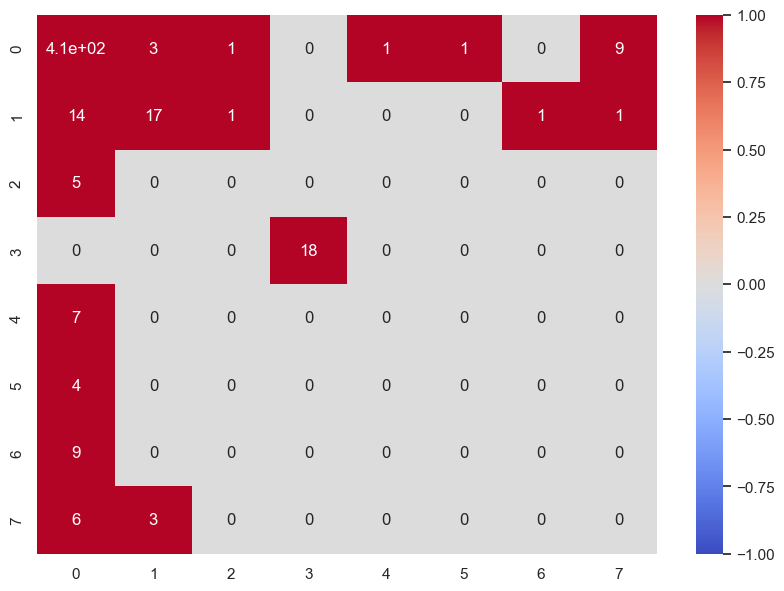

In [208]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [209]:
y_pred = ovr.predict(x_test)
y_proba = ovr.predict_proba(x_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

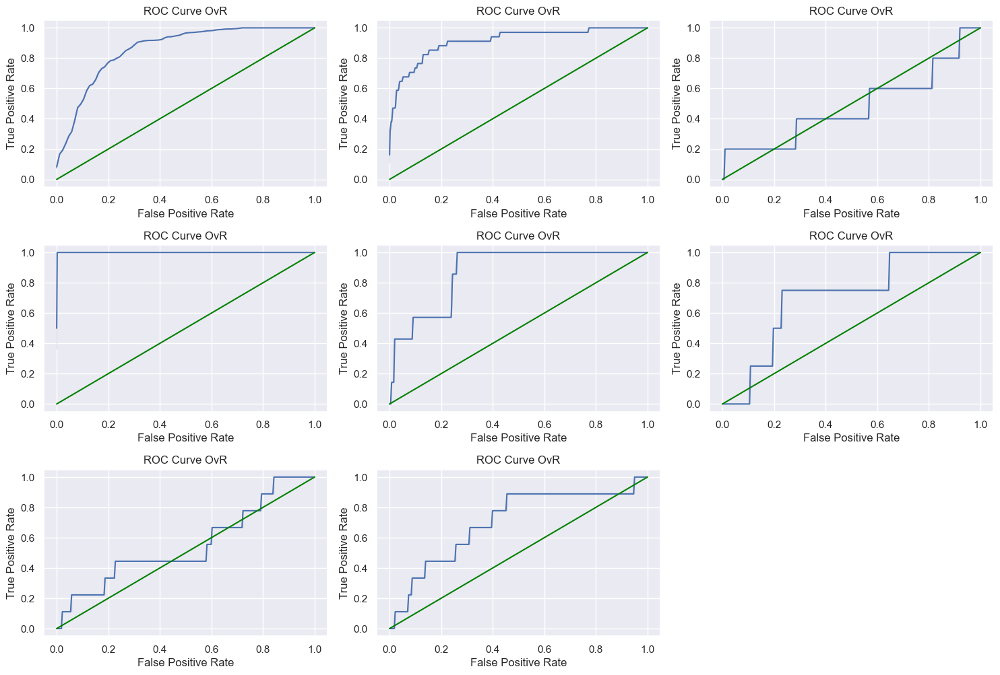

In [210]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [211]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.8618
1 ROC AUC OvR: 0.9132
2 ROC AUC OvR: 0.4812
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.8750
5 ROC AUC OvR: 0.7055
6 ROC AUC OvR: 0.5531
7 ROC AUC OvR: 0.7024
average ROC AUC OvR: 0.7615


In [212]:
accuracy_score(Y_test,y_pred)

0.8705882352941177

In [213]:
from sklearn.ensemble import RandomForestClassifier

model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(X_train, y_train)
RandomForestClassifier(n_estimators=50)
y_pred = model_multiclass.predict(X_test)
y_proba = model_multiclass.predict_proba(X_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [214]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.9361344537815126

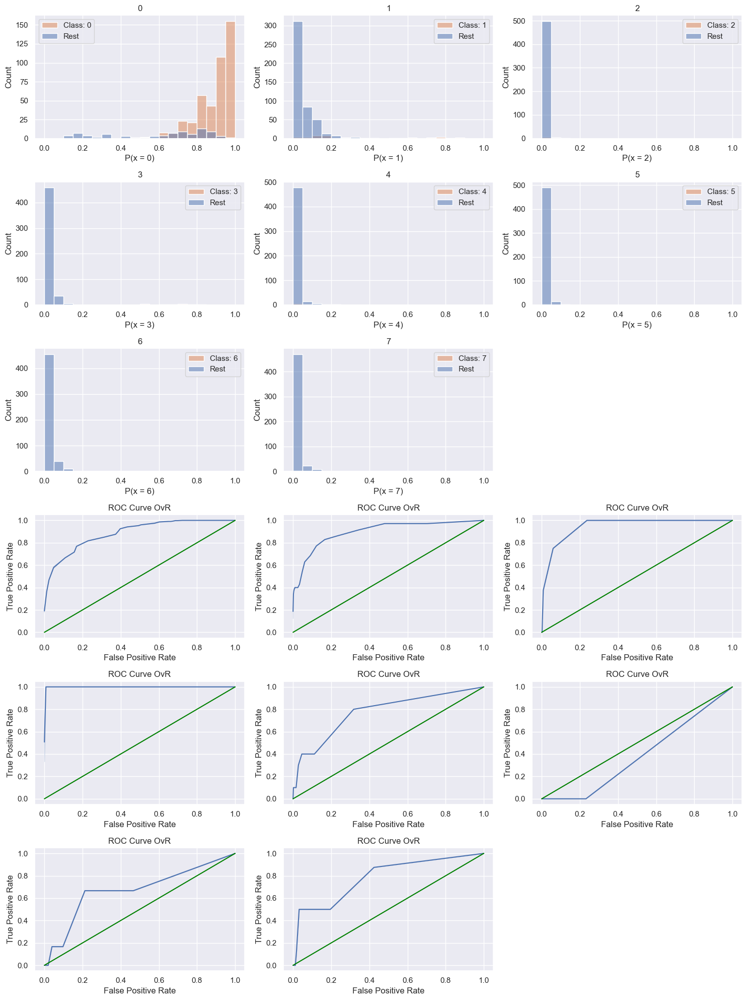

In [215]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    # Plots the probability distribution for the class and the rest
    ax = plt.subplot(6, 3, i+1)
    sns.histplot(x = "prob", data = df_aux, hue = 'class', color = 'b', ax = ax, bins = bins)
    ax.set_title(c)
    ax.legend([f"Class: {c}", "Rest"])
    ax.set_xlabel(f"P(x = {c})")
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [216]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.8861
1 ROC AUC OvR: 0.8982
2 ROC AUC OvR: 0.9483
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.7740
5 ROC AUC OvR: 0.3842
6 ROC AUC OvR: 0.6733
7 ROC AUC OvR: 0.7836
average ROC AUC OvR: 0.7935


<AxesSubplot:>

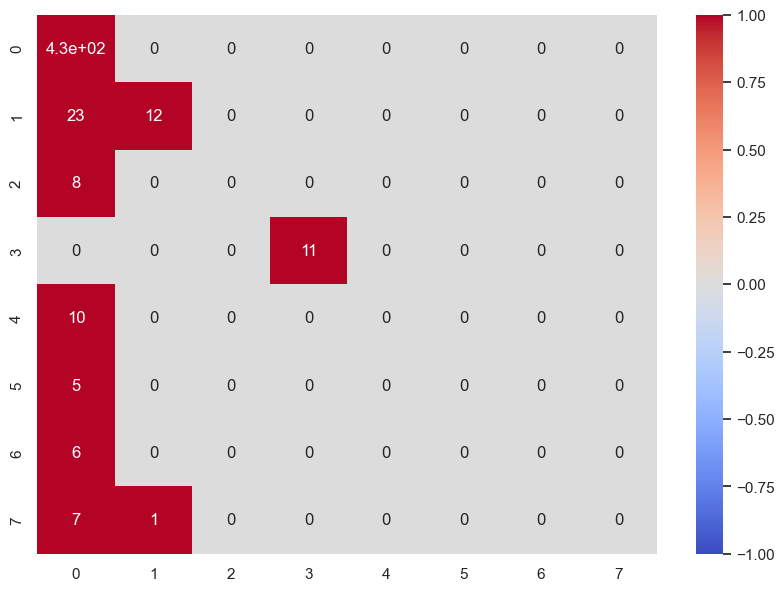

In [217]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [218]:
accuracy_score(y_test,y_pred)

0.8823529411764706

In [219]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(x_train, Y_train)
RandomForestClassifier(n_estimators=50)
y_pred = model_multiclass.predict(x_test)
y_proba = model_multiclass.predict_proba(x_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

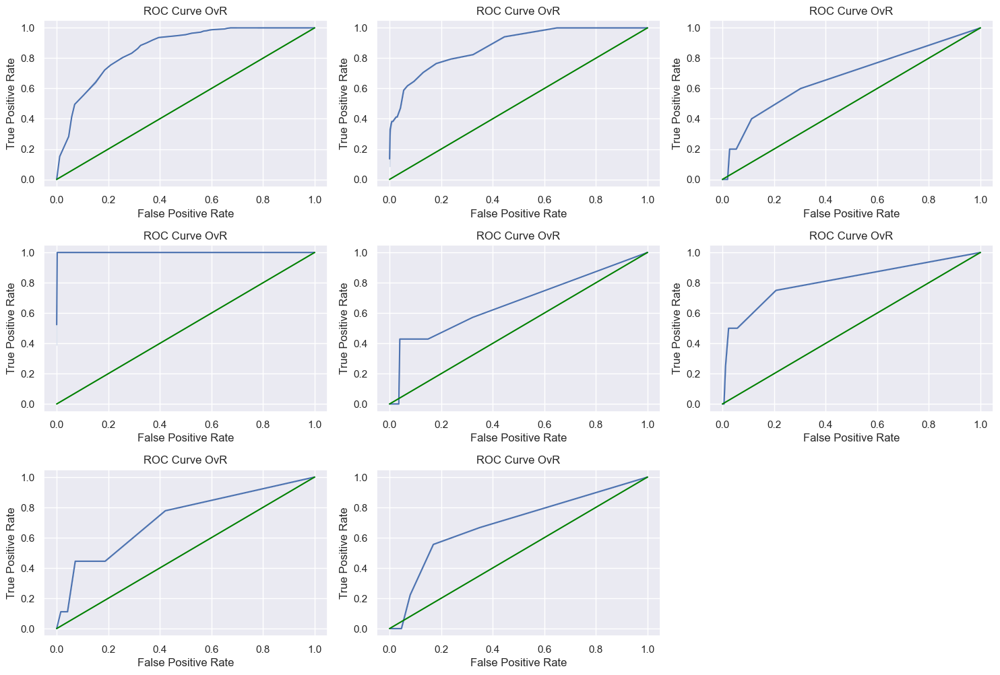

In [220]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [221]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.8584
1 ROC AUC OvR: 0.8796
2 ROC AUC OvR: 0.6764
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.6669
5 ROC AUC OvR: 0.8093
6 ROC AUC OvR: 0.7208
7 ROC AUC OvR: 0.6907
average ROC AUC OvR: 0.7878


<AxesSubplot:>

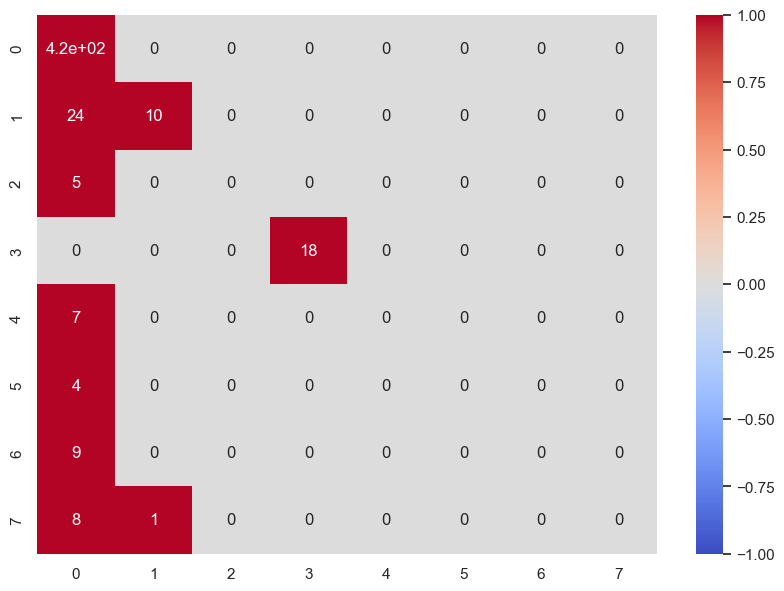

In [222]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [223]:
accuracy_score(Y_test,y_pred)

0.8862745098039215

In [224]:
df_sf=new_df.copy()
df_sf

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,77.0,1,2.0,1.0,1.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,0,0,0
2,52.0,1,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,...,0,0,0,0,0,0,0,0,0,0
3,68.0,0,0.0,0.0,0.0,2.0,2.0,0.0,3.0,1.0,...,0,0,0,0,0,0,1,0,0,0
4,60.0,1,0.0,0.0,0.0,2.0,3.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,77.0,0,0.0,4.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,1,0,1,0,0,0,0,3
1696,70.0,0,0.0,6.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,0,0,0,0,0,0,1
1697,55.0,1,3.0,6.0,2.0,2.0,0.0,0.0,0.0,0.0,...,0,0,0,0,0,0,0,1,0,6
1698,79.0,0,2.0,2.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0,0,0,1,0,0,0,0,0,1


In [225]:
from sklearn.preprocessing import MinMaxScaler
X=MinMaxScaler().fit_transform(df_sf.iloc[:,:-1])
Y=df_sf.iloc[:,-1]
X

array([[0.7727, 1.    , 0.6667, ..., 0.    , 0.    , 0.    ],
       [0.4394, 1.    , 0.3333, ..., 0.    , 0.    , 0.    ],
       [0.3939, 1.    , 0.    , ..., 0.    , 0.    , 0.    ],
       ...,
       [0.4394, 1.    , 1.    , ..., 0.    , 1.    , 0.    ],
       [0.803 , 0.    , 0.6667, ..., 0.    , 0.    , 0.    ],
       [0.5606, 1.    , 0.6667, ..., 0.    , 0.    , 0.    ]])

In [226]:
#train test split for the selected features
x_train, x_test, Y_train, Y_test =train_test_split(X,Y,test_size=0.3)

x_test=pd.DataFrame(x_test,columns=df_sf.columns.drop('LET_IS'))

In [227]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(x_train, Y_train)

# make predictions
y_pred = ovr.predict(x_test)

In [228]:
accuracy_score(Y_test,y_pred)

0.8823529411764706

In [229]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.9176470588235294

<AxesSubplot:>

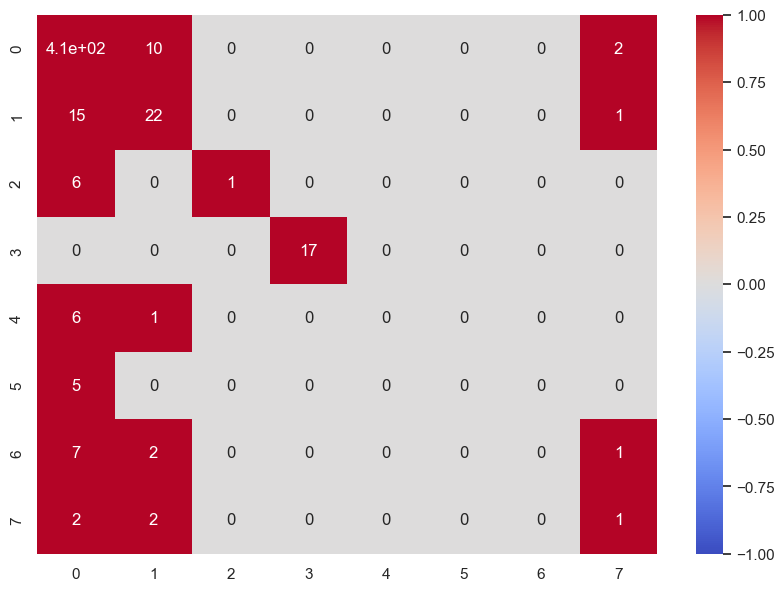

In [230]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [231]:
f=feat_imp[feat_imp==0]

df_sf=new_df.copy()
df_sf=df_sf.drop(f.index,axis=1)
df_sf

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,TRENT_S_n,FIBR_PREDS,PREDS_TAH,FIBR_JELUD,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,77.0,1,2.0,1.0,1.0,2.0,3.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0,0,0,0,0,0,0,0,0
2,52.0,1,0.0,0.0,0.0,2.0,2.0,0.0,2.0,0.0,...,0.0,0,0,0,0,0,0,0,0,0
3,68.0,0,0.0,0.0,0.0,2.0,2.0,0.0,3.0,1.0,...,0.0,0,0,0,0,0,1,0,0,0
4,60.0,1,0.0,0.0,0.0,2.0,3.0,0.0,7.0,0.0,...,1.0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,77.0,0,0.0,4.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,1,0,0,0,0,3
1696,70.0,0,0.0,6.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,1
1697,55.0,1,3.0,6.0,2.0,2.0,0.0,0.0,0.0,0.0,...,0.0,0,0,0,0,0,0,1,0,6
1698,79.0,0,2.0,2.0,2.0,1.0,2.0,0.0,7.0,0.0,...,0.0,0,0,0,0,0,0,0,0,1


In [232]:
X=MinMaxScaler().fit_transform(df_sf.iloc[:,:-1])
Y=df_sf.iloc[:,-1]
X

array([[0.7727, 1.    , 0.6667, ..., 0.    , 0.    , 0.    ],
       [0.4394, 1.    , 0.3333, ..., 0.    , 0.    , 0.    ],
       [0.3939, 1.    , 0.    , ..., 0.    , 0.    , 0.    ],
       ...,
       [0.4394, 1.    , 1.    , ..., 0.    , 1.    , 0.    ],
       [0.803 , 0.    , 0.6667, ..., 0.    , 0.    , 0.    ],
       [0.5606, 1.    , 0.6667, ..., 0.    , 0.    , 0.    ]])

In [233]:
#train test split for the selected features
x_train, x_test, Y_train, Y_test =train_test_split(X,Y,test_size=0.3)

x_test=pd.DataFrame(x_test,columns=df_sf.columns.drop('LET_IS'))

In [234]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(x_train, Y_train)

# make predictions
y_pred = ovr.predict(x_test)

In [235]:
accuracy_score(Y_test,y_pred)

0.8803921568627451

In [236]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.9126050420168067

<AxesSubplot:>

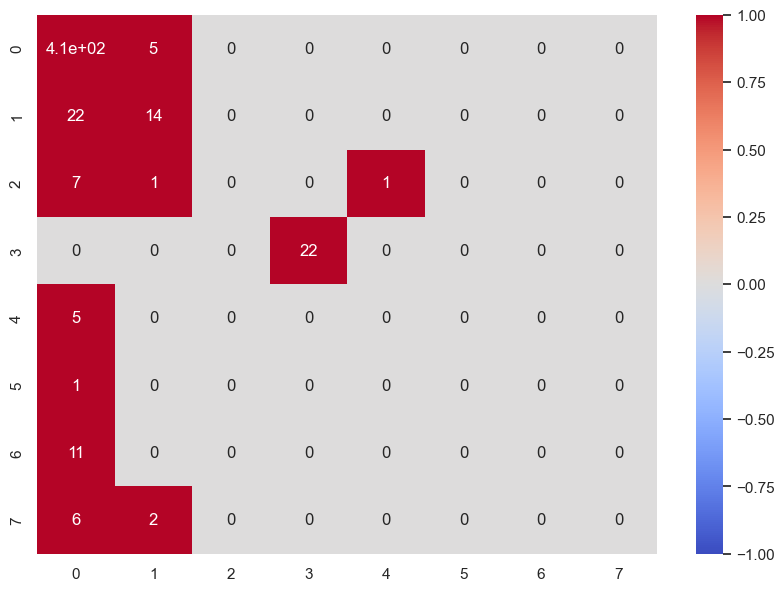

In [237]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [238]:
y_pred = ovr.predict(x_test)
y_proba = ovr.predict_proba(x_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

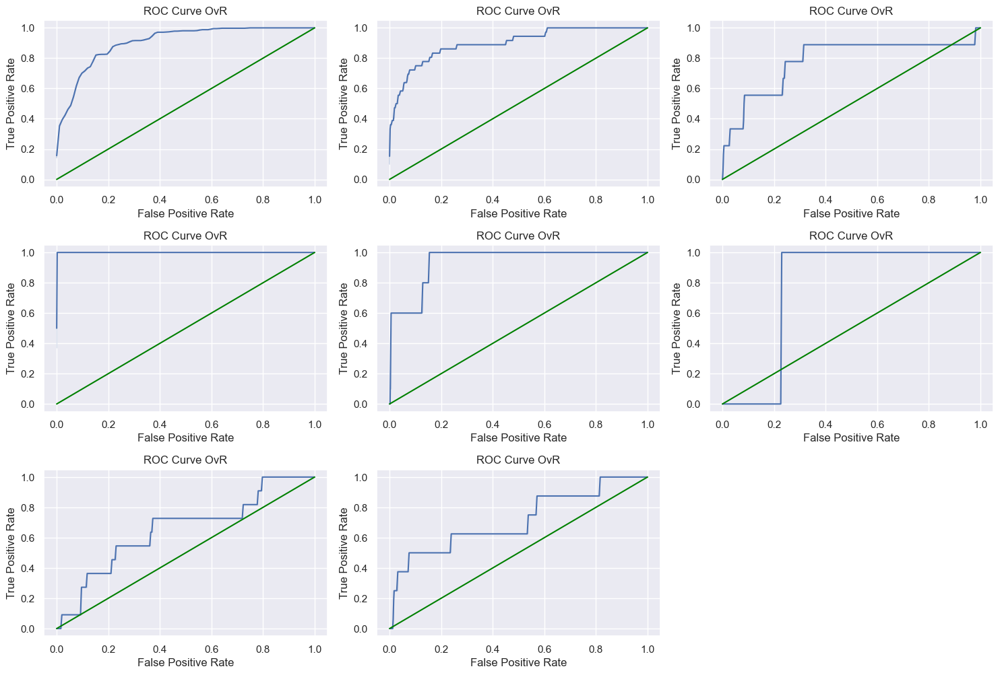

In [239]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [240]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9067
1 ROC AUC OvR: 0.8985
2 ROC AUC OvR: 0.7813
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9418
5 ROC AUC OvR: 0.7721
6 ROC AUC OvR: 0.6551
7 ROC AUC OvR: 0.7136
average ROC AUC OvR: 0.8336


In [241]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(x_train, Y_train)

y_pred = model_multiclass.predict(x_test)
y_proba = model_multiclass.predict_proba(x_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [242]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.9126050420168067

In [243]:
accuracy_score(Y_test,y_pred)

0.8823529411764706

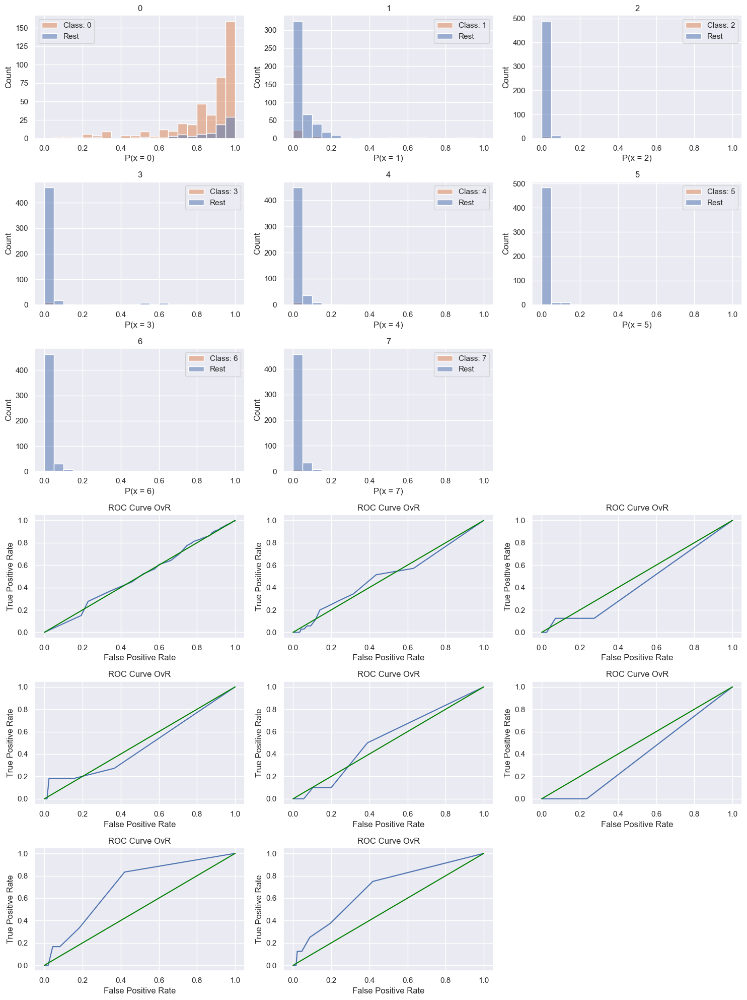

In [244]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    # Plots the probability distribution for the class and the rest
    ax = plt.subplot(6, 3, i+1)
    sns.histplot(x = "prob", data = df_aux, hue = 'class', color = 'b', ax = ax, bins = bins)
    ax.set_title(c)
    ax.legend([f"Class: {c}", "Rest"])
    ax.set_xlabel(f"P(x = {c})")
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [245]:
x=MinMaxScaler().fit_transform(x)

In [246]:
y=df['LET_IS']

In [247]:
X_train, X_test, y_train, y_test = train_test_split(x,y,test_size=0.3)

In [248]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(X_train, y_train)
y_pred = model_multiclass.predict(X_test)
y_proba = model_multiclass.predict_proba(X_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [249]:
accuracy_score(y_test,y_pred)

0.9313725490196079

In [250]:
accuracy_score(y_train,(model_multiclass.predict(X_train)))

1.0

<AxesSubplot:>

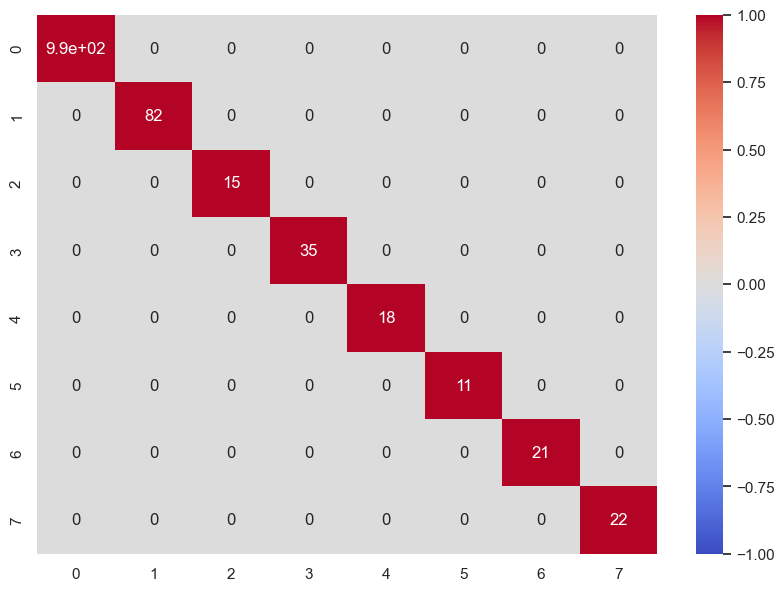

In [251]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_train,model_multiclass.predict(X_train)),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')


In [561]:
# Separate input features and target
X = new_df.drop('LET_IS', axis=1)
y = new_df['LET_IS']

In [562]:
X=MinMaxScaler().fit_transform(X)
X=pd.DataFrame(X,columns=new_df.columns.drop('LET_IS'))
X

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.772727,1.0,0.666667,0.166667,0.25,1.0,1.000000,0.0,1.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.439394,1.0,0.333333,0.000000,0.00,0.0,0.000000,0.0,0.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.393939,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.636364,0.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.428571,0.25,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.515152,1.0,0.000000,0.000000,0.00,1.0,1.000000,0.0,1.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1695,0.772727,0.0,0.000000,0.666667,0.50,0.5,0.666667,0.0,1.000000,0.00,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0
1696,0.666667,0.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1697,0.439394,1.0,1.000000,1.000000,0.50,1.0,0.000000,0.0,0.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1698,0.803030,0.0,0.666667,0.333333,0.50,0.5,0.666667,0.0,1.000000,0.00,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [563]:
# Split your original dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [564]:
X_train

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
1133,0.333333,1.0,0.666667,1.000000,0.5,0.5,0.000000,0.0,0.000000,0.00,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
900,0.500000,0.0,0.000000,1.000000,0.5,0.5,0.666667,0.0,0.857143,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
682,0.787879,0.0,0.333333,0.666667,0.5,1.0,0.666667,0.0,0.428571,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
767,0.575758,1.0,0.000000,0.333333,0.5,1.0,0.000000,0.0,0.000000,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
177,0.636364,0.0,0.000000,0.833333,0.5,1.0,0.666667,0.0,0.714286,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1130,0.712121,1.0,0.000000,0.500000,0.5,1.0,0.666667,0.0,0.285714,0.75,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1294,0.560606,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.00,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
860,0.484848,1.0,0.666667,0.666667,0.5,1.0,0.000000,0.0,0.000000,0.25,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1459,0.575758,0.0,0.333333,0.166667,0.5,1.0,0.666667,0.0,0.857143,0.25,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [565]:
y_train

1133    0
900     0
682     0
767     0
177     0
       ..
1130    0
1294    0
860     0
1459    4
1126    0
Name: LET_IS, Length: 1190, dtype: int64

# over Sampling using SMOTE 

In [566]:
from imblearn.over_sampling import SMOTE


# Apply SMOTE oversampling
smote = SMOTE(random_state=42)
X_resampled, y_resampled = smote.fit_resample(X_train, y_train)

# Display new class distribution
pd.Series(y_resampled).value_counts()

0    1003
3    1003
1    1003
6    1003
5    1003
2    1003
4    1003
7    1003
Name: LET_IS, dtype: int64

In [567]:
X_resampled

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.333333,1.000000,0.666667,1.000000,0.500000,0.500000,0.000000,0.00000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.0,1.0,0.0,0.0,0.0,1.000000,0.0
1,0.500000,0.000000,0.000000,1.000000,0.500000,0.500000,0.666667,0.00000,0.857143,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
2,0.787879,0.000000,0.333333,0.666667,0.500000,1.000000,0.666667,0.00000,0.428571,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
3,0.575758,1.000000,0.000000,0.333333,0.500000,1.000000,0.000000,0.00000,0.000000,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,1.0
4,0.636364,0.000000,0.000000,0.833333,0.500000,1.000000,0.666667,0.00000,0.714286,0.000000,...,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8019,0.763947,1.000000,0.333333,0.126529,0.126529,0.873471,0.666667,0.00000,0.862625,0.000000,...,0.0,0.000000,0.746942,0.0,0.0,0.0,0.0,0.0,0.746942,0.0
8020,0.456435,1.000000,0.000000,0.442748,0.304707,0.609415,0.260390,0.21883,0.500036,0.000000,...,0.0,0.000000,0.781170,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
8021,0.451150,1.000000,0.116579,0.362478,0.337434,0.587434,0.275044,0.00000,0.330053,0.174868,...,0.0,0.000000,0.825132,0.0,0.0,0.0,0.0,0.0,0.000000,0.0
8022,0.523210,0.495452,0.165151,0.668183,0.626137,1.000000,0.000000,0.00000,0.000000,0.000000,...,0.0,0.504548,1.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0


In [572]:
y_resampled.value_counts()

0    1003
3    1003
1    1003
6    1003
5    1003
2    1003
4    1003
7    1003
Name: LET_IS, dtype: int64

In [573]:
y_test.value_counts()

0    426
1     34
3     16
7     11
4      9
6      7
5      4
2      3
Name: LET_IS, dtype: int64

# Logistic Regression model using one v/s rest classifier

In [580]:
from sklearn.model_selection import KFold,cross_val_score
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(X_resampled, y_resampled)

cv=KFold(n_splits=5,shuffle=True,random_state=42)

score=cross_val_score(ovr,X_resampled,y_resampled,cv=cv,scoring='accuracy')
y_pred = ovr.predict(X_test)

score

array([0.9657, 0.9645, 0.9701, 0.9614, 0.9707])

In [584]:
accuracy_score(y_test,y_pred)

0.7470588235294118

In [585]:
accuracy_score(y_resampled,(ovr.predict(X_resampled)))

0.9722083748753739

<AxesSubplot:>

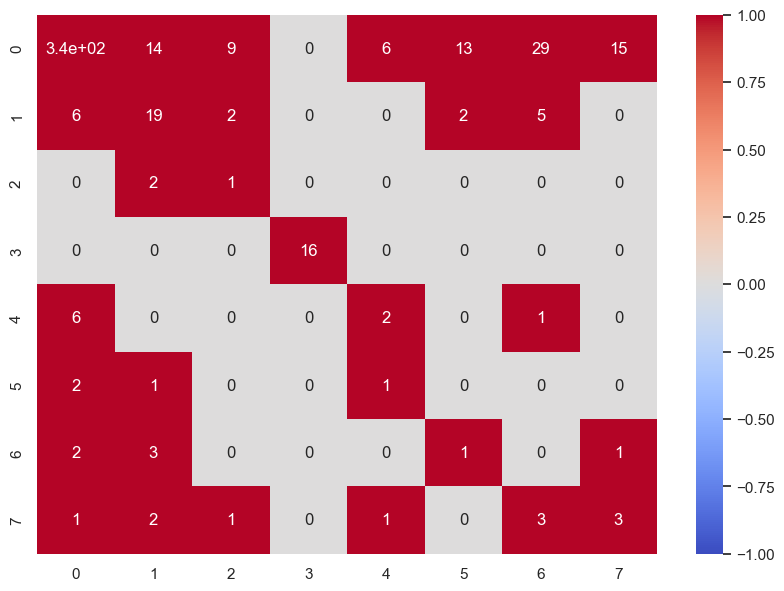

In [586]:
#testing prediction
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

<AxesSubplot:>

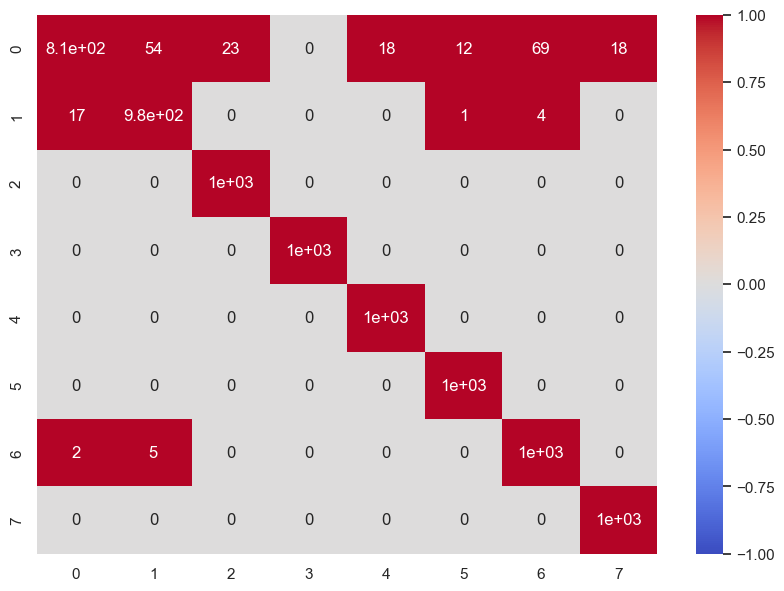

In [587]:
#traning predictions
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_resampled,(ovr.predict(X_resampled))),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [588]:
y_pred = ovr.predict(X_test)
y_proba = ovr.predict_proba(X_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

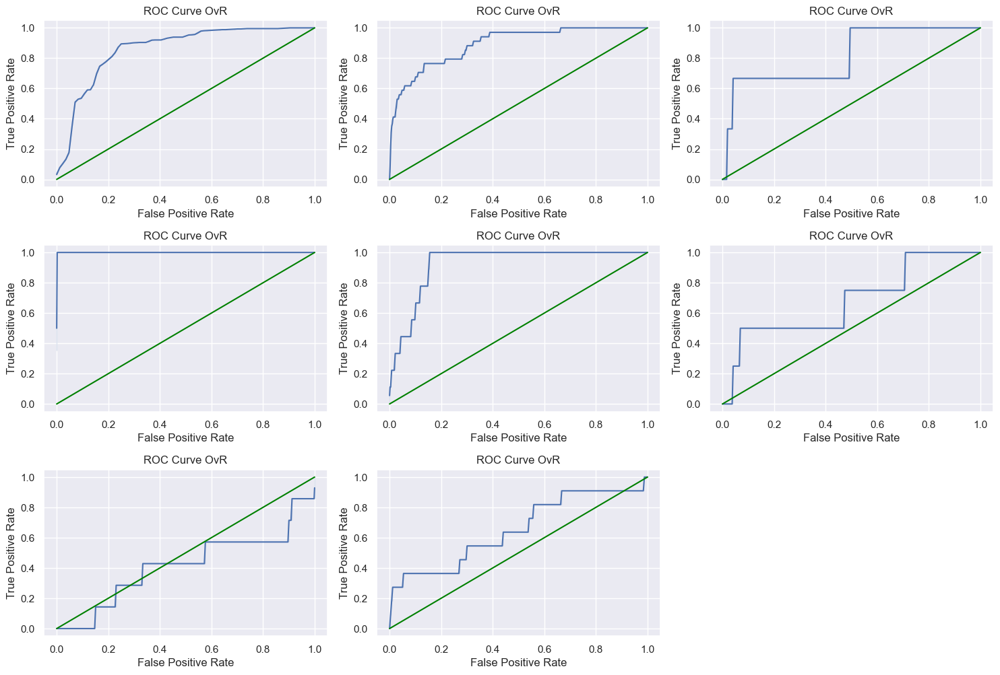

In [589]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [590]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.8617
1 ROC AUC OvR: 0.8919
2 ROC AUC OvR: 0.8166
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9253
5 ROC AUC OvR: 0.6784
6 ROC AUC OvR: 0.4152
7 ROC AUC OvR: 0.6522
average ROC AUC OvR: 0.7802


In [591]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import classification_report

print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.95      0.80      0.87       426
           1       0.46      0.56      0.51        34
           2       0.08      0.33      0.12         3
           3       1.00      1.00      1.00        16
           4       0.20      0.22      0.21         9
           5       0.00      0.00      0.00         4
           6       0.00      0.00      0.00         7
           7       0.16      0.27      0.20        11

    accuracy                           0.75       510
   macro avg       0.36      0.40      0.36       510
weighted avg       0.87      0.75      0.80       510



In [ ]:
f=feat_imp[feat_imp==0]

X_resampled=X_resampled.drop(f.index,axis=1)
X_resampled

In [599]:
X_test=X_test.drop(f.index,axis=1)
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,ASP_S_n,TRENT_S_n,FIBR_PREDS,PREDS_TAH,FIBR_JELUD,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
1492,0.621212,0.0,0.333333,0.000000,0.0,1.0,0.666667,0.0,0.142857,0.00,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
115,0.500000,0.0,0.000000,0.000000,0.0,0.0,0.666667,0.0,0.857143,0.00,...,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
135,0.484848,1.0,0.000000,0.000000,0.0,1.0,0.000000,0.0,0.000000,0.00,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
352,0.530303,1.0,0.000000,0.000000,0.0,1.0,0.666667,0.0,1.000000,0.00,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1302,0.772727,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.00,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1228,0.545455,1.0,0.000000,0.666667,0.5,0.5,0.000000,0.0,0.000000,0.00,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0
471,0.257576,1.0,0.333333,0.000000,0.0,1.0,0.000000,0.0,0.000000,0.00,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
322,0.651515,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.25,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1235,0.818182,0.0,0.000000,0.000000,0.0,1.0,0.666667,0.0,0.857143,0.00,...,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0


In [600]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(X_resampled, y_resampled)

# make predictions
y_pred = ovr.predict(X_test)

score=cross_val_score(ovr,X_resampled,y_resampled,cv=cv,scoring='accuracy')
score

array([0.9346, 0.9321, 0.9302, 0.9277, 0.9383])

In [601]:
accuracy_score(y_test,y_pred)

0.696078431372549

In [315]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.8954011497125719

<AxesSubplot:>

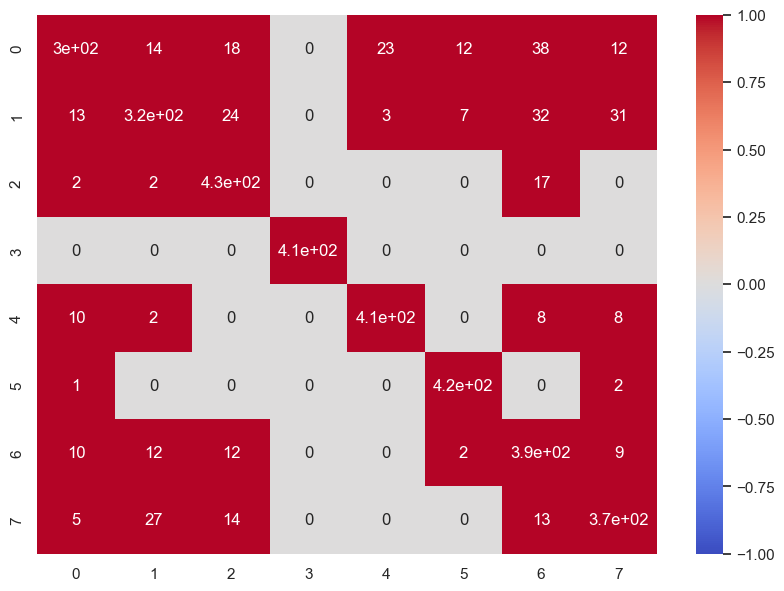

In [308]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [309]:
y_pred = ovr.predict(x_test)
y_proba = ovr.predict_proba(x_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

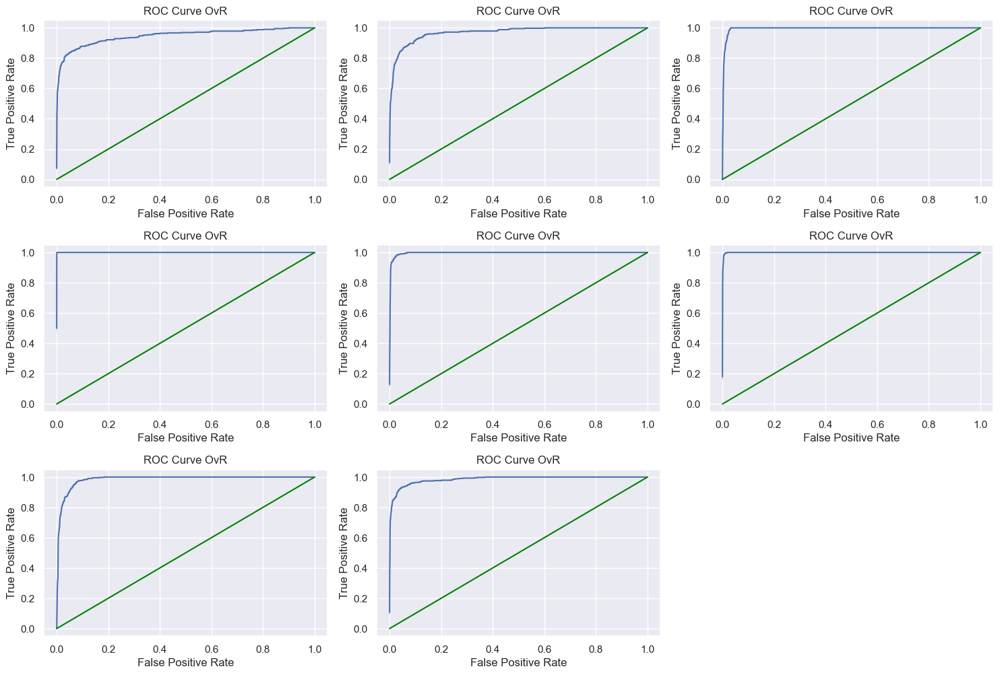

In [310]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [311]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9477
1 ROC AUC OvR: 0.9699
2 ROC AUC OvR: 0.9953
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9968
5 ROC AUC OvR: 0.9992
6 ROC AUC OvR: 0.9846
7 ROC AUC OvR: 0.9856
average ROC AUC OvR: 0.9849


In [313]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.88      0.72      0.79       421
           1       0.85      0.74      0.79       428
           2       0.86      0.95      0.91       449
           3       1.00      1.00      1.00       408
           4       0.94      0.94      0.94       441
           5       0.95      0.99      0.97       418
           6       0.78      0.90      0.84       435
           7       0.86      0.86      0.86       430

    accuracy                           0.89      3430
   macro avg       0.89      0.89      0.89      3430
weighted avg       0.89      0.89      0.89      3430



In [335]:
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
acc = accuracy_score(Y_test, y_pred)
prec = precision_score(Y_test, y_pred,average=None)
recall = recall_score(Y_test, y_pred,average=None)
f1 = f1_score(Y_test, y_pred,average=None)
print("accuracy_score : ", acc)
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))


accuracy_score :  0.888338192419825
precision_score :  0.89057718238738
recall_score :  0.8883729548724285
f1_score :  0.8872401601674343


<AxesSubplot:>

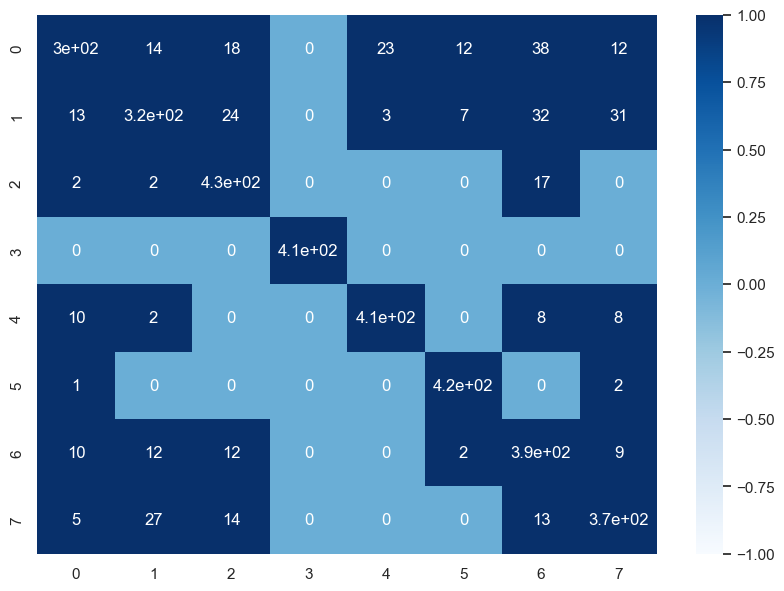

In [321]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

# Random forest model

In [386]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(X_train, y_train)

y_pred = model_multiclass.predict(X_test)
y_proba = model_multiclass.predict_proba(X_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [388]:
accuracy_score(y_train,(model_multiclass.predict(X_train)))

1.0

In [389]:
accuracy_score(y_test,y_pred)

0.9950437317784256

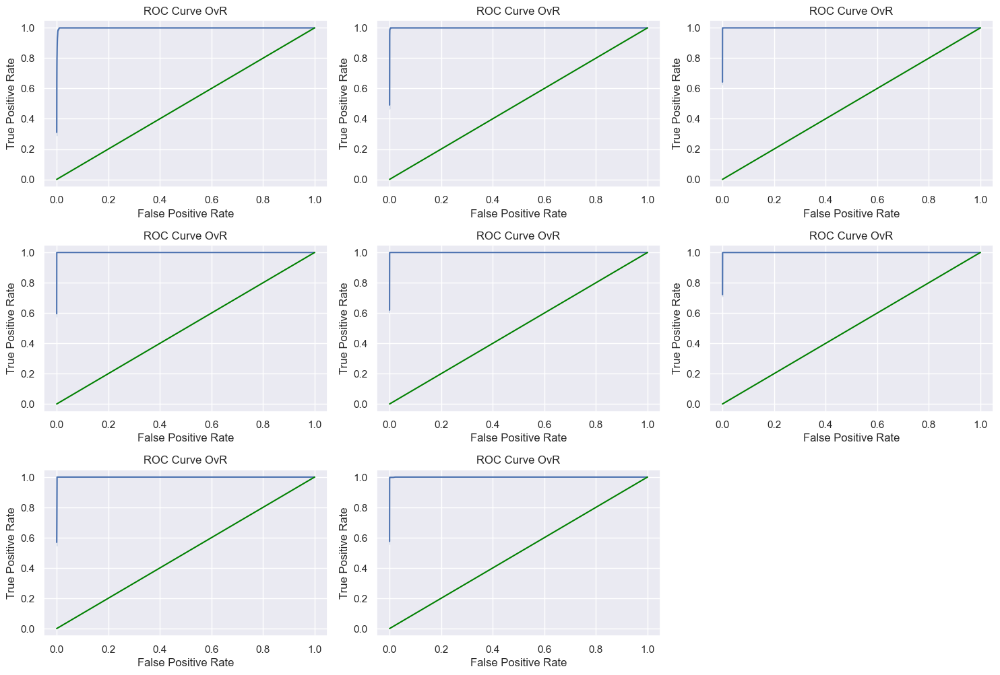

In [390]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [391]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9993
1 ROC AUC OvR: 0.9999
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 1.0000
average ROC AUC OvR: 0.9999


In [392]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       412
           1       0.99      0.98      0.99       442
           2       1.00      1.00      1.00       395
           3       1.00      1.00      1.00       429
           4       1.00      1.00      1.00       459
           5       1.00      1.00      1.00       417
           6       1.00      1.00      1.00       418
           7       1.00      1.00      1.00       458

    accuracy                           1.00      3430
   macro avg       1.00      1.00      1.00      3430
weighted avg       1.00      1.00      1.00      3430



<AxesSubplot:>

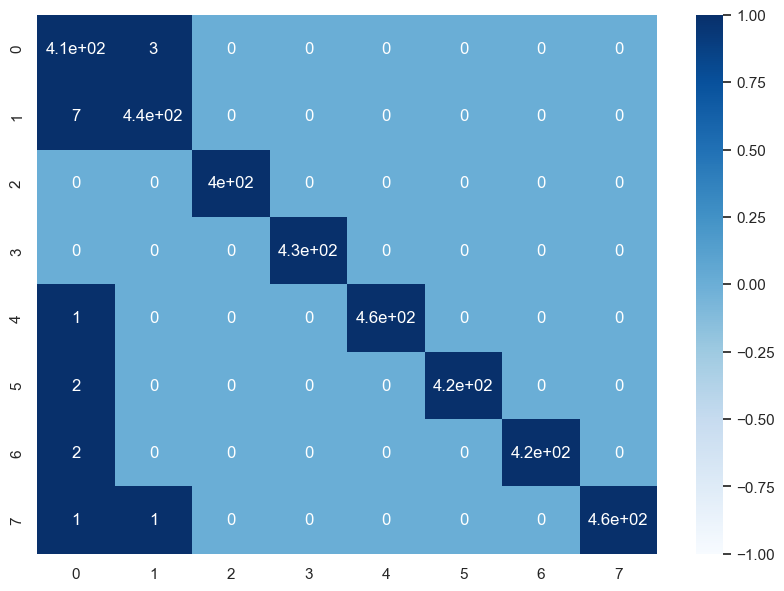

In [393]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

In [395]:
print("accuracy_score : ", accuracy_score(y_test, y_pred))
print("precision_score : ", precision_score(y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(y_test, y_pred,average='macro'))

accuracy_score :  0.9950437317784256
precision_score :  0.995010336935517
recall_score :  0.9950943786250296
f1_score :  0.9950311140133896


In [402]:
#building model using the selected features

model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(x_train, Y_train)

y_pred = model_multiclass.predict(x_test)
y_proba = model_multiclass.predict_proba(x_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [403]:
accuracy_score(Y_train,(model_multiclass.predict(x_train)))

1.0

In [404]:
accuracy_score(Y_test,y_pred)

0.9941690962099126

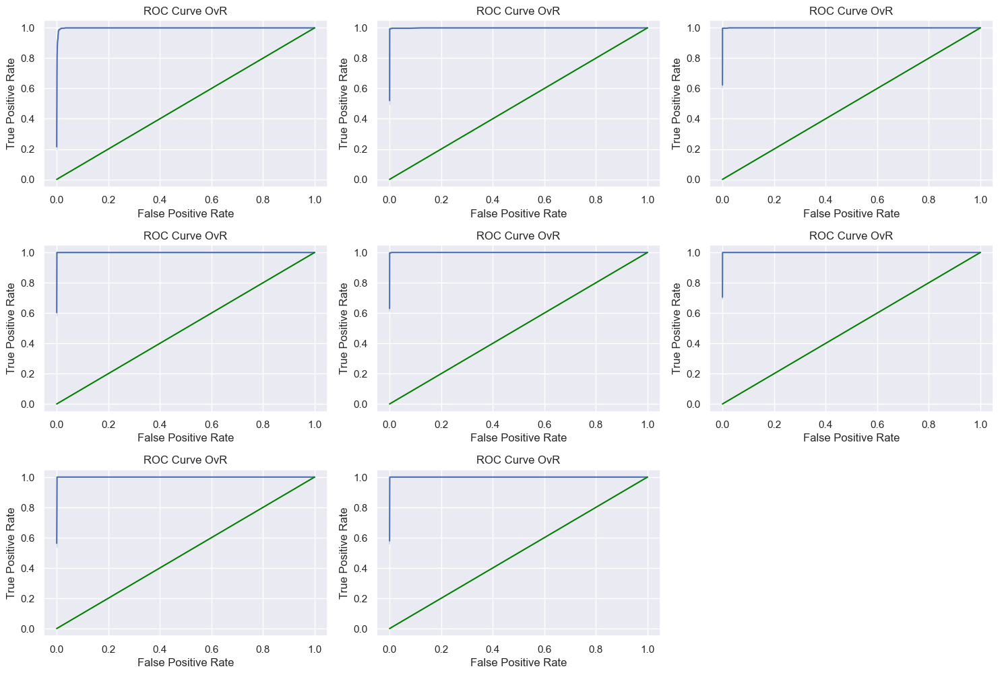

In [406]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [407]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9988
1 ROC AUC OvR: 0.9997
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 1.0000
average ROC AUC OvR: 0.9998


In [408]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.97      0.99      0.98       421
           1       0.99      0.99      0.99       428
           2       1.00      0.99      1.00       449
           3       1.00      1.00      1.00       408
           4       1.00      1.00      1.00       441
           5       1.00      1.00      1.00       418
           6       1.00      1.00      1.00       435
           7       1.00      1.00      1.00       430

    accuracy                           0.99      3430
   macro avg       0.99      0.99      0.99      3430
weighted avg       0.99      0.99      0.99      3430



In [410]:
print("accuracy_score : ", accuracy_score(Y_test, y_pred))
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))

accuracy_score :  0.9941690962099126
precision_score :  0.994187580730705
recall_score :  0.9941909382803329
f1_score :  0.9941691932848716


<AxesSubplot:>

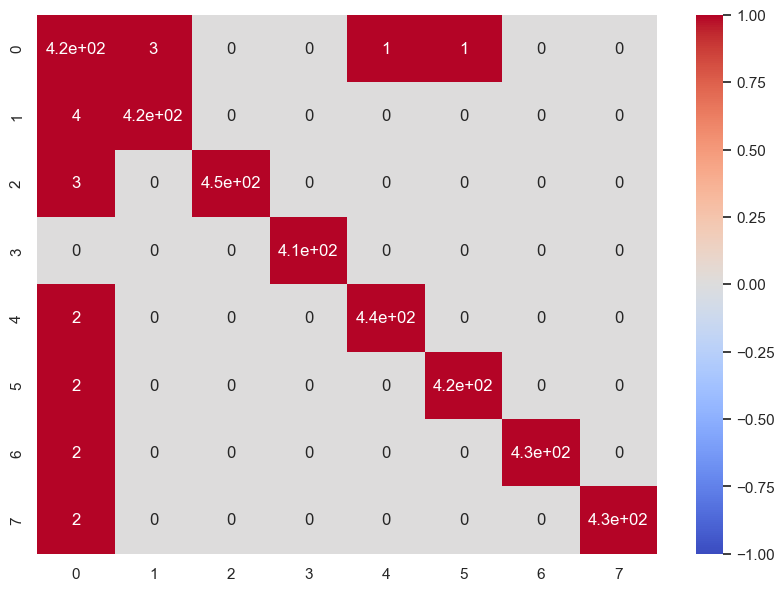

In [409]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

# ADASYN

ADASYN is based on the idea of adaptively generating minority data samples according to their distributions: more synthetic data is generated for minority class samples that are harder to learn compared to those minority samples that are easier to learn

In [416]:
X_train_adas=new_df.drop(['LET_IS'],axis=1)
Y_train_adas=new_df['LET_IS']
X_train_adas.shape,Y_train_adas.shape

from imblearn.over_sampling import ADASYN
sm = ADASYN(random_state = 2)
X_train_ada, y_train_ada = sm.fit_resample(X_train_adas, Y_train_adas.ravel())

X_train_ada.shape, y_train_ada.shape

print(f'size of 0th class  {len(y_train_ada[y_train_ada==0])}')
print(f'size of 1st class  {len(y_train_ada[y_train_ada==1])}')
print(f'size of 2nd class  {len(y_train_ada[y_train_ada==2])}')
print(f'size of 3rd class  {len(y_train_ada[y_train_ada==3])}')
print(f'size of 4th class  {len(y_train_ada[y_train_ada==4])}')
print(f'size of 5th class  {len(y_train_ada[y_train_ada==5])}')
print(f'size of 6th class  {len(y_train_ada[y_train_ada==6])}')
print(f'size of 7th class  {len(y_train_ada[y_train_ada==7])}')

size of 0th class  1429
size of 1st class  1450
size of 2nd class  1426
size of 3rd class  1413
size of 4th class  1436
size of 5th class  1428
size of 6th class  1430
size of 7th class  1436


In [418]:
#scaling the data 

col=X_train_ada.columns
X_train_ada=MinMaxScaler().fit_transform(X_train_ada)
X_train_ada=pd.DataFrame(X_train_ada,columns=col)
X_train_ada

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.772727,1.0,0.666667,0.166667,0.250000,1.000000,1.000000,0.000000,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.439394,1.0,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.393939,1.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.000000,0.285714,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.636364,0.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.000000,0.428571,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.515152,1.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11443,0.505158,1.0,0.585104,0.723403,0.396276,0.792552,0.528368,0.000000,0.282979,0.585104,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11444,0.470012,1.0,0.879417,0.819126,0.590437,1.000000,0.425501,0.000000,0.127650,1.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11445,0.413148,1.0,0.033469,0.838912,0.500000,1.000000,0.022313,0.966531,0.835149,0.033469,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11446,0.491241,1.0,0.570323,0.677742,0.500000,0.677742,0.666667,0.000000,0.365733,0.355484,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [419]:
X_train, X_test, y_train, y_test=train_test_split(X_train_ada,y_train_ada,test_size=0.3)

In [420]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(X_train, y_train)

# make predictions
y_pred = ovr.predict(X_test)

In [421]:
accuracy_score(y_test,y_pred)

0.9458515283842794

In [422]:
accuracy_score(y_train,(ovr.predict(X_train)))

0.9492075377511544

<AxesSubplot:>

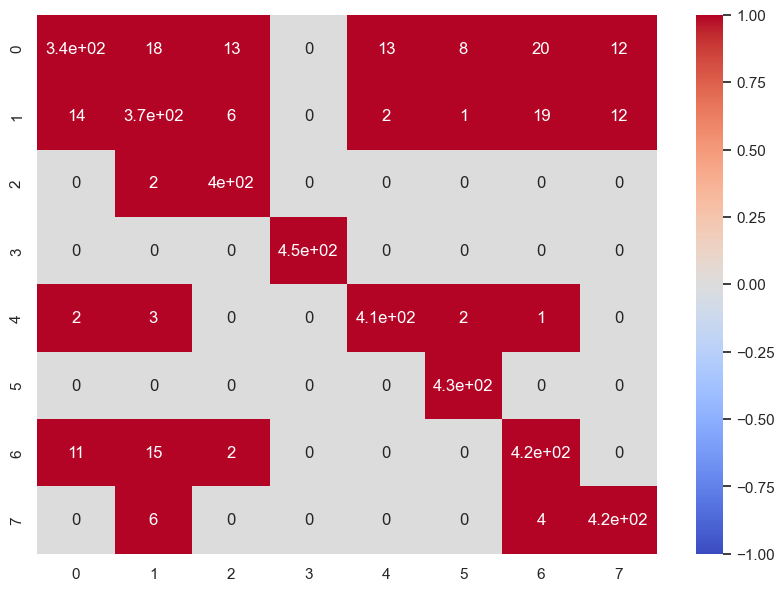

In [423]:
#testing prediction
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [424]:
y_pred = ovr.predict(X_test)
y_proba = ovr.predict_proba(X_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

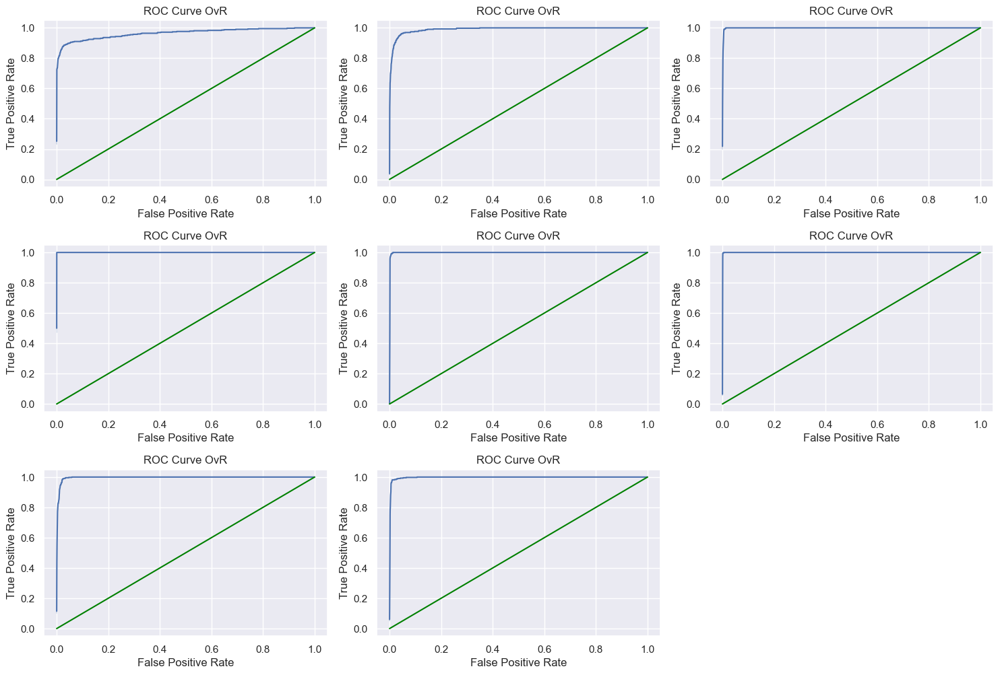

In [427]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [428]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9646
1 ROC AUC OvR: 0.9902
2 ROC AUC OvR: 0.9989
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9989
5 ROC AUC OvR: 0.9996
6 ROC AUC OvR: 0.9966
7 ROC AUC OvR: 0.9975
average ROC AUC OvR: 0.9933


In [429]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.93      0.80      0.86       423
           1       0.89      0.87      0.88       426
           2       0.95      1.00      0.97       406
           3       1.00      1.00      1.00       448
           4       0.96      0.98      0.97       415
           5       0.98      1.00      0.99       433
           6       0.91      0.94      0.92       452
           7       0.95      0.98      0.96       432

    accuracy                           0.95      3435
   macro avg       0.95      0.95      0.94      3435
weighted avg       0.95      0.95      0.94      3435



In [430]:
f=feat_imp[feat_imp==0]

X_train_ada=X_train_ada.drop(f.index,axis=1)
X_train_ada

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,ASP_S_n,TRENT_S_n,FIBR_PREDS,PREDS_TAH,FIBR_JELUD,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.772727,1.0,0.666667,0.166667,0.250000,1.000000,1.000000,0.000000,1.000000,0.000000,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.439394,1.0,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.393939,1.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.000000,0.285714,0.000000,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.636364,0.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.000000,0.428571,0.250000,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0.515152,1.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,1.000000,0.000000,...,1.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11443,0.505158,1.0,0.585104,0.723403,0.396276,0.792552,0.528368,0.000000,0.282979,0.585104,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11444,0.470012,1.0,0.879417,0.819126,0.590437,1.000000,0.425501,0.000000,0.127650,1.000000,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11445,0.413148,1.0,0.033469,0.838912,0.500000,1.000000,0.022313,0.966531,0.835149,0.033469,...,0.033469,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
11446,0.491241,1.0,0.570323,0.677742,0.500000,0.677742,0.666667,0.000000,0.365733,0.355484,...,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [431]:
#train test split for the selected features
x_train, x_test, Y_train, Y_test =train_test_split(X_train_ada,y_train_ada,test_size=0.3)

In [432]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(x_train, Y_train)

# make predictions
y_pred = ovr.predict(x_test)

In [433]:
accuracy_score(Y_test,y_pred)

0.9013100436681223

In [434]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.8919256208660926

<AxesSubplot:>

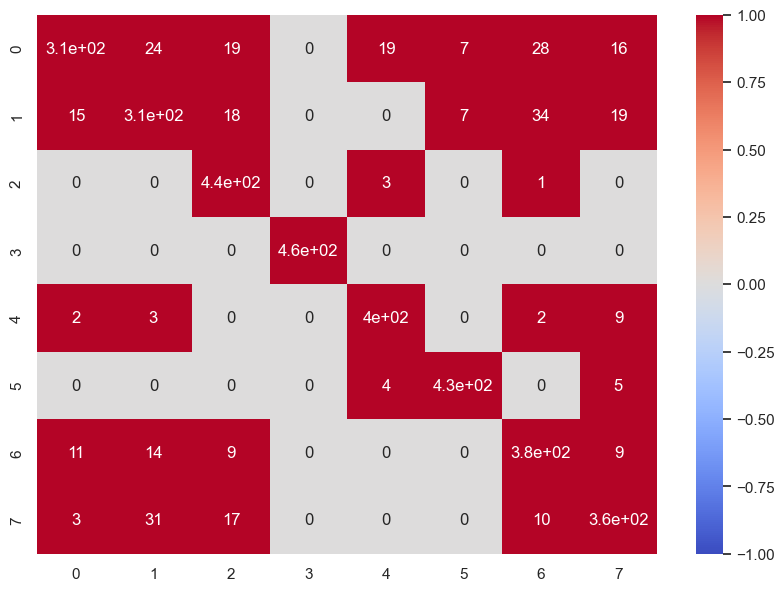

In [435]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [436]:
y_pred = ovr.predict(x_test)
y_proba = ovr.predict_proba(x_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

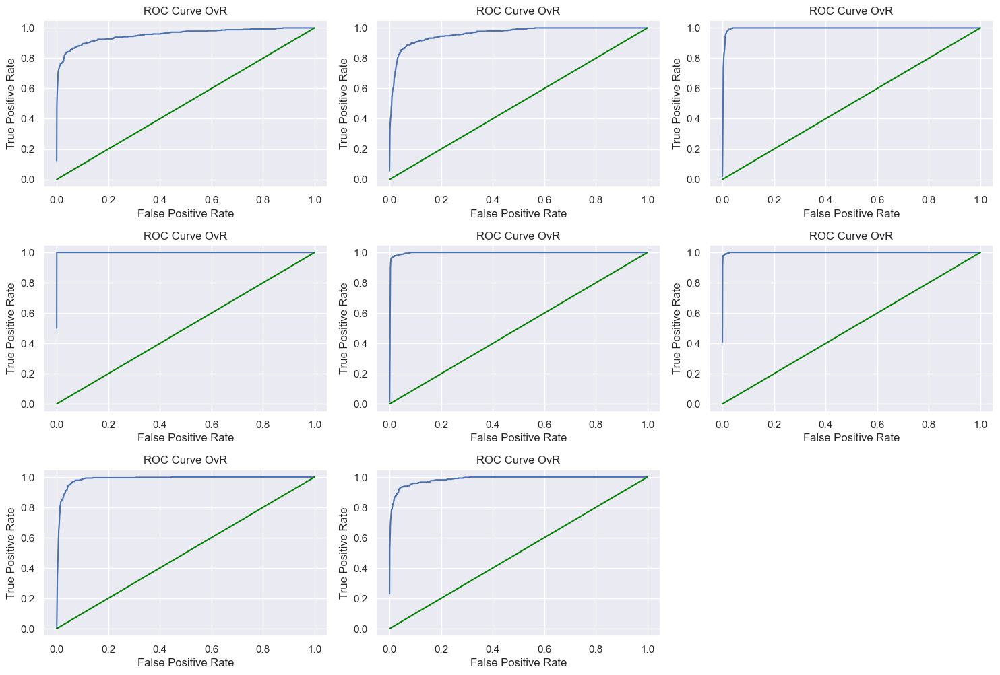

In [437]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [438]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9550
1 ROC AUC OvR: 0.9622
2 ROC AUC OvR: 0.9964
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9969
5 ROC AUC OvR: 0.9996
6 ROC AUC OvR: 0.9869
7 ROC AUC OvR: 0.9859
average ROC AUC OvR: 0.9854


In [439]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.91      0.73      0.81       424
           1       0.81      0.77      0.79       400
           2       0.88      0.99      0.93       446
           3       1.00      1.00      1.00       464
           4       0.94      0.96      0.95       419
           5       0.97      0.98      0.97       443
           6       0.83      0.90      0.86       419
           7       0.86      0.85      0.86       420

    accuracy                           0.90      3435
   macro avg       0.90      0.90      0.90      3435
weighted avg       0.90      0.90      0.90      3435



In [441]:
print("accuracy_score : ", accuracy_score(Y_test, y_pred))
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))

accuracy_score :  0.9013100436681223
precision_score :  0.899673590997934
recall_score :  0.8982070472498598
f1_score :  0.8970749580786739


<AxesSubplot:>

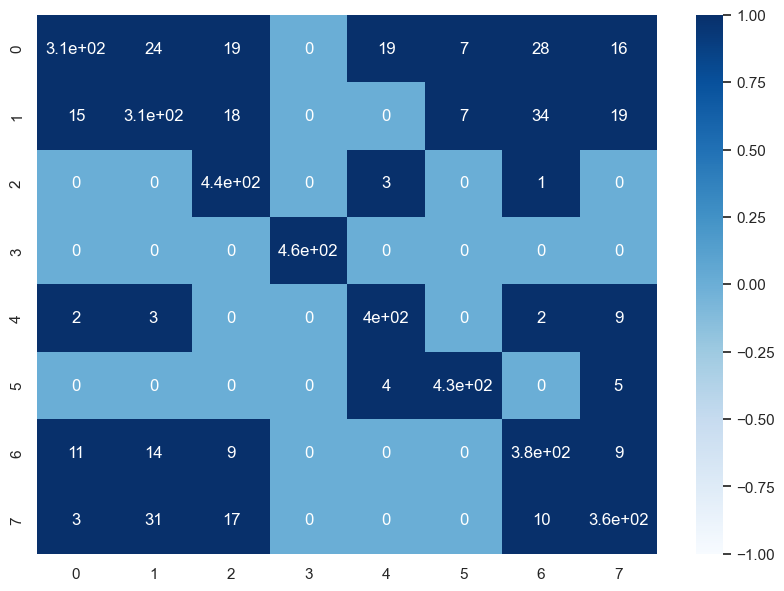

In [442]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

In [443]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(X_train, y_train)

y_pred = model_multiclass.predict(X_test)
y_proba = model_multiclass.predict_proba(X_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [444]:
accuracy_score(y_train,(model_multiclass.predict(X_train)))

1.0

In [445]:
accuracy_score(y_test,y_pred)

0.9935953420669578

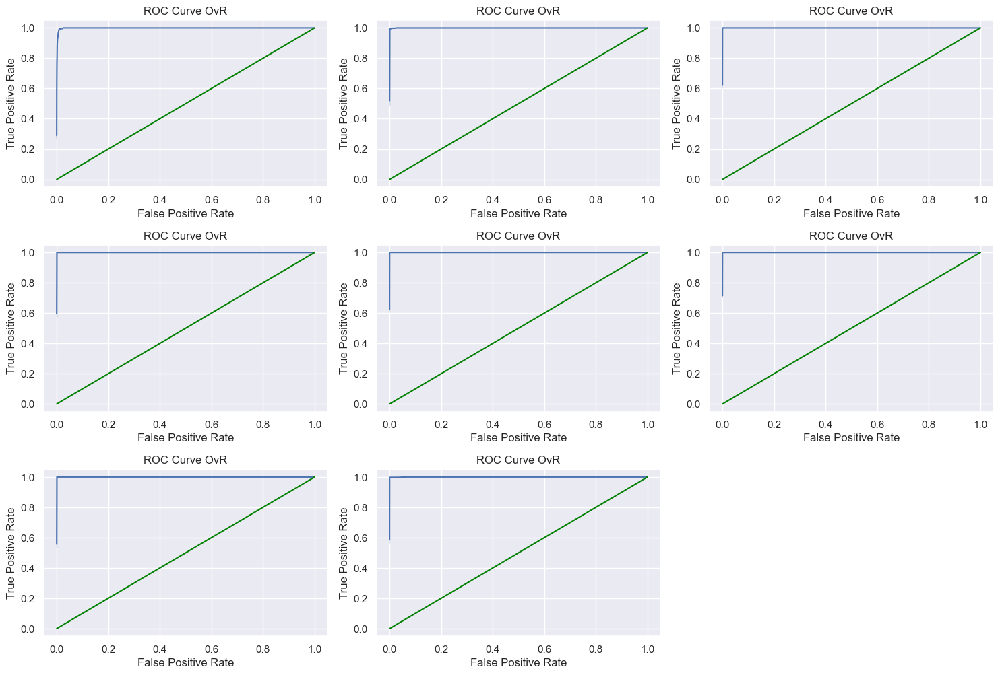

In [446]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [447]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9991
1 ROC AUC OvR: 0.9999
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 0.9999
average ROC AUC OvR: 0.9999


In [448]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.96      0.99      0.97       423
           1       0.99      0.98      0.99       426
           2       1.00      1.00      1.00       406
           3       1.00      1.00      1.00       448
           4       1.00      1.00      1.00       415
           5       1.00      1.00      1.00       433
           6       1.00      0.99      1.00       452
           7       1.00      1.00      1.00       432

    accuracy                           0.99      3435
   macro avg       0.99      0.99      0.99      3435
weighted avg       0.99      0.99      0.99      3435



<AxesSubplot:>

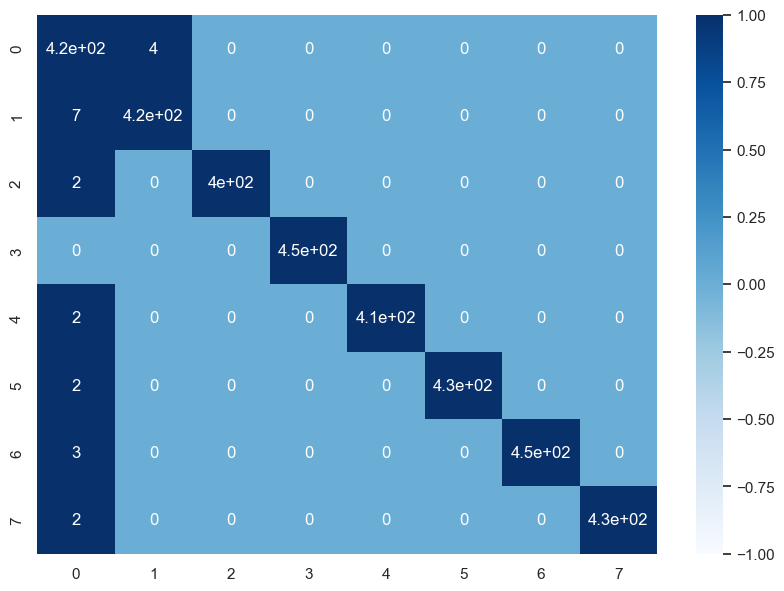

In [449]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

In [450]:
print("accuracy_score : ", accuracy_score(y_test, y_pred))
print("precision_score : ", precision_score(y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(y_test, y_pred,average='macro'))

accuracy_score :  0.9935953420669578
precision_score :  0.9936692254843089
recall_score :  0.9935600861804468
f1_score :  0.9935766195530875


In [451]:
#building model using the selected features

model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(x_train, Y_train)

y_pred = model_multiclass.predict(x_test)
y_proba = model_multiclass.predict_proba(x_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [452]:
accuracy_score(Y_train,(model_multiclass.predict(x_train)))

1.0

In [453]:
accuracy_score(Y_test,y_pred)

0.9944687045123727

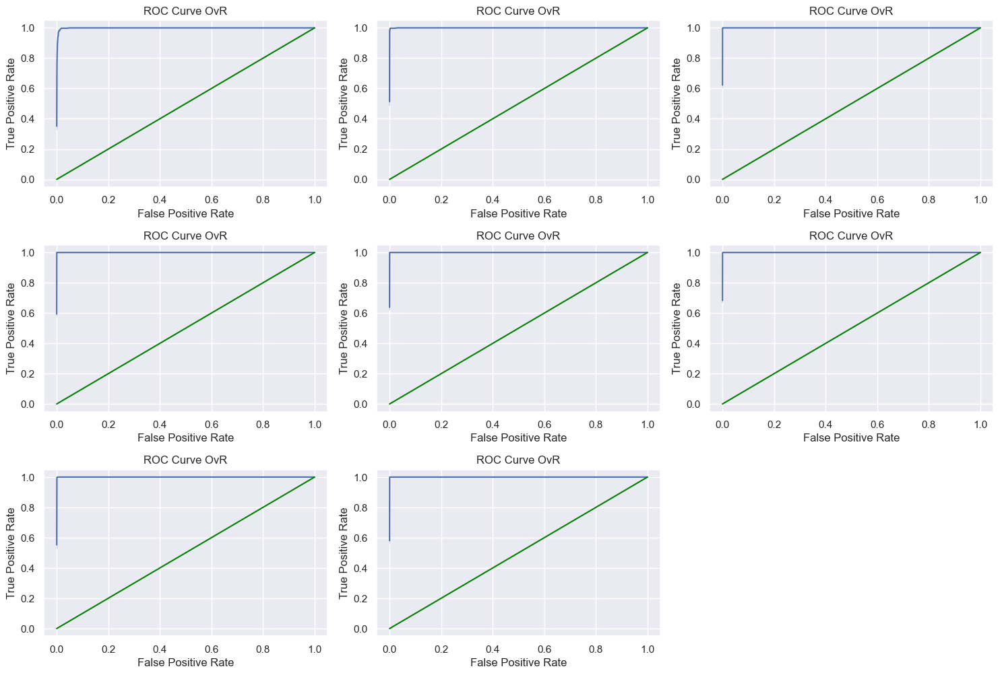

In [454]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [455]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9989
1 ROC AUC OvR: 0.9999
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 1.0000
average ROC AUC OvR: 0.9999


In [456]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.97      0.98      0.98       424
           1       0.99      0.99      0.99       400
           2       1.00      1.00      1.00       446
           3       1.00      1.00      1.00       464
           4       1.00      1.00      1.00       419
           5       1.00      1.00      1.00       443
           6       1.00      1.00      1.00       419
           7       1.00      1.00      1.00       420

    accuracy                           0.99      3435
   macro avg       0.99      0.99      0.99      3435
weighted avg       0.99      0.99      0.99      3435



In [457]:
print("accuracy_score : ", accuracy_score(Y_test, y_pred))
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))

accuracy_score :  0.9944687045123727
precision_score :  0.9943701105041249
recall_score :  0.9943030981941552
f1_score :  0.9943311455027464


<AxesSubplot:>

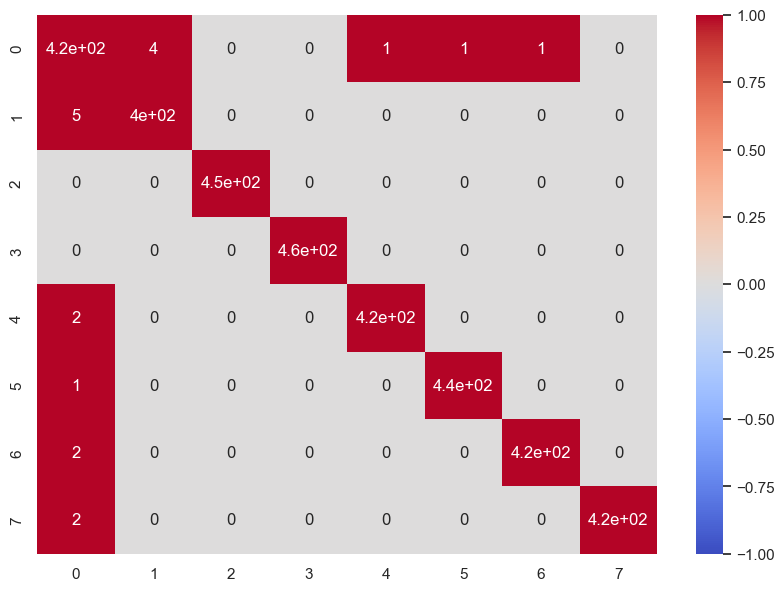

In [458]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

# SMOTE + ENN

SMOTE + ENN is another hybrid technique where more no. of observations are removed from the sample space. Here, ENN is yet another undersampling technique where the nearest neighbors of each of the majority class is estimated. If the nearest neighbors misclassify that particular instance of the majority class, then that instance gets deleted. Integrating this technique with oversampled data done by SMOTE helps in doing extensive data cleaning. Here on misclassification by NN’s samples from both the classes are removed. This results in a more clear and concise class separation.

In [464]:
X_train_se=new_df.drop(['LET_IS'],axis=1)
Y_train_se=new_df['LET_IS']
X_train_se.shape,Y_train_se.shape

from imblearn.combine import SMOTEENN
sm = SMOTEENN(random_state = 2)
X_train_sen, y_train_sen = sm.fit_resample(X_train_se, Y_train_se.ravel())

X_train_sen.shape,y_train_sen.shape

((10396, 115), (10396,))

In [465]:
print(f'size of 0th class  {len(y_train_sen[y_train_sen==0])}')
print(f'size of 1st class  {len(y_train_sen[y_train_sen==1])}')
print(f'size of 2nd class  {len(y_train_sen[y_train_sen==2])}')
print(f'size of 3rd class  {len(y_train_sen[y_train_sen==3])}')
print(f'size of 4th class  {len(y_train_sen[y_train_sen==4])}')
print(f'size of 5th class  {len(y_train_sen[y_train_sen==5])}')
print(f'size of 6th class  {len(y_train_sen[y_train_sen==6])}')
print(f'size of 7th class  {len(y_train_sen[y_train_sen==7])}')

size of 0th class  502
size of 1st class  1397
size of 2nd class  1428
size of 3rd class  1405
size of 4th class  1424
size of 5th class  1428
size of 6th class  1411
size of 7th class  1401


In [478]:
X_train_sen

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,52.000000,1,0.000000,0.000000,0.000000,2.000000,2.000000,0.0,2.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
1,68.000000,0,0.000000,0.000000,0.000000,2.000000,2.000000,0.0,3.000000,1.000000,...,0,0,0,0,0,0,0,1,0,0
2,60.000000,1,0.000000,0.000000,0.000000,2.000000,3.000000,0.0,7.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
3,64.000000,1,0.000000,1.000000,2.000000,1.000000,0.000000,0.0,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
4,55.000000,1,1.000000,1.000000,2.000000,2.000000,2.000000,0.0,1.000000,0.000000,...,1,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10391,59.053672,1,1.540254,4.053672,1.513418,1.513418,1.513418,0.0,2.081215,2.053672,...,0,0,0,0,0,0,0,0,0,0
10392,58.232231,1,3.000000,6.000000,2.446446,1.446446,2.446446,0.0,7.000000,0.892892,...,0,0,0,0,0,0,0,0,0,0
10393,77.874538,0,0.656300,6.000000,2.000000,1.000000,2.000000,0.0,7.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0
10394,64.238594,0,0.000000,1.880703,0.940351,0.940351,0.940351,0.0,0.000000,0.000000,...,0,0,0,0,0,0,0,0,0,0


In [479]:
col=X_train_se.columns
X_train_sen=MinMaxScaler().fit_transform(X_train_sen)
X_train_sen=pd.DataFrame(X_train_sen,columns=col)
X_train_sen

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.406250,1.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.0,0.285714,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.656250,0.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.0,0.428571,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.531250,1.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.0,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.593750,1.0,0.000000,0.166667,0.500000,0.500000,0.000000,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.453125,1.0,0.333333,0.166667,0.500000,1.000000,0.666667,0.0,0.142857,0.000000,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10391,0.516464,1.0,0.513418,0.675612,0.378354,0.756709,0.504473,0.0,0.297316,0.513418,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10392,0.503629,1.0,1.000000,1.000000,0.611612,0.723223,0.815482,0.0,1.000000,0.223223,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10393,0.810540,0.0,0.218767,1.000000,0.500000,0.500000,0.666667,0.0,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10394,0.597478,0.0,0.000000,0.313450,0.235088,0.470176,0.313450,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [480]:
X_train, X_test, y_train, y_test=train_test_split(X_train_sen,y_train_sen,test_size=0.3)

In [481]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(X_train, y_train)

# make predictions
y_pred = ovr.predict(X_test)

In [482]:
accuracy_score(y_test,y_pred)

0.9640910548252645

In [483]:
accuracy_score(y_train,(ovr.predict(X_train)))

0.9678438917136183

<AxesSubplot:>

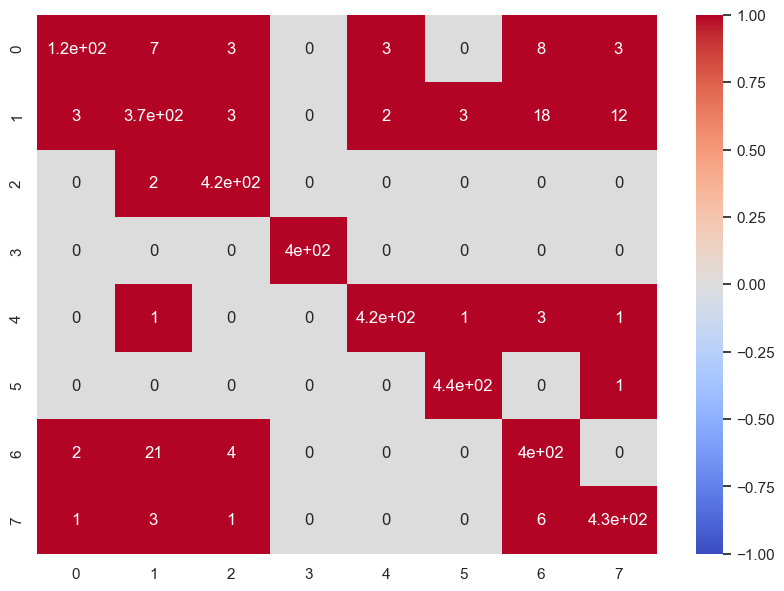

In [484]:
#testing prediction
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [485]:
y_pred = ovr.predict(X_test)
y_proba = ovr.predict_proba(X_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

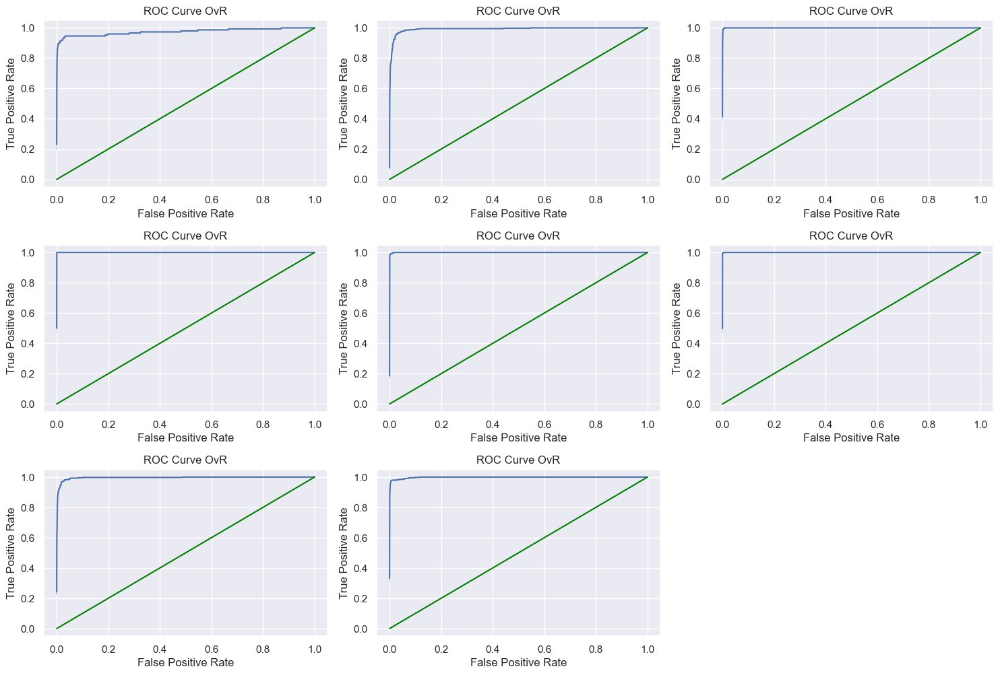

In [486]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [487]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9746
1 ROC AUC OvR: 0.9926
2 ROC AUC OvR: 0.9998
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9997
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 0.9960
7 ROC AUC OvR: 0.9983
average ROC AUC OvR: 0.9951


In [488]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.95      0.84      0.89       149
           1       0.92      0.90      0.91       414
           2       0.97      1.00      0.98       418
           3       1.00      1.00      1.00       404
           4       0.99      0.99      0.99       421
           5       0.99      1.00      0.99       444
           6       0.92      0.94      0.93       428
           7       0.96      0.98      0.97       441

    accuracy                           0.96      3119
   macro avg       0.96      0.95      0.96      3119
weighted avg       0.96      0.96      0.96      3119



In [490]:
f=feat_imp[feat_imp==0]

X_train_sen=X_train_sen.drop(f.index,axis=1)
X_train_sen

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,ASP_S_n,TRENT_S_n,FIBR_PREDS,PREDS_TAH,FIBR_JELUD,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN
0,0.406250,1.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.0,0.285714,0.000000,...,1.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.656250,0.0,0.000000,0.000000,0.000000,1.000000,0.666667,0.0,0.428571,0.250000,...,1.000000,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.531250,1.0,0.000000,0.000000,0.000000,1.000000,1.000000,0.0,1.000000,0.000000,...,1.000000,1.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.593750,1.0,0.000000,0.166667,0.500000,0.500000,0.000000,0.0,0.000000,0.000000,...,1.000000,0.000000,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.453125,1.0,0.333333,0.166667,0.500000,1.000000,0.666667,0.0,0.142857,0.000000,...,1.000000,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10391,0.516464,1.0,0.513418,0.675612,0.378354,0.756709,0.504473,0.0,0.297316,0.513418,...,1.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10392,0.503629,1.0,1.000000,1.000000,0.611612,0.723223,0.815482,0.0,1.000000,0.223223,...,1.000000,0.446446,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10393,0.810540,0.0,0.218767,1.000000,0.500000,0.500000,0.666667,0.0,1.000000,0.000000,...,1.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10394,0.597478,0.0,0.000000,0.313450,0.235088,0.470176,0.313450,0.0,0.000000,0.000000,...,0.059649,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [495]:
#train test split for the selected features
x_train, x_test, Y_train, Y_test =train_test_split(X_train_sen,y_train_sen,test_size=0.3)

In [496]:
# define model
model = LogisticRegression()

# define the ovr strategy
ovr = OneVsRestClassifier(model)

# fit model
ovr.fit(x_train, Y_train)

# make predictions
y_pred = ovr.predict(x_test)

In [497]:
accuracy_score(Y_test,y_pred)

0.9224110291760179

In [498]:
accuracy_score(Y_train,(ovr.predict(x_train)))

0.928129723787275

<AxesSubplot:>

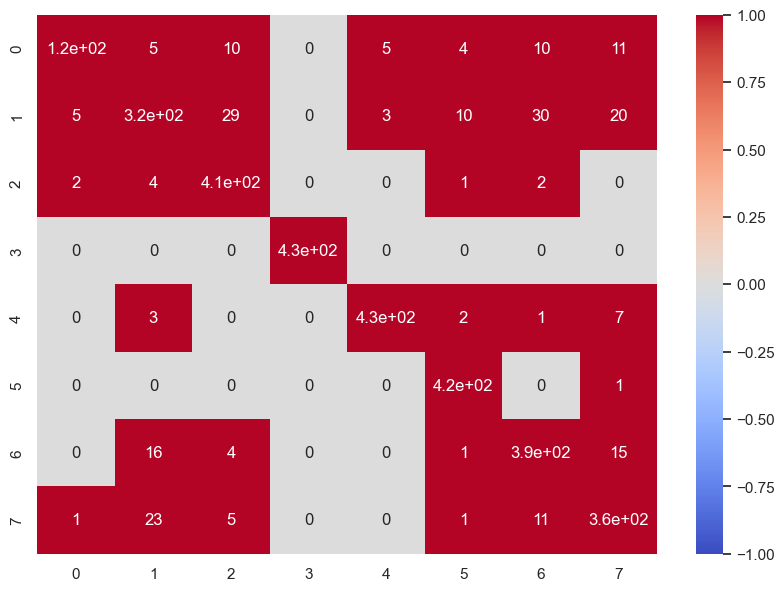

In [499]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')

In [500]:
y_pred = ovr.predict(x_test)
y_proba = ovr.predict_proba(x_test)

classes = ovr.classes_

classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

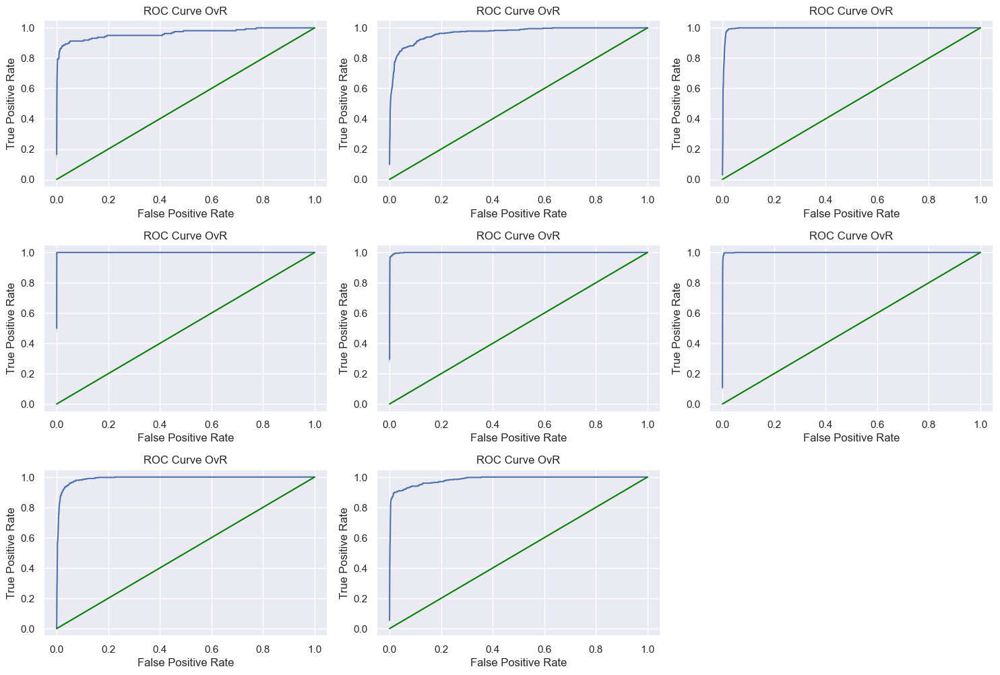

In [501]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [502]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9641
1 ROC AUC OvR: 0.9670
2 ROC AUC OvR: 0.9960
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 0.9992
5 ROC AUC OvR: 0.9994
6 ROC AUC OvR: 0.9903
7 ROC AUC OvR: 0.9839
average ROC AUC OvR: 0.9875


In [503]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.94      0.72      0.81       161
           1       0.86      0.77      0.81       414
           2       0.90      0.98      0.94       421
           3       1.00      1.00      1.00       430
           4       0.98      0.97      0.98       444
           5       0.96      1.00      0.98       424
           6       0.88      0.92      0.90       426
           7       0.87      0.90      0.88       399

    accuracy                           0.92      3119
   macro avg       0.92      0.91      0.91      3119
weighted avg       0.92      0.92      0.92      3119



In [504]:
print("accuracy_score : ", accuracy_score(Y_test, y_pred))
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))

accuracy_score :  0.9224110291760179
precision_score :  0.922331230701108
recall_score :  0.9057397501204105
f1_score :  0.9115765890693679


<AxesSubplot:>

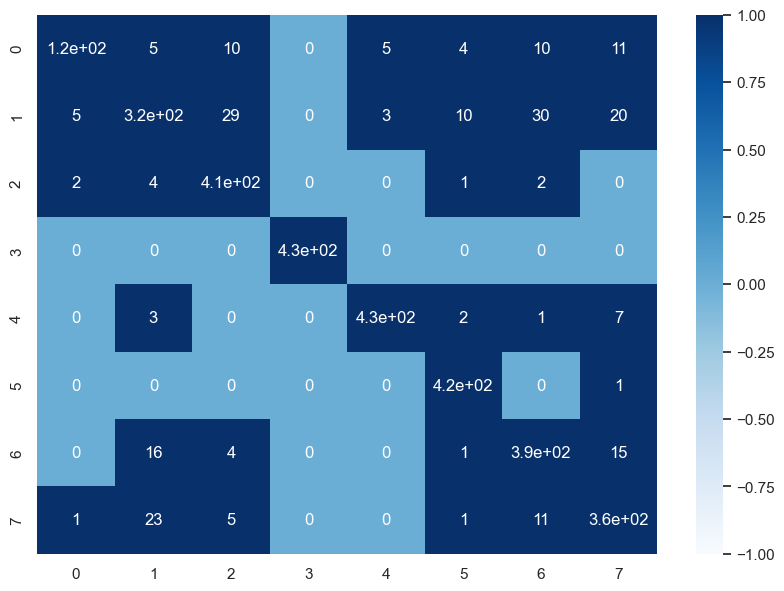

In [505]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

In [506]:
model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(X_train, y_train)

y_pred = model_multiclass.predict(X_test)
y_proba = model_multiclass.predict_proba(X_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [507]:
accuracy_score(y_train,(model_multiclass.predict(X_train)))

1.0

In [508]:
accuracy_score(y_test,y_pred)

0.9958319974350753

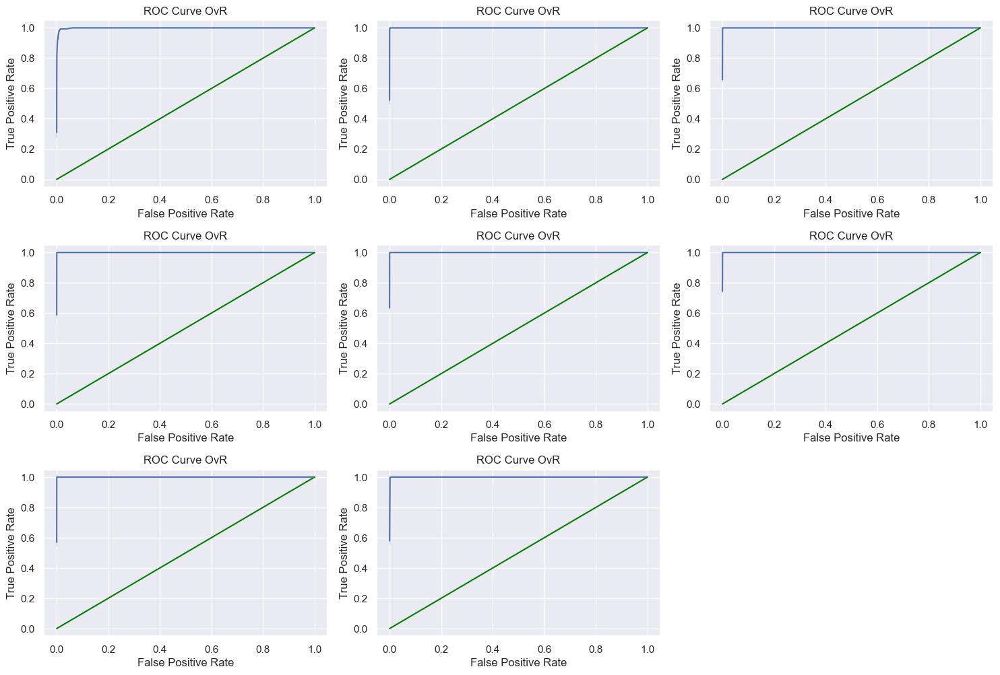

In [509]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = X_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)
    
    
    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [510]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9989
1 ROC AUC OvR: 1.0000
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 1.0000
average ROC AUC OvR: 0.9999


In [511]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

           0       0.96      0.95      0.96       149
           1       0.99      1.00      1.00       414
           2       1.00      1.00      1.00       418
           3       1.00      1.00      1.00       404
           4       1.00      1.00      1.00       421
           5       1.00      1.00      1.00       444
           6       1.00      1.00      1.00       428
           7       1.00      0.99      1.00       441

    accuracy                           1.00      3119
   macro avg       0.99      0.99      0.99      3119
weighted avg       1.00      1.00      1.00      3119



<AxesSubplot:>

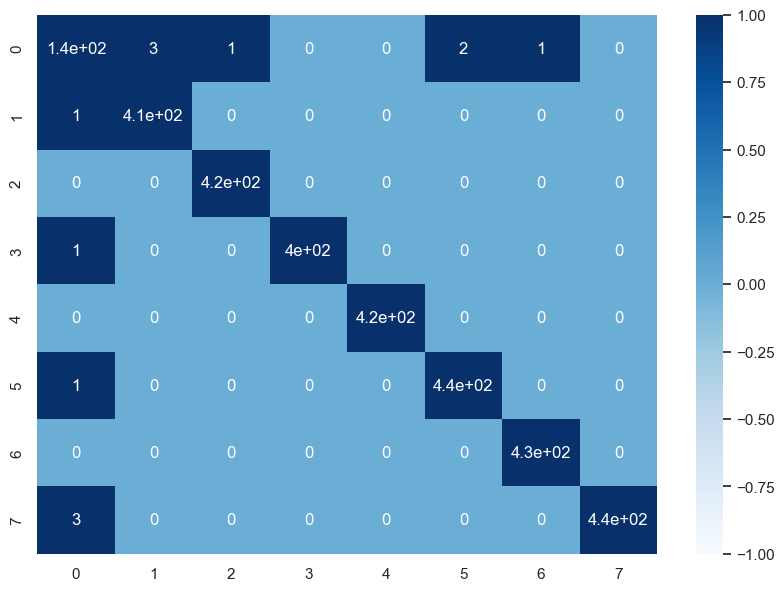

In [512]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap=plt.cm.Blues)

In [513]:
print("accuracy_score : ", accuracy_score(y_test, y_pred))
print("precision_score : ", precision_score(y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(y_test, y_pred,average='macro'))

accuracy_score :  0.9958319974350753
precision_score :  0.9928794877249472
recall_score :  0.9923843068031937
f1_score :  0.9926276712515976


In [514]:
#building model using the selected features

model_multiclass = RandomForestClassifier(n_estimators = 50, criterion = 'gini')
model_multiclass.fit(x_train, Y_train)

y_pred = model_multiclass.predict(x_test)
y_proba = model_multiclass.predict_proba(x_test)

classes = model_multiclass.classes_
classes

array([0, 1, 2, 3, 4, 5, 6, 7], dtype=int64)

In [515]:
accuracy_score(Y_train,(model_multiclass.predict(x_train)))

1.0

In [516]:
accuracy_score(Y_test,y_pred)

0.9951907662712408

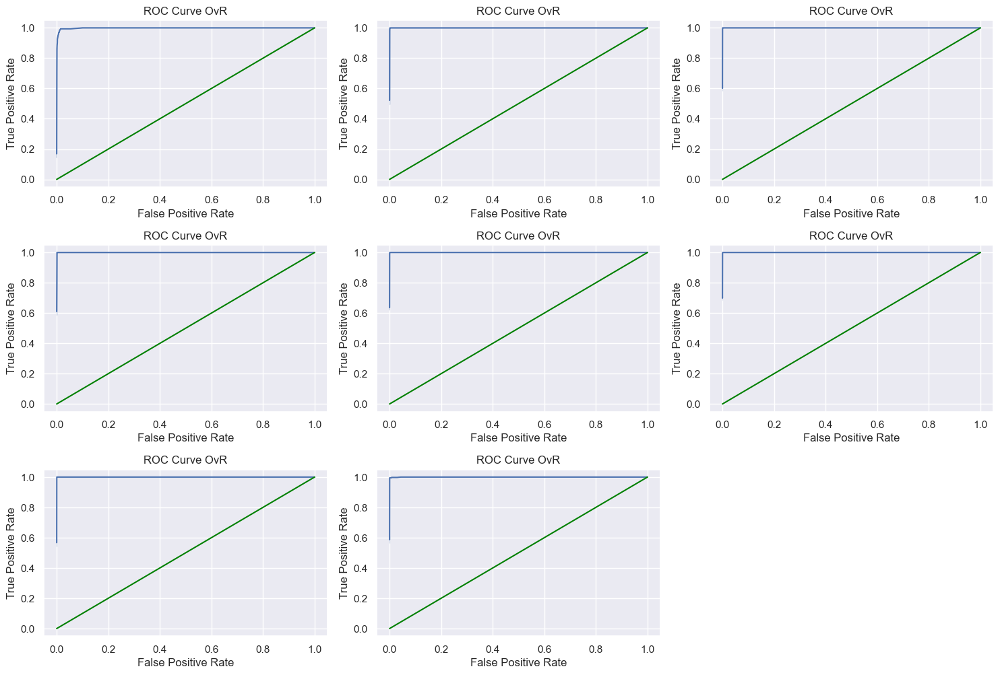

In [517]:
# Plots the Probability Distributions and the ROC Curves One vs Rest
from sklearn.metrics import roc_auc_score
plt.figure(figsize = (15, 20))
bins = [i/20 for i in range(20)] + [1]
roc_auc_ovr = {}

for i in range(len(classes)):
    # Gets the class
    c = classes[i]
    
    # Prepares an auxiliar dataframe to help with the plots
    df_aux = x_test.copy()
    df_aux['class'] = [1 if y == c else 0 for y in Y_test]
    df_aux['prob'] = y_proba[:, i]
    df_aux = df_aux.reset_index(drop = True)

    # Calculates the ROC Coordinates and plots the ROC Curves
    ax_bottom = plt.subplot(6, 3, i+10)
    tpr, fpr = get_all_roc_coordinates(df_aux['class'], df_aux['prob'])
    plot_roc_curve(tpr, fpr, scatter = False, ax = ax_bottom)
    ax_bottom.set_title("ROC Curve OvR")
    
    # Calculates the ROC AUC OvR
    roc_auc_ovr[c] = roc_auc_score(df_aux['class'], df_aux['prob'])
    
plt.tight_layout()

In [518]:
# Displays the ROC AUC for each class
avg_roc_auc = 0
i = 0
for k in roc_auc_ovr:
    avg_roc_auc += roc_auc_ovr[k]
    i += 1
    print(f"{k} ROC AUC OvR: {roc_auc_ovr[k]:.4f}")
print(f"average ROC AUC OvR: {avg_roc_auc/i:.4f}")

0 ROC AUC OvR: 0.9986
1 ROC AUC OvR: 1.0000
2 ROC AUC OvR: 1.0000
3 ROC AUC OvR: 1.0000
4 ROC AUC OvR: 1.0000
5 ROC AUC OvR: 1.0000
6 ROC AUC OvR: 1.0000
7 ROC AUC OvR: 0.9999
average ROC AUC OvR: 0.9998


In [519]:
print(classification_report(Y_test,y_pred))

              precision    recall  f1-score   support

           0       0.97      0.94      0.96       161
           1       1.00      0.99      0.99       414
           2       1.00      1.00      1.00       421
           3       1.00      1.00      1.00       430
           4       1.00      1.00      1.00       444
           5       1.00      1.00      1.00       424
           6       1.00      1.00      1.00       426
           7       0.99      0.99      0.99       399

    accuracy                           1.00      3119
   macro avg       0.99      0.99      0.99      3119
weighted avg       1.00      1.00      1.00      3119



In [520]:
print("accuracy_score : ", accuracy_score(Y_test, y_pred))
print("precision_score : ", precision_score(Y_test, y_pred,average='macro'))
print("recall_score : ", recall_score(Y_test, y_pred,average='macro'))
print("f1_score : ", f1_score(Y_test, y_pred,average='macro'))

accuracy_score :  0.9951907662712408
precision_score :  0.992993411354518
recall_score :  0.9911985273112276
f1_score :  0.9920744555964378


<AxesSubplot:>

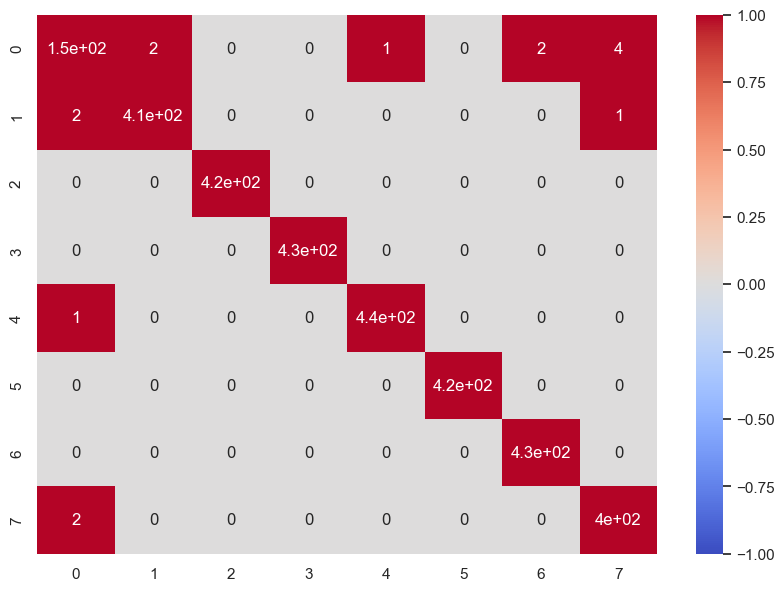

In [521]:
plt.figure(figsize=(10,7))
sns.heatmap(confusion_matrix(Y_test,y_pred),vmin = -1, vmax = +1, annot = True, cmap = 'coolwarm')